# **Project - Netflix Movies and TV Shows Clustering**    



##### **Project Type**    - Unsupervised- Clustering
##### **Contribution**    - Individual
##### **A Project By**    - Vani Bhatt


# **Project Summary -**

Write the summary here within 500-600 words.


This project aims to cluster Netflix movies and TV shows based on their genres, release dates, and ratings.
 The goal is to identify patterns and similarities between different movies and TV shows, and to provide recommendations to users based on their preferences.

The project will be completed in two phases:

* 1: Data collection and preprocessing. In this phase, the data will be collected from the Netflix API and preprocessed to remove duplicate entries and missing values.
* 2: Clustering and recommendation. In this phase, the data will be clustered using a variety of clustering algorithms,
such as k-means clustering and hierarchical - Angglomerative clustering.
The clusters will then be used to make recommendations to users based on their preferences.

# **GitHub Link -**

Provide your GitHub Link here.

https://github.com/vani4vani/Netflix_Movies_and_TV_Shows_Clustering_capstone_project.git

git@github.com:vani4vani/Netflix_Movies_and_TV_Shows_Clustering_capstone_project.git

# **Problem Statement**


**Write Problem Statement Here.**


This dataset consists of tv shows and movies available on Netflix as of 2019. The dataset is collected from Flixable which is a third-party Netflix search engine.

In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

Integrating this dataset with other external datasets such as IMDB ratings, rotten tomatoes can also provide many interesting findings.



## <b>In this  project, you are required to do </b>
1. Exploratory Data Analysis

2. Understanding what type content is available in different countries

3. Is Netflix has increasingly focusing on TV rather than movies in recent years.
4. Clustering similar content by matching text-based features

# **Attribute Information**

1. show_id : Unique ID for every Movie / Tv Show

2. type : Identifier - A Movie or TV Show

3. title : Title of the Movie / Tv Show

4. director : Director of the Movie / TV Show

5. cast : Actors involved in the movie / show

6. country : Country where the movie / show was produced

7. date_added : Date it was added on Netflix

8. release_year : Actual Release year of the movie / show

9. rating : TV Rating of the movie / show

10. duration : Total Duration - in minutes or number of seasons

11. listed_in : Genere

12. description: The Summary description

# **General Guidelines** : -  

1.   Well-structured, formatted, and commented code is required.
2.   Exception Handling, Production Grade Code & Deployment Ready Code will be a plus. Those students will be awarded some additional credits.
     
     The additional credits will have advantages over other students during Star Student selection.
       
             [ Note: - Deployment Ready Code is defined as, the whole .ipynb notebook should be executable in one go
                       without a single error logged. ]

3.   Each and every logic should have proper comments.
4. You may add as many number of charts you want. Make Sure for each and every chart the following format should be answered.
        

```
# Chart visualization code
```
            

*   Why did you pick the specific chart?
*   What is/are the insight(s) found from the chart?
* Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

5. You have to create at least 15 logical & meaningful charts having important insights.


[ Hints : - Do the Vizualization in  a structured way while following "UBM" Rule.

U - Univariate Analysis,

B - Bivariate Analysis (Numerical - Categorical, Numerical - Numerical, Categorical - Categorical)

M - Multivariate Analysis
 ]





6. You may add more ml algorithms for model creation. Make sure for each and every algorithm, the following format should be answered.


*   Explain the ML Model used and it's performance using Evaluation metric Score Chart.


*   Cross- Validation & Hyperparameter Tuning

*   Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

*   Explain each evaluation metric's indication towards business and the business impact pf the ML model used.




















# Workflow



These are the steps that we’ll be performing in this project:

- Understanding the dataset and problem statement.
- Handling null values and data wrangling.
- In-depth exploratory data analysis.
- Hypothesis Testing
- Textual data preprocessing.
- Text Vectorization using TF-TDF.
- Dimensionality reduction (if required)
- Clustering analysis.
- Checking out distribution of different cluster with the help of word cloud.
- Building a recommender system using cosine similarity.
- Conclusion



# ***Let's Begin !***

In [ ]:
# Mounting the drive

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## ***1. Know Your Data***

### Import Libraries

In [ ]:
# Import Libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import matplotlib.cm as cm
from wordcloud import WordCloud, STOPWORDS
%matplotlib inline

#for nlp / text processing
from sklearn import preprocessing
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, KFold
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

# for clustring
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples
import scipy.cluster.hierarchy as sch

# scipy library for hypothesis testing
import scipy

# plotly library
import plotly.offline as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.express as px

# for warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Installing scipy library

!pip install scipy

In [ ]:
# Installing natural language toolkit

!pip install nltk

In [ ]:
# importing nltk library

import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

### Dataset Loading

In [ ]:
# Load Dataset

df = pd.read_csv('/content/drive/MyDrive/AlmaBetter_assignments/Capstone Project - Netflix Movies and TV Shows Clustering/NETFLIX MOVIES AND TV SHOWS CLUSTERING.csv')

### Dataset First View

In [ ]:
# Dataset First Look

In [ ]:
# Head of data

df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...


In [ ]:
# Tail of data

df.tail()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
7782,s7783,Movie,Zozo,Josef Fares,"Imad Creidi, Antoinette Turk, Elias Gergi, Car...","Sweden, Czech Republic, United Kingdom, Denmar...","October 19, 2020",2005,TV-MA,99 min,"Dramas, International Movies",When Lebanon's Civil War deprives Zozo of his ...
7783,s7784,Movie,Zubaan,Mozez Singh,"Vicky Kaushal, Sarah-Jane Dias, Raaghav Chanan...",India,"March 2, 2019",2015,TV-14,111 min,"Dramas, International Movies, Music & Musicals",A scrappy but poor boy worms his way into a ty...
7784,s7785,Movie,Zulu Man in Japan,NaN,Nasty C,NaN,"September 25, 2020",2019,TV-MA,44 min,"Documentaries, International Movies, Music & M...","In this documentary, South African rapper Nast..."
7785,s7786,TV Show,Zumbo's Just Desserts,NaN,"Adriano Zumbo, Rachel Khoo",Australia,"October 31, 2020",2019,TV-PG,1 Season,"International TV Shows, Reality TV",Dessert wizard Adriano Zumbo looks for the nex...
7786,s7787,Movie,ZZ TOP: THAT LITTLE OL' BAND FROM TEXAS,Sam Dunn,NaN,"United Kingdom, Canada, United States","March 1, 2020",2019,TV-MA,90 min,"Documentaries, Music & Musicals",This documentary delves into the mystique behi...


### Dataset Rows & Columns count

In [ ]:
# Dataset Rows & Columns count

df.shape

(7787, 12)

### Dataset Information

In [ ]:
# Dataset Info

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


#### Duplicate Values

In [ ]:
# Dataset Duplicate Value Count

df.duplicated().sum()

0

There's no duplicate values present in the dataset.

#### Missing Values/Null Values

In [ ]:
# Missing Values/Null Values Count

df.isnull().sum().sort_values(ascending=False)

director        2389
cast             718
country          507
date_added        10
rating             7
show_id            0
type               0
title              0
release_year       0
duration           0
listed_in          0
description        0
dtype: int64

The dataset has a significant number of missing values, with the most notable being 2389 missing values in the 'director' column, 718 in 'cast', 507 in 'country', 10 in 'date_added', and 7 in rating.

### Heatmap to visualize the missing values

In [ ]:
# Visualizing the missing values

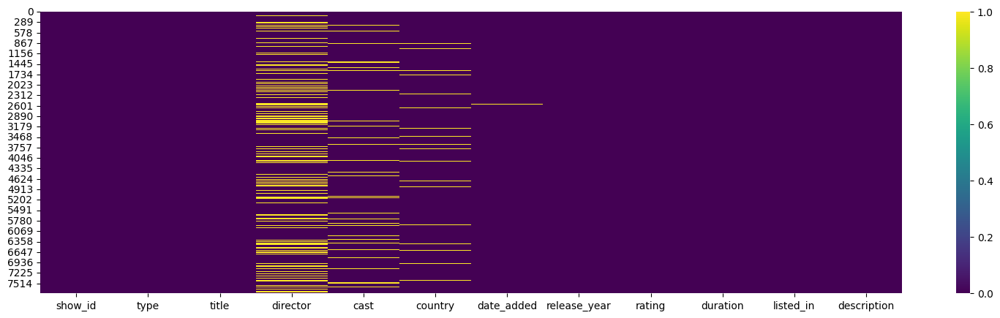

In [ ]:
# Percentage of missing values in each column
(df.isnull().sum() / len(df)) * 100

# Create a heatmap to visualize the missing values
plt.figure(figsize=(19, 5))
sns.heatmap(df.isnull(), cmap='viridis')
plt.show()


### Null value distribution

<Axes: >

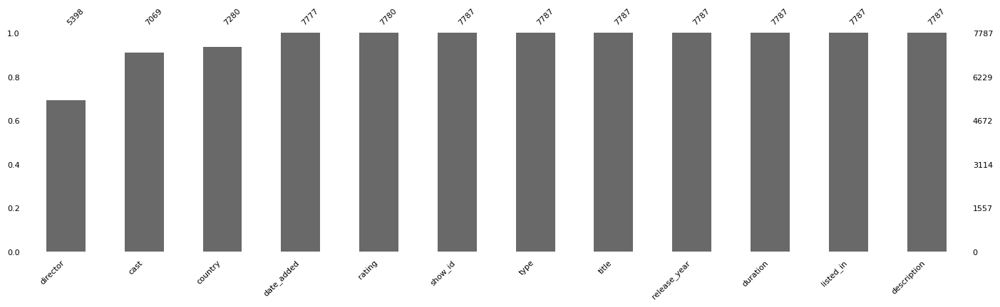

In [ ]:
# null value distribution

msno.bar(df, log=False, sort='ascending', figsize=(17,4), fontsize=8)

### What did you know about your dataset?

Answer Here

Dataset analysis so far and about it's info

- The dataset contains information about movies and TV shows available on Netflix as of 2019. It consists of 7787 rows and 12 columns.

- The dataset has a significant number of missing values, with the most notable being 2389 missing values in the 'director' column, 718 in 'cast', 507 in 'country', 10 in 'date_added', and 7 in rating.

- The missing values are spread across multiple columns, indicating that there is no single source of missing data.

- This missing data could be due to a variety of factors, such as errors in data collection or entry, or incomplete information available at the time of data collection.

- Missing values can have a significant impact on the analysis and interpretation of the data, as they can lead to biased or inaccurate results.

- To address the missing values, it is important to understand the reason behind the missingness and to take appropriate steps to impute or remove the missing values.

In this project, we will explore various techniques for dealing with missing values, such as imputation and data cleaning, to ensure that the analysis and interpretation of the data is accurate and reliable.


## ***2. Understanding Your Variables***

In [ ]:
# Dataset columns

df.columns

Index(['show_id', 'type', 'title', 'director', 'cast', 'country', 'date_added',
       'release_year', 'rating', 'duration', 'listed_in', 'description'],
      dtype='object')

In [ ]:
# Dataset Describe

df.describe(include = 'all')

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
count,7787,7787,7787,5398,7069,7280,7777,7787.000000,7780,7787,7787,7787
unique,7787,2,7787,4049,6831,681,1565,NaN,14,216,492,7769
top,s1,Movie,3%,"Raúl Campos, Jan Suter",David Attenborough,United States,"January 1, 2020",NaN,TV-MA,1 Season,Documentaries,Multiple women report their husbands as missin...
freq,1,5377,1,18,18,2555,118,NaN,2863,1608,334,3
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.932580,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.757395,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1925.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018.000000,NaN,NaN,NaN,NaN


From the above description we can say that our dataset has 1 numerical type that is column 'release_year' and rest all are strings, so description of the dataset is not useful in this case.

In [ ]:
# release_year column Describe

df.describe()

,release_year
count,7787.000000
mean,2013.932580
std,8.757395
min,1925.000000
25%,2013.000000
50%,2017.000000
75%,2018.000000
max,2021.000000


### Variables Description

Answer Here


| Variable Name | Description |
|---|---|
| title | Title of the movie or TV show. |
| director | Director of the movie or TV show. |
| cast | List of actors and actresses who starred in the movie or TV show. |
| country | Country where the movie or TV show was produced. |
| date_added | Date on which the movie or TV show was added to Netflix. |
| release_year | Year in which the movie or TV show was released. |
| rating | Rating of the movie or TV show on Netflix. |
| duration | Duration of the movie or TV show in minutes. |
| listed_in | List of genres to which the movie or TV show belongs. |
| description | Description of the movie or TV show. |


### Check Unique Values for each variable.

In [ ]:
# Check Unique Values for each variable.

df.nunique()

show_id         7787
type               2
title           7787
director        4049
cast            6831
country          681
date_added      1565
release_year      73
rating            14
duration         216
listed_in        492
description     7769
dtype: int64

## Check Unique Values for each variable.

In [ ]:
# Unique values of variable and it's count

df['show_id'].value_counts().to_frame()

,show_id
s1,1
s5172,1
s5200,1
s5199,1
s5198,1
...,...
s2592,1
s2591,1
s2590,1
s2589,1


The output shows that there are 7787 unique show_ids in the dataset. This means that there are 7787 different movies or TV shows in the dataset.

In [ ]:
# Unique values of variable and it's count

df['type'].value_counts().to_frame()

,type
Movie,5377
TV Show,2410


 Output shows that there are 5377 movies and 2410 TV shows in the dataset.

In [ ]:
# Unique values of variable and it's count

df['title'].value_counts().to_frame()

,title
3%,1
Results,1
Rich in Love,1
Ricardo Quevedo: Los amargados somos más,1
Ricardo Quevedo: Hay gente así,1
...,...
Hamza's Suitcase,1
Hamid,1
Hamburger Hill,1
Hamara Dil Aapke Paas Hai,1



The output shows that there are 7787 unique titles in the dataset. This means that there are total 7787 different movies or TV shows in the dataset.

In [ ]:
# Unique values of variable and it's count

df['director'].value_counts().to_frame()

,director
"Raúl Campos, Jan Suter",18
Marcus Raboy,16
Jay Karas,14
Cathy Garcia-Molina,13
Youssef Chahine,12
...,...
Vibhu Virender Puri,1
Lucien Jean-Baptiste,1
Jason Krawczyk,1
Quinn Lasher,1



- The output shows that there are 4049 unique director names in the 'director' column.
- Earlier we have seen that there are 2389 missing values in the 'director' column.
- This is a significant number of missing values, and it could have a significant impact on the analysis and interpretation of the data.
- To address this issue, we will need to take steps to either impute the missing values or remove the rows from the dataset.

In [ ]:
# Unique values of variable and it's count

df['cast'].value_counts().to_frame()

,cast
David Attenborough,18
Samuel West,10
Jeff Dunham,7
Kevin Hart,6
"Michela Luci, Jamie Watson, Eric Peterson, Anna Claire Bartlam, Nicolas Aqui, Cory Doran, Julie Lemieux, Derek McGrath",6
...,...
"Hee-Jin Lee, Hae-seong Kwon, Paul Stafford, Mi-ji Lee, Ik-tae Kim, Ki-hyeon Kim",1
"Tammy Chen, Kingone Wang, Hsieh Kun Da, Chuang Kai-Hsun, Jenna Wang",1
"James Purefoy, Michael Kenneth Williams, Jimmi Simpson, Bill Sage, Christina Hendricks, Pollyanna McIntosh, Jeff Pope, Neil Sandilands, Henry G. Sanders, Enrique Murciano",1
"Awie, Arab Khalid, Sharwani Ns, Tj Isa, Delimawati, Zul Ariffin, Uqasha Senrose, Ropie Cecupak",1


In [ ]:
#unique cast names in the list of 'cast' column and their count

df['cast'].str.split(',').explode().value_counts().to_frame()


,cast
Anupam Kher,38
Takahiro Sakurai,28
Om Puri,27
Shah Rukh Khan,27
Boman Irani,25
...,...
Juan Manuel Diaz,1
Ana Wills,1
Mauricio Figueroa,1
Matias Maldonado,1


- The output shows that there are 6931 unique list of cast names in the 'cast' column.
- The output shows that there are 35372 unique cast names in the 'cast' column.
- Earlier we have seen that there are 718 missing values in the 'cast' column.
- This is a significant number of missing values, and it could have a significant impact on the analysis and interpretation of the data.
- To address this issue, we will need to take steps to either impute the missing values or remove the rows from the dataset.

In [ ]:
# Unique values of variable and it's count

df['country'].value_counts().to_frame()

,country
United States,2555
India,923
United Kingdom,397
Japan,226
South Korea,183
...,...
"Russia, United States, China",1
"Italy, Switzerland, France, Germany",1
"United States, United Kingdom, Canada",1
"United States, United Kingdom, Japan",1


In [ ]:
# prompt:  df['country'].str.split(',').explode().value_counts().to_frame() and remove duplicates

df['country'].str.split(',').explode().value_counts().to_frame().drop_duplicates()


,country
United States,2883
India,956
United Kingdom,577
United States,414
Canada,259
Japan,237
France,196
South Korea,194
Spain,168
France,153


In [ ]:
# unique country names in the list of 'country' column and their count

ncountry = df['country'].str.split(',').explode().value_counts().to_frame().drop_duplicates(subset=['country'])

In [ ]:
# prompt: ncountry unique values counts

ncountry.nunique()


country    58
dtype: int64

- The output shows that there are 681 unique list of country names in the 'country' column.
- The output shows that there are 46 unique countries in the dataset.
- Earlier we have seen that there are 507 missing values in the 'country' column.
- This is a significant number of missing values, and it could have a significant impact on the analysis and interpretation of the data.
- To address this issue, we will need to take steps to either impute the missing values or remove the rows from the dataset.

In [ ]:
# Unique values of variable and it's count

df['date_added'].value_counts().to_frame()

,date_added
"January 1, 2020",118
"November 1, 2019",94
"December 31, 2019",76
"March 1, 2018",76
"October 1, 2018",72
...,...
"October 12, 2014",1
"March 22, 2020",1
"March 31, 2013",1
"December 12, 2019",1



- The output shows that there are 1565 unique dates in the 'date_added' column.
- The output shows that the most common date is 'January 1, 2020', with 118 movies or TV shows added on that date.
- Earlier we have seen that there are 10 missing values in the 'date_added' column.
- This is a relatively small number of missing values compared to the other columns,
 and it is likely that these missing values can be imputed or removed without significantly impacting the analysis and interpretation of the data.

In [ ]:
# Unique values of variable and it's count

df['release_year'].value_counts().to_frame()

,release_year
2018,1121
2017,1012
2019,996
2016,882
2020,868
...,...
1925,1
1964,1
1966,1
1947,1


In [ ]:
# df['release_year'] range

df['release_year'].min(), df['release_year'].max()


(1925, 2021)


- The output shows that there are 73 unique release years in the 'release_year' column.
- The most common release year is 2021, with 1121 movies or TV shows released in that year.
- The earliest release year is 1925, and the latest release year is 2020.
- The release year distribution is important to consider when analyzing the data, as it can help to identify trends and patterns in the data.
- For example, we can compare the release year distribution of movies and TV shows to see if there are any differences.
- We can also compare the release year distribution of movies and TV shows from different countries to see if there are any regional differences.

In [ ]:
# Unique values of variable and it's count

df['rating'].value_counts().to_frame()

,rating
TV-MA,2863
TV-14,1931
TV-PG,806
R,665
PG-13,386
TV-Y,280
TV-Y7,271
PG,247
TV-G,194
NR,84



- The output shows that there are 14 unique ratings in the 'rating' column.
- The most common rating is 'TV-MA', with 2863 movies or TV shows receiving this rating.
- The least common rating is 'NC-17', with only 3 movies or TV shows receiving this rating.
- The rating distribution is important to consider when analyzing the data, as it can help to identify trends and patterns in the data.

In [ ]:
# Unique values of variable and it's count

df['duration'].value_counts().to_frame()

,duration
1 Season,1608
2 Seasons,382
3 Seasons,184
90 min,136
93 min,131
...,...
182 min,1
224 min,1
233 min,1
196 min,1


- The output shows that there are 216 unique durations in the 'duration' column.
- The most common duration is 90 minutes, with 136 movies or TV shows having this duration which doesn't have seasons.
- The duration distribution is important to consider when analyzing the data, as it can help to identify trends and patterns in the data.

In [ ]:
# Unique values of variable and it's count

df['listed_in'].value_counts().to_frame()

,listed_in
Documentaries,334
Stand-Up Comedy,321
"Dramas, International Movies",320
"Comedies, Dramas, International Movies",243
"Dramas, Independent Movies, International Movies",215
...,...
"Crime TV Shows, Romantic TV Shows, Spanish-Language TV Shows",1
"Crime TV Shows, International TV Shows, Reality TV",1
"International Movies, Romantic Movies, Sci-Fi & Fantasy",1
"Stand-Up Comedy & Talk Shows, TV Mysteries, TV Sci-Fi & Fantasy",1


- The 'listed_in' column has 491 unique categories list , and the most common category is 'Documentries'.

In [ ]:
# Unique values of variable and it's count

df['description'].value_counts().to_frame()

,description
"Multiple women report their husbands as missing but when it appears they are looking for the same man, a police officer traces their cryptic connection.",3
A surly septuagenarian gets another chance at her 20s after having her photo snapped at a studio that magically takes 50 years off her life.,3
"When Elastigirl gets recruited for a high-profile crime-fighting mission, Mr. Incredible takes on his toughest assignment ever: full-time parenting.",2
"A young Han Solo tries to settle an old score with the help of his new buddy Chewbacca, a crew of space smugglers and a cunning old friend.",2
"When pretty new neighbor Seema falls for their shy roommate Sid, jealous womanizers Omi and Jai plot to break up the new lovebirds.",2
...,...
Researchers add context and clarity to UFO mysteries and conspiracy theories as they unpack clues in a trove of files covering decades of sightings.,1
Homicide detective Gene Handsome sets out to solve a woman's murder while searching for clues about what's missing from his personal life.,1
"Clashing martial arts twins face relentless villains, thorny romance and brotherly rivalry as their troubled pasts catch up to them.",1
"A self-described outsider is sent to a rugby-obsessed boarding school, where he forms an unexpected bond with the star player.",1


- The output shows that there are 7769 unique descriptions in the 'description' column.
- This is a very large number of unique descriptions, and it suggests that there is a lot of variability in the descriptions of the movies and TV shows in the dataset.
- This could make it difficult to identify trends and patterns in the data, and it could also make it difficult to compare the descriptions of different movies and TV shows.
- To address this issue, we could try to reduce the number of unique descriptions in the dataset by removing duplicate descriptions or by grouping similar descriptions together.
- We could also try to use a technique called natural language processing (NLP) to extract more information from the descriptions,
such as the genre of the movie or TV show, the main characters, or the plot.

### Changing the dtype

In [ ]:
# Converting the 'date_added' column to a datetime object

df['date_added'] = pd.to_datetime(df['date_added'])

In [ ]:
# Converting the 'release_year' column to a numeric value

df['release_year'] = df['release_year'].astype(int)

In [ ]:
# Looking for which category have maximum nulls in director column

y=df[df['director'].isna()]
x=y['type'].astype('category')

### Number of missing values for directors column by category

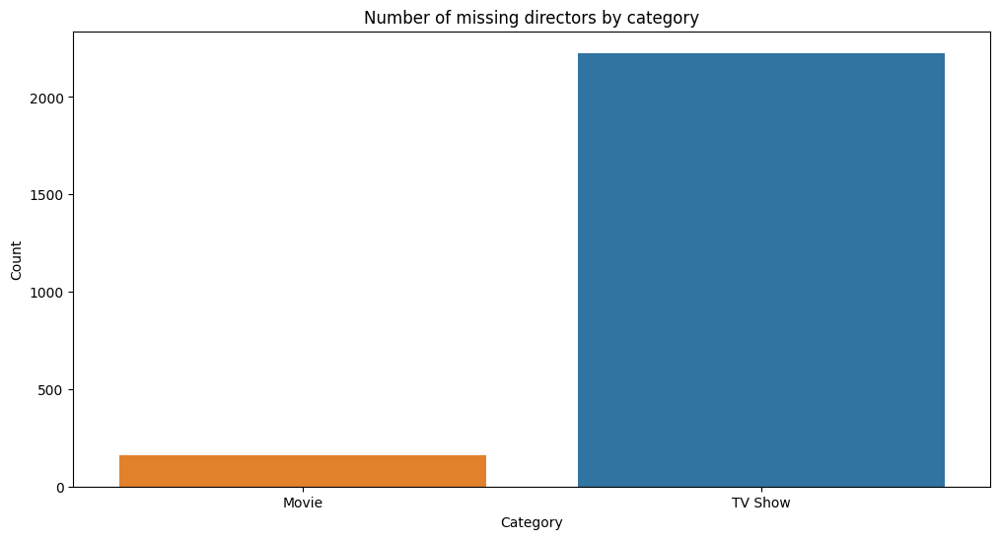

In [ ]:
# plot x and y

plt.figure(figsize=(12,6))
sns.countplot(x=x, hue=y['type'])
plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Number of missing directors by category')
plt.show()


- The director column has a large number of unique values, indicating that there are many different directors represented in the dataset.

- There are also a significant number of missing values in the director column,
which suggests that some movies and TV shows do not have their director listed.

- The missing values are not evenly distributed across the different categories of content.
TV shows have a much higher proportion of missing director values than movies.

- This could be due to a number of factors, such as the fact that TV shows often have multiple directors, while movies typically have only one.
It could also be due to the fact that TV shows are often produced by different production companies,
while movies are often produced by a single studio.

- The insights gained from this chart can be used to understand the distribution of directors in the dataset
and to identify areas where there may be missing data. This information can be useful for researchers
and analysts who are working with the dataset.

### What all manipulations have you done and insights you found?

Answer Here.


- After performing these manipulations, the dataset is now ready for analysis. We have no duplicate rows, but there are some rows with missing values, and converted the relevant columns to numeric or datetime format data types. This will allow us to perform more sophisticated analyses and gain deeper insights into the data.

## 3. ***Data Wrangling***

### Data Wrangling Code

In [ ]:
# Write your code to make your dataset analysis ready.

In [ ]:
#  check for nulls

df.isnull().sum()

show_id            0
type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

In [ ]:
# filling the null values of cast column with 'unknown_cast'

df['cast'].fillna('unknown_cast',inplace=True)

In [ ]:
# filling the null values of country column with 'mode'

df['country'].fillna(df['country'].mode()[0], inplace=True)

In [ ]:
# filling the null values of cast column with empty string

df['director'].fillna('',inplace=True)

In [ ]:
# dropping the null values of column 'date_added' and 'rating'

df.dropna(subset=['date_added', 'rating'], inplace=True)

In [ ]:
# checking for null values if there is any left

df.isnull().sum()

show_id         0
type            0
title           0
director        0
cast            0
country         0
date_added      0
release_year    0
rating          0
duration        0
listed_in       0
description     0
dtype: int64


    - The 'cast' column has 718 null values.
    - The 'country' column has 507 null values.
    - The 'director' column has 175 null values.
    - The 'date_added' column has 10 null values.
    - The 'rating' column has 10 null values.

    - We have filled the null values in the 'cast' and 'country' columns with the value 'unknown_cast' and 'mode', respectively.
    - We have filled the null values in the 'director' column with empty string.
    - We have dropped the rows with null values in the 'date_added' and 'rating' columns.

    After these operations, there are no more null values in the dataset.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

# Univariate Analysis before Clustering

#### Chart - 1

# Type Column ( Movie, TV Show )

In [ ]:
# Chart - 1 visualization code

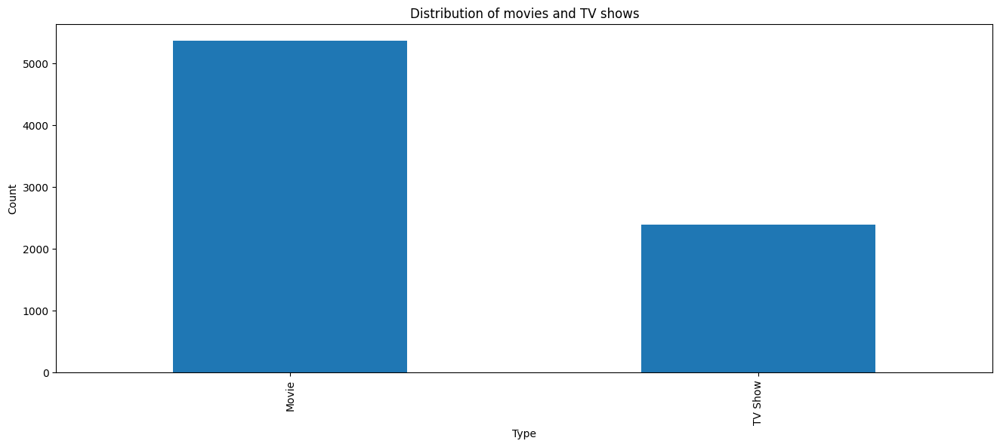

In [ ]:
# type column count values and its visualisation

plt.figure(figsize=(16, 6))
df.groupby('type').size().plot(kind='bar')
plt.xlabel('Type')
plt.ylabel('Count')
plt.title('Distribution of movies and TV shows')
plt.show()

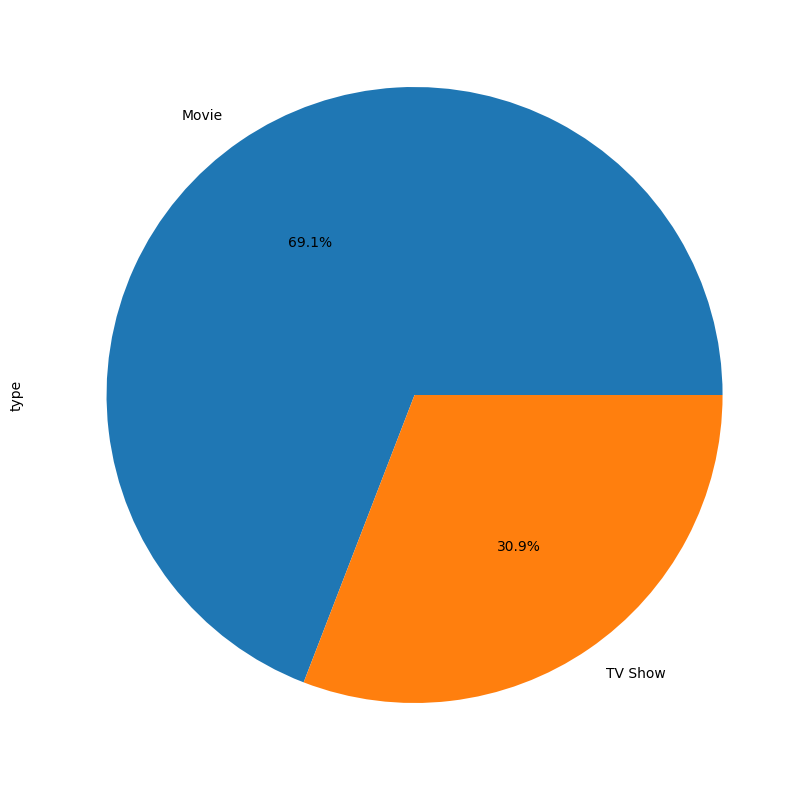

In [ ]:
# visualise using  pie chart with percentages

plt.figure(figsize=(10, 10))
df['type'].value_counts().plot(kind='pie', autopct='%1.1f%%')
plt.show()


 * Why did you pick the specific chart?

  - The bar chart was chosen to visualize the distribution of movies and TV shows in the dataset by type. This type of chart is appropriate for comparing the frequency of different categories.


* What is/are the insight(s) found from the chart?

 - The chart shows that there are a significant number of movies in the dataset (5377), compared to TV shows (2410). This suggests that the dataset is skewed towards movies.


* Will the gained insights help creating a positive business impact?

 - Yes, the insights gained from the chart can help businesses understand the relative popularity of movies and TV shows on Netflix, which can be useful for making programming decisions.


* Are there any insights that lead to negative growth? Justify with specific reason.

 - No, there are no insights that lead to negative growth. In fact, the insights gained from the chart can help businesses make informed decisions about which types of content to produce, which can lead to increased viewership and revenue.


#### Chart - 2

# Word plot for variables 'director', 'description', 'title', 'cast', 'listed_in', 'country'

In [ ]:
# Chart - 2 visualization code

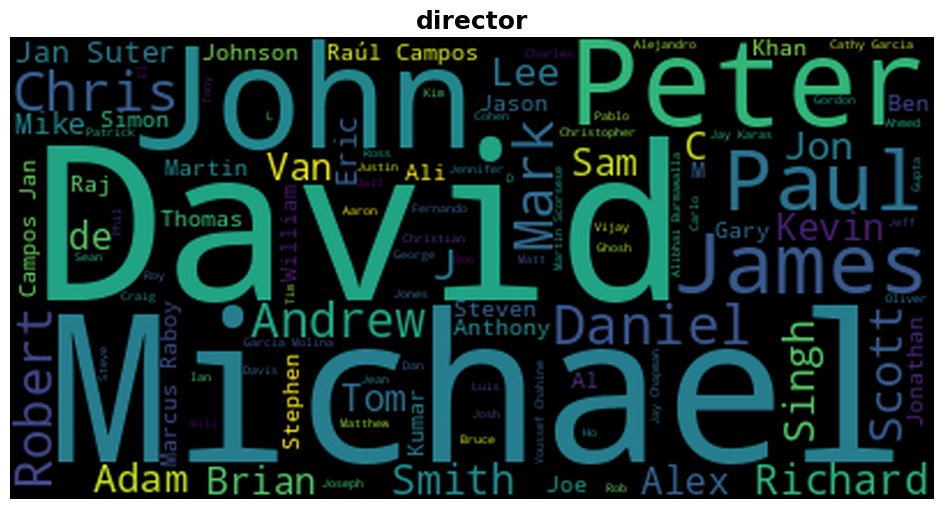

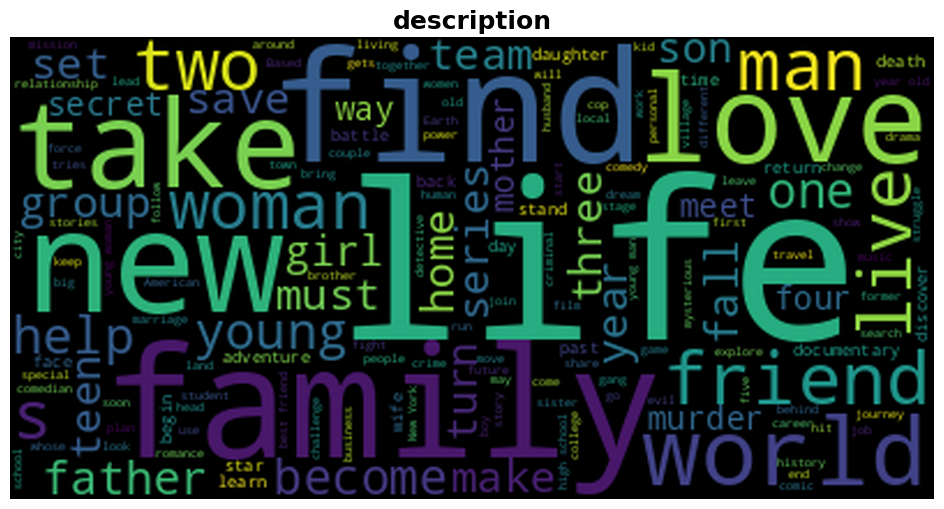

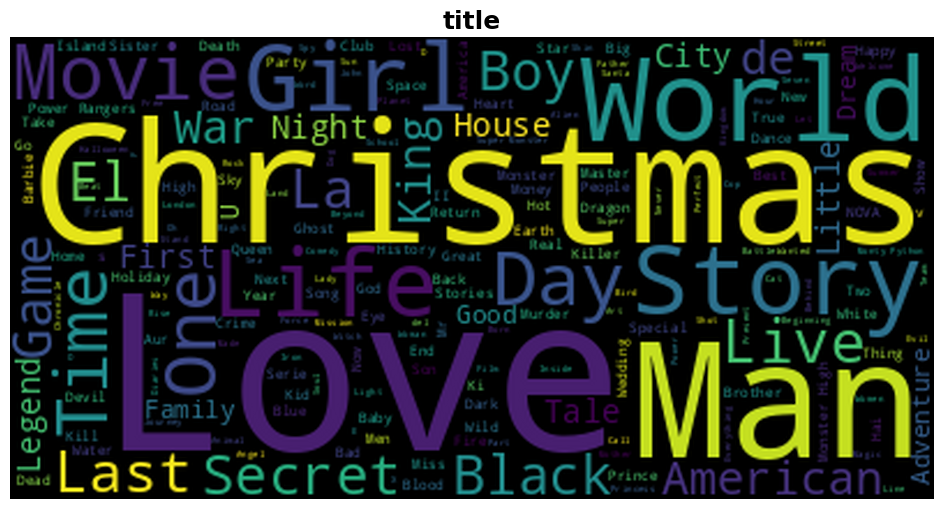

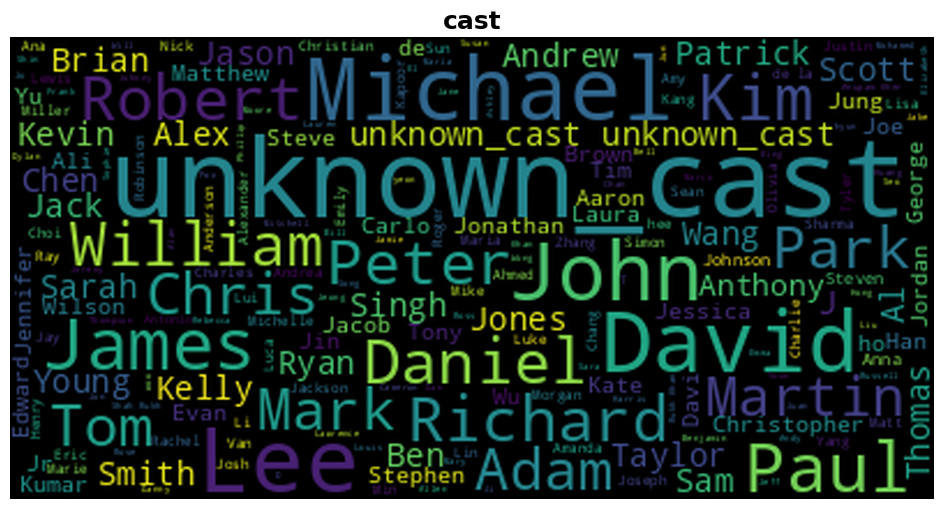

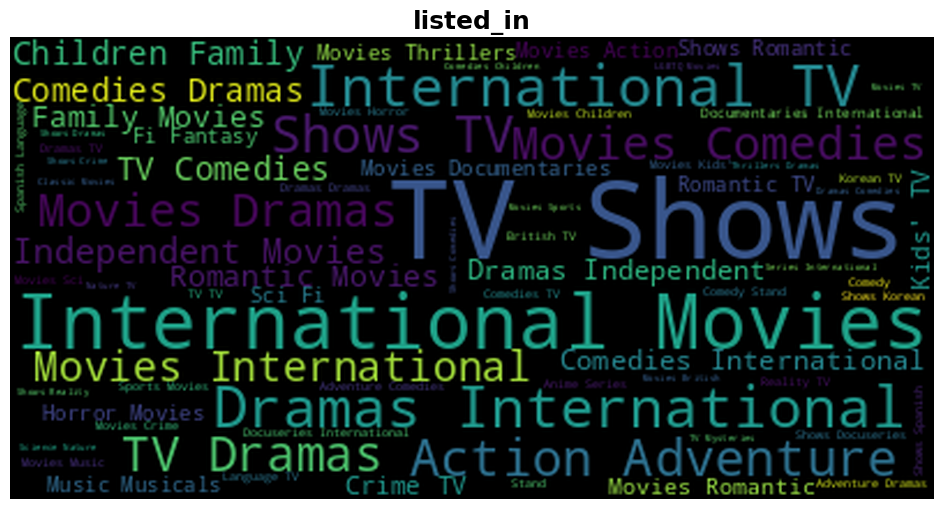

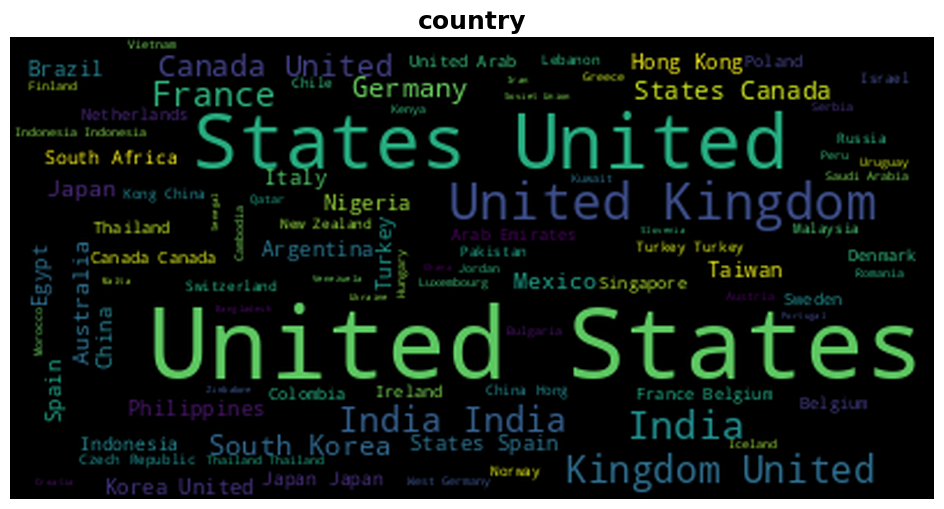

In [ ]:
# word plot for features ['director', 'description', 'title', 'cast', 'listed_in', 'country']

features_for_wordplot = ['director', 'description', 'title', 'cast', 'listed_in', 'country']
for i in features_for_wordplot:

  df_word_cloud = df[i]
  text = " ".join(word for word in df_word_cloud)
  # Create stopword list:
  stopwords = set(STOPWORDS)        #stopwords set is used to remove these common words from the text before generating the word cloud.
  # Generate a word cloud image
  wordcloud = WordCloud(stopwords=stopwords, background_color="black").generate(text)
  # Display the generated image:
  # the matplotlib way:
  plt.figure(figsize=(18,6))
  plt.imshow(wordcloud, interpolation='blackman')
  plt.axis("off")
  plt.title(i, fontsize=18, fontweight='bold')
  plt.show()

##### 1. Why did you pick the specific chart?

Answer Here.

We used a word cloud plot to visualize the most frequently occurring words or terms in a given text or dataset. Word clouds are often used to provide a quick and intuitive visualization of the most important or relevant words, which can help identify key themes, topics, or patterns in the data.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

- In director, the most frequent director names are -: David, Michael, Johns, Daniel, Paul
- In description, the most frequently used words are-: find, love, life, live, man, woman, battle, help, friend etc. which suggests that movies often center around themes of relationships, personal growth, and overcoming obstacles.
- In cast, the most frequent actor names are-: Michael, James, David, John, Paul etc.
- In listed_in, the most frequent genres are-: international movies, dramas, action, adventure, international movies etc.
- In country, most frequent names are-: US, India, UK, Japan, Germany, Cannada etc.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

- Netflix could use this information to tailor its content recommendations to users based on their location, genre preferences, and popular actors/directors. By understanding what types of movies are most popular in which countries, Netflix could produce more localized content and expand its subscriber base.

- Additionally, by identifying the most frequent keywords used in movie descriptions, Netflix could optimize its search algorithm to return more accurate results, and also use this information to craft more compelling movie synopses to entice users to watch.

- Overall, the insights gained from analyzing the Netflix dataset by the above word plot could be leveraged by Netflix to make better business decisions and provide a more personalized experience for its users, which could lead to increased subscriber satisfaction and revenue.

#### Chart - 3

# Director

## Top 20 Directors with most number of Movies/Shows on Netflix

In [ ]:
# Chart - 3 visualization code

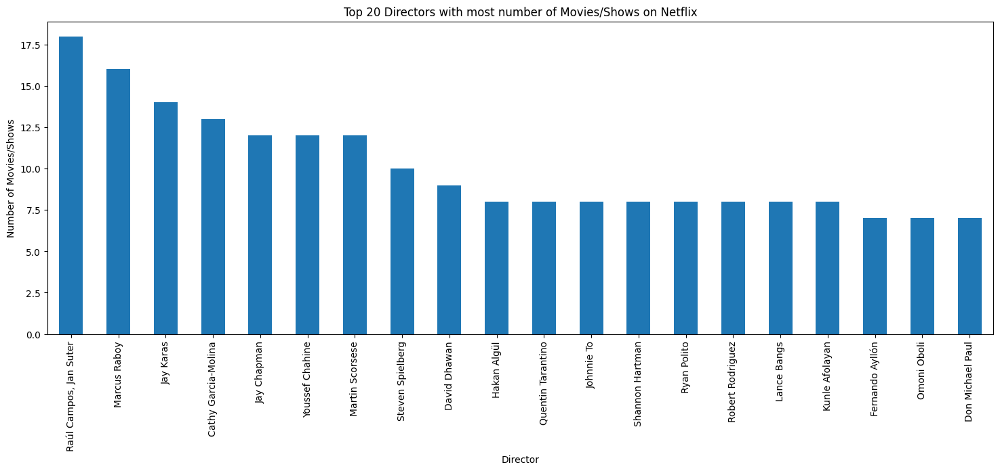

In [ ]:
# Top 20 Directors with most number of Movies/Shows on Netflix

plt.figure(figsize=(18,6))
df['director'].isin(['']).value_counts()
df[~df['director'].isin([''])]['director'].value_counts().head(20).plot(kind='bar')
plt.xlabel('Director')
plt.ylabel('Number of Movies/Shows')
plt.title('Top 20 Directors with most number of Movies/Shows on Netflix')
plt.show()

###  All directors names with only single  movie or tv show and directors with one movie and tv show

In [ ]:
# All directors names with only single  movie or tv show and directors with one movie and tv show

data = df.groupby('director')['type'].value_counts().reset_index(name='count')
data = data[data['count'] == 1]
fig = px.bar(data, x='director', y='count', color='type')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.


 - The bar chart was chosen to visualize the top 20 directors with the most number of movies or TV shows on Netflix and directors with single movie and/or tv show.
This type of chart is appropriate for comparing the values of different categories.

##### 2. What is/are the insight(s) found from the chart?

Answer Here


 - The bar chart shows that the top 20 directors with the most number of movies or TV shows on Netflix are:
- index	count
  - 0	Raúl Campos, Jan Suter	18
  - 1	Marcus Raboy	16
  - 2	Jay Karas	14
  - 3	Cathy Garcia-Molina	13
  - 4	Youssef Chahine	12
  - 5	Martin Scorsese	12
  - 6	Jay Chapman	12
  - 7	Steven Spielberg	10
  - 8	David Dhawan	9
  - 9	Ryan Polito	8
  - 10	Robert Rodriguez	8

 - These directors have all directed a significant number of movies or TV shows that are available on Netflix.
This suggests that they are some of the most popular directors in the world.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

  - Yes, the insights gained from the bar chart can help to create a positive business impact.
By understanding which directors are the most popular on Netflix, the company can make decisions about which movies or TV shows to acquire for its streaming service.
This can help to increase the number of subscribers and the amount of time that they spend watching content on Netflix.

#### Chart - 4

# Cast

In [ ]:
# Chart - 4 visualization code

In [ ]:
# assigning the variable to cast column

df_actors = df['cast']

In [ ]:
# displaying all actors names in a movie or tv show

df_actors

0       João Miguel, Bianca Comparato, Michel Gomes, R...
1       Demián Bichir, Héctor Bonilla, Oscar Serrano, ...
2       Tedd Chan, Stella Chung, Henley Hii, Lawrence ...
3       Elijah Wood, John C. Reilly, Jennifer Connelly...
4       Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...
                              ...                        
7782    Imad Creidi, Antoinette Turk, Elias Gergi, Car...
7783    Vicky Kaushal, Sarah-Jane Dias, Raaghav Chanan...
7784                                              Nasty C
7785                           Adriano Zumbo, Rachel Khoo
7786                                         unknown_cast
Name: cast, Length: 7770, dtype: object

In [ ]:
# convering the all cast ina moveie or tv shows to list

cst_list = list(df['cast'])
cst_list

['João Miguel, Bianca Comparato, Michel Gomes, Rodolfo Valente, Vaneza Oliveira, Rafael Lozano, Viviane Porto, Mel Fronckowiak, Sergio Mamberti, Zezé Motta, Celso Frateschi',
 'Demián Bichir, Héctor Bonilla, Oscar Serrano, Azalia Ortiz, Octavio Michel, Carmen Beato',
 'Tedd Chan, Stella Chung, Henley Hii, Lawrence Koh, Tommy Kuan, Josh Lai, Mark Lee, Susan Leong, Benjamin Lim',
 'Elijah Wood, John C. Reilly, Jennifer Connelly, Christopher Plummer, Crispin Glover, Martin Landau, Fred Tatasciore, Alan Oppenheimer, Tom Kane',
 'Jim Sturgess, Kevin Spacey, Kate Bosworth, Aaron Yoo, Liza Lapira, Jacob Pitts, Laurence Fishburne, Jack McGee, Josh Gad, Sam Golzari, Helen Carey, Jack Gilpin',
 'Erdal Beşikçioğlu, Yasemin Allen, Melis Birkan, Saygın Soysal, Berkan Şal, Metin Belgin, Ayça Eren, Selin Uludoğan, Özay Fecht, Suna Yıldızoğlu',
 'Amina Khalil, Ahmed Dawood, Tarek Lotfy, Ahmed El Fishawy, Mahmoud Hijazi, Jihane Khalil, Asmaa Galal, Tara Emad',
 'Samuel L. Jackson, John Heard, Kelly Row

In [ ]:
# convert the actor to get final df for actor

def convert_to_list(df):
  cast_count = {}
  cast_count_final = []
  cast_list = list(df['cast'])
  for each in range(len(cast_list)):
    cast_count_final.extend(str(cast_list[each]).split(","))
  for each in cast_count_final:
    if each not in cast_count:
      cast_count[each] = cast_count_final.count(each)
  return cast_count

In [ ]:
cast_df = convert_to_list(df)

In [ ]:
# dataframe for cast v/s count
casts_df = pd.DataFrame.from_dict(cast_df, orient='index', columns=['count'])

## Top Actors with highest count of Movies

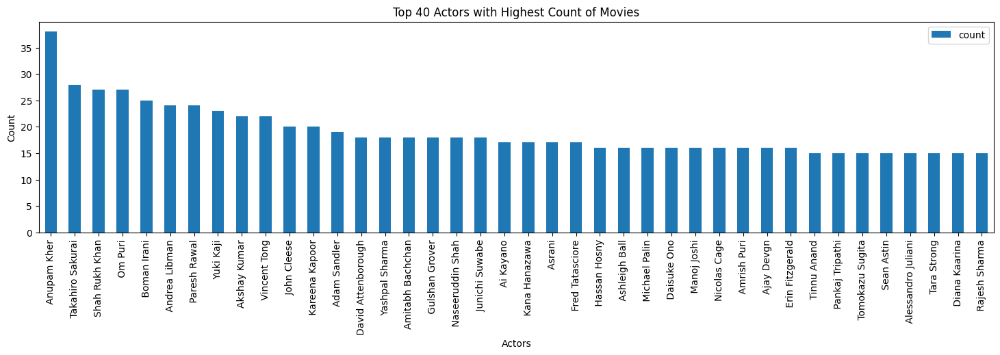

In [ ]:
# top_countries

casts_df = casts_df.drop('unknown_cast')
casts_df.sort_values('count', ascending=False).head(40).plot(kind='bar', figsize=(18, 4))
plt.xlabel('Actors')
plt.ylabel('Count')
plt.title('Top 40 Actors with Highest Count of Movies')
plt.show()

##### 1. Why did you pick the specific chart?

Answer Here.

The bar plot is useful for identifying the most popular actors on Netflix.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

The bar plot shows the top 40 actors with the highest number of movies in the dataset.
 The x-axis shows the actors and the y-axis shows the number of movies they have appeared in.

 This information can be used to make programming decisions, such as which movies to acquire for the streaming service.
The bar plot also shows that there is a wide range of popularity among actors on Netflix.
 Some actors have appeared in many of movies, while others have only appeared in a few.


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

  This information can be used to target different types of audiences with different types of movies.
Overall, the bar plot is a useful tool for understanding the popularity of actors on Netflix.
 This information can be used to make programming decisions that will help to attract and retain viewers.


#  Country

#### Chart - 5

In [ ]:
# Chart - 5 visualization code

### Top 10 Countries with the Most Netflix Productions

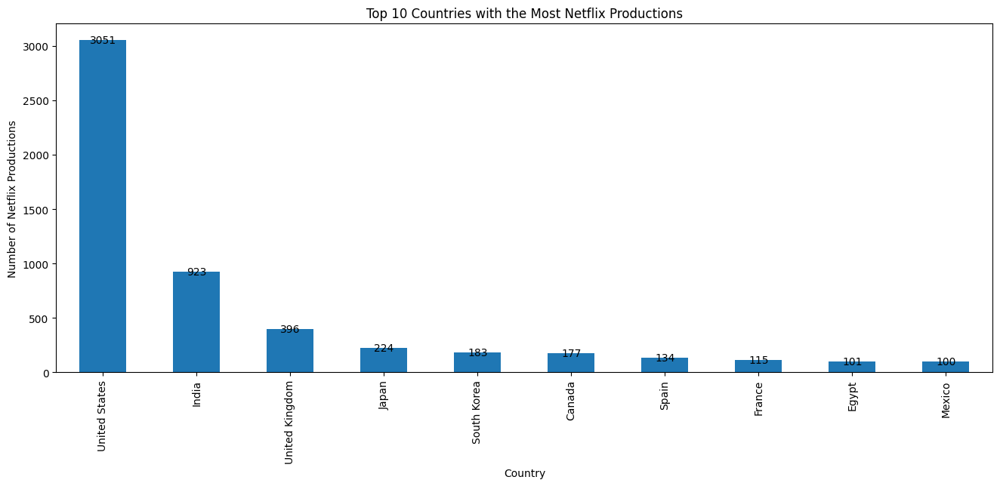

In [ ]:
# countries and number of netflix productions

ax = df.groupby('country')['show_id'].nunique().sort_values(ascending=False).head(10).plot(kind='bar', figsize=(16, 6))
ax.set_xlabel('Country')
ax.set_ylabel('Number of Netflix Productions')
ax.set_title('Top 10 Countries with the Most Netflix Productions')
for p in ax.patches:
  ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=10)
plt.show()


In [ ]:
#
top_countries = df.groupby('country')['show_id'].nunique().sort_values(ascending=False).head(10).index
for country in top_countries:
  print(f'Country: {country}')
  print('Number of Netflix Movie Productions:', df[df['country'] == country]['type'].value_counts()['Movie'])
  print('Number of Netflix TV Productions:', df[df['country'] == country]['type'].value_counts()['TV Show'])
  print()


Country: United States
Number of Netflix Movie Productions: 2076
Number of Netflix TV Productions: 975

Country: India
Number of Netflix Movie Productions: 852
Number of Netflix TV Productions: 71

Country: United Kingdom
Number of Netflix Movie Productions: 193
Number of Netflix TV Productions: 203

Country: Japan
Number of Netflix Movie Productions: 69
Number of Netflix TV Productions: 155

Country: South Korea
Number of Netflix Movie Productions: 36
Number of Netflix TV Productions: 147

Country: Canada
Number of Netflix Movie Productions: 118
Number of Netflix TV Productions: 59

Country: Spain
Number of Netflix Movie Productions: 89
Number of Netflix TV Productions: 45

Country: France
Number of Netflix Movie Productions: 69
Number of Netflix TV Productions: 46

Country: Egypt
Number of Netflix Movie Productions: 89
Number of Netflix TV Productions: 12

Country: Mexico
Number of Netflix Movie Productions: 65
Number of Netflix TV Productions: 35



### Top 10 Countries with the Most Netflix Productions by type

Country: United States
Number of Netflix Movie Productions: 2076
Number of Netflix TV Productions: 975


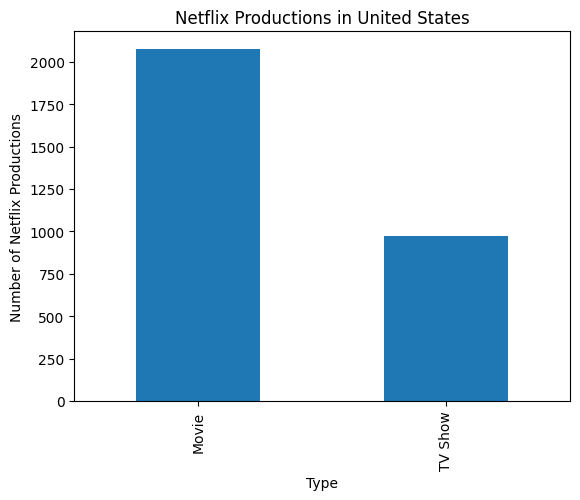

Country: India
Number of Netflix Movie Productions: 852
Number of Netflix TV Productions: 71


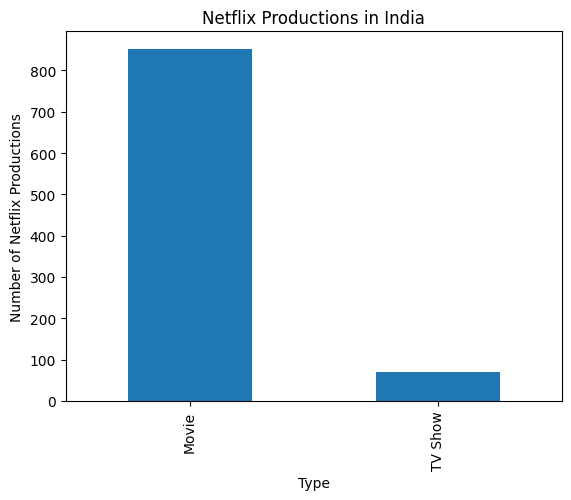

Country: United Kingdom
Number of Netflix Movie Productions: 193
Number of Netflix TV Productions: 203


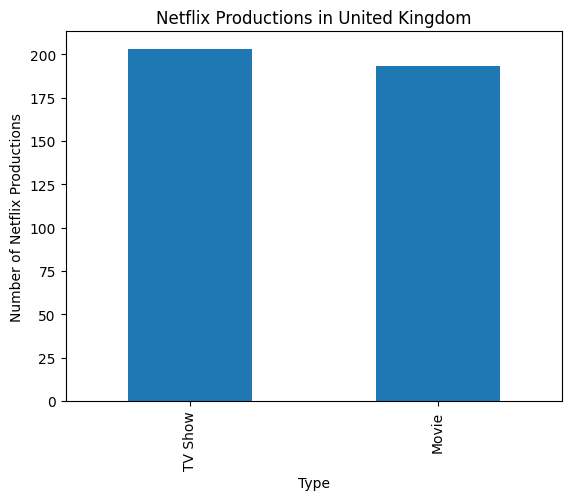

Country: Japan
Number of Netflix Movie Productions: 69
Number of Netflix TV Productions: 155


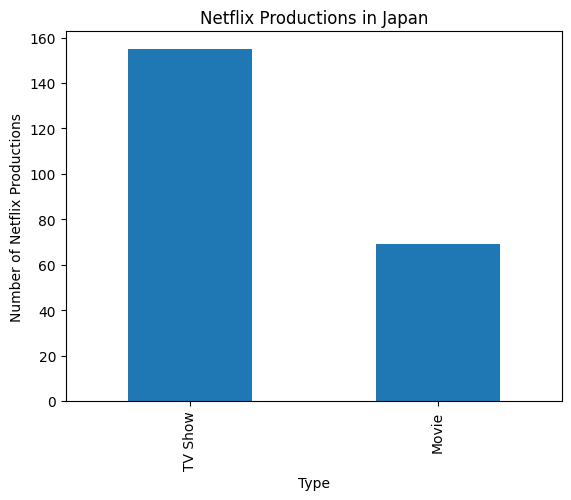

Country: South Korea
Number of Netflix Movie Productions: 36
Number of Netflix TV Productions: 147


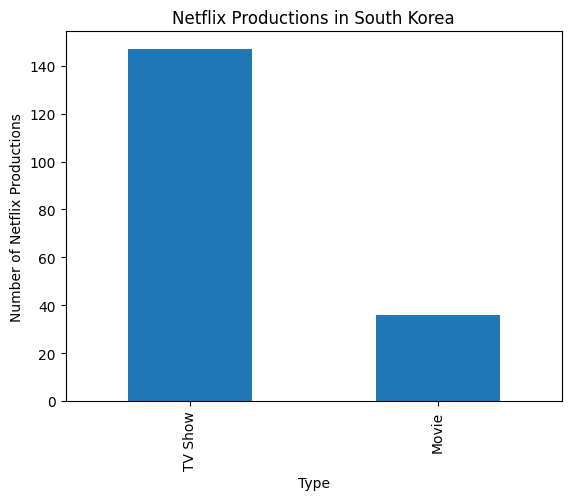

Country: Canada
Number of Netflix Movie Productions: 118
Number of Netflix TV Productions: 59


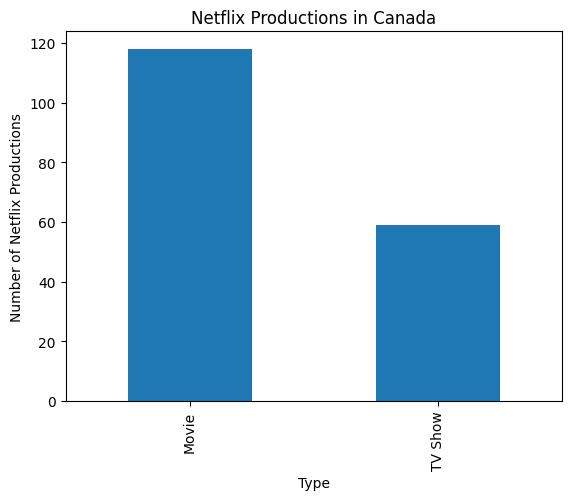

Country: Spain
Number of Netflix Movie Productions: 89
Number of Netflix TV Productions: 45


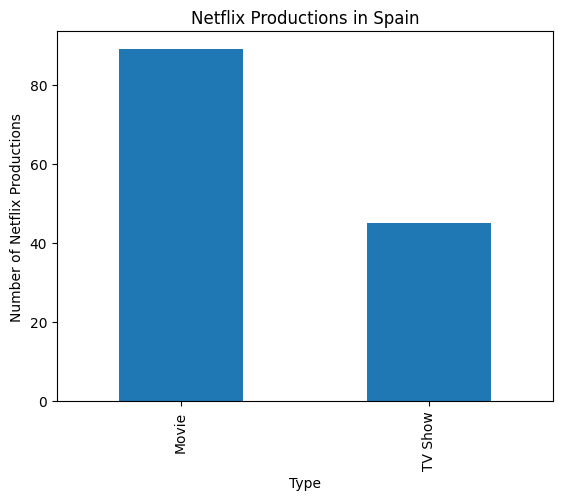

Country: France
Number of Netflix Movie Productions: 69
Number of Netflix TV Productions: 46


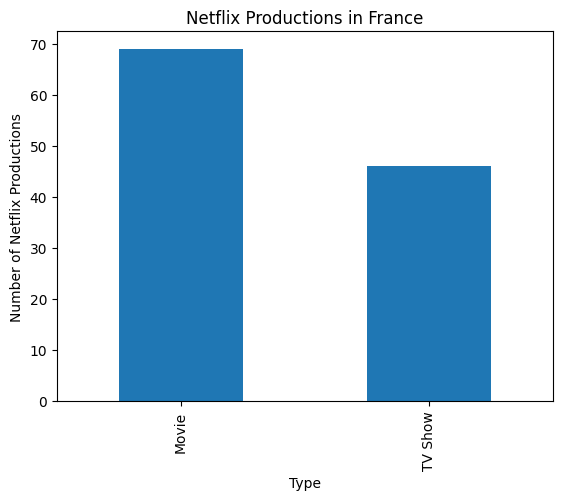

Country: Egypt
Number of Netflix Movie Productions: 89
Number of Netflix TV Productions: 12


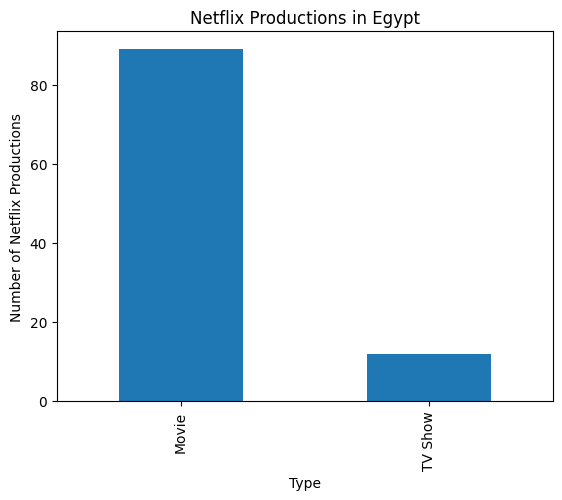

Country: Mexico
Number of Netflix Movie Productions: 65
Number of Netflix TV Productions: 35


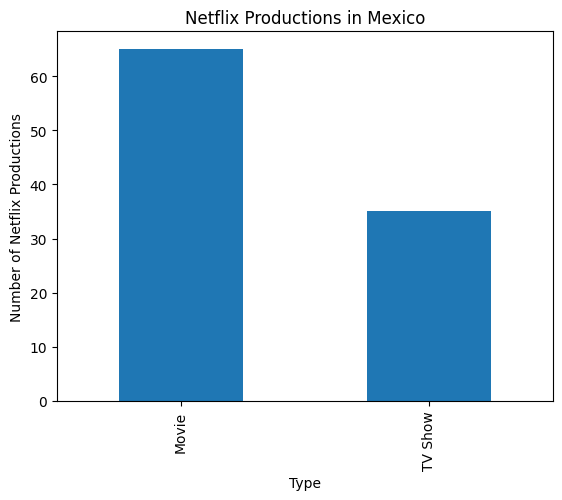

In [ ]:
#

for country in top_countries:
  print(f'Country: {country}')
  print('Number of Netflix Movie Productions:', df[df['country'] == country]['type'].value_counts()['Movie'])
  print('Number of Netflix TV Productions:', df[df['country'] == country]['type'].value_counts()['TV Show'])
  df[df['country'] == country]['type'].value_counts().plot(kind='bar')
  plt.xlabel('Type')
  plt.ylabel('Number of Netflix Productions')
  plt.title(f'Netflix Productions in {country}')
  plt.show()


##### 1. Why did you pick the specific chart?

Answer Here.

The bar chart was chosen because it is a good way to compare the values of different categories.

In this case, the categories are the countries with the most Netflix productions.

The bar chart allows us to see which countries have the most productions, and how many productions each country has.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

- The bar chart shows the top 10 countries with the most Netflix productions.
The x-axis shows the countries and the y-axis shows the number of productions.

- The chart is useful for understanding the distribution of Netflix productions across countries.
It shows that the United States is the country with the most Netflix productions, followed by the India, United Kingdom, Canada, and France.

- The chart can be used to identify countries that are important to Netflix.
These countries are likely to be the most profitable for Netflix, and they are also likely to be the countries where Netflix is most popular.

- The chart can also be used to identify countries that Netflix could target for expansion.
These countries are likely to be countries with a large population and a growing economy.

- Overall, the bar chart is a valuable tool for understanding the distribution of Netflix productions across countries.
It can be used to identify countries that are important to Netflix,
and it can also be used to identify countries that Netflix could target for expansion.


##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

- The insights gained from the chart can help Netflix to create a positive business impact.
For example, Netflix can use the insights to identify countries that are important to its business,
and it can also use the insights to identify countries that it could target for expansion.
 This information can help Netflix to make better decisions about where to invest its resources.

- However, there are also some insights that could lead to negative growth.
 For example, if Netflix finds that a particular country is not profitable,
  it may decide to stop producing content for that country. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the chart can be used to create a positive business impact,
 but there are also some risks that need to be considered.

#### Chart - 6

# Date Added

In [ ]:
# Chart - 6 visualization code

In [ ]:
# changed date added to datetime object

df["date_added"] = pd.to_datetime(df['date_added'])
df['year_added'] = df['date_added'].dt.year

In [ ]:
# netflix added shows and movies on it's flatform between year 2008 to 2021

df['year_added'].min(), df['year_added'].max()

(2008, 2021)

In [ ]:
# adding columns of month and year of addition

df['month'] = pd.DatetimeIndex(df['date_added']).month
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020,8
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016,12
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018,12
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017,11
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2020-01-01,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020,1


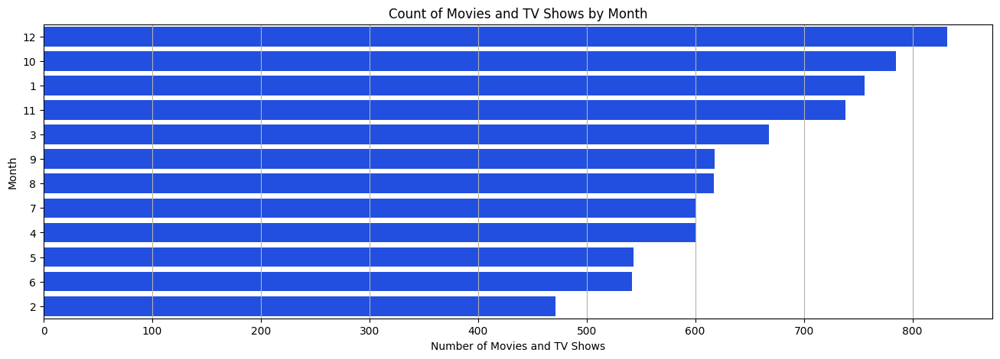

In [ ]:
# Plotting the Countplot

plt.figure(figsize=(16,5))
sns.set_palette('bright')
sns.countplot(y=df['month'],data=df,order=df['month'].value_counts().index)
plt.title('Count of Movies and TV Shows by Month')
plt.xlabel('Number of Movies and TV Shows')
plt.ylabel('Month')
plt.grid(axis='x')

<Axes: xlabel='month', ylabel='count'>

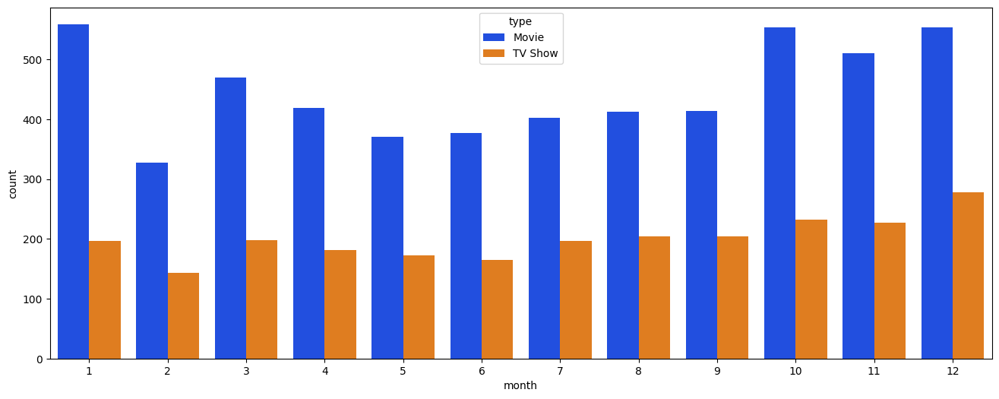

In [ ]:
fig, ax = plt.subplots(figsize=(16,6)) #plt.subplots() is a function that returns a tuple containing a figure and axes object(s).
                                       #Thus when using fig, ax = plt.subplots() we unpack this tuple into the variables fig and ax

sns.countplot(x='month', hue='type',lw=5, data=df, ax=ax)

1. Why did you pick the specific chart?

Answer Here.


Countplot is used to Show the counts of observations in each categorical bin using bars. We used this specific chart to check the count of TV shows and movies over month.



2. What is/are the insight(s) found from the chart?

Answer Here.

Maximum number of content is released in the month of December followed by january.




3. Will the gained insights help creating a positive business impact?

Are there any insights that lead to negative growth? Justify with specific reason.


Answer Here.


These insights can be used to promote more targeted marketing strategies in specific months when the release is high. It can help drive more subsriptions to the platform and eventually more revenue.

#### Chart - 7

#  Release Year

## Count plot for releases over years

In [ ]:
# Chart - 7 visualization code

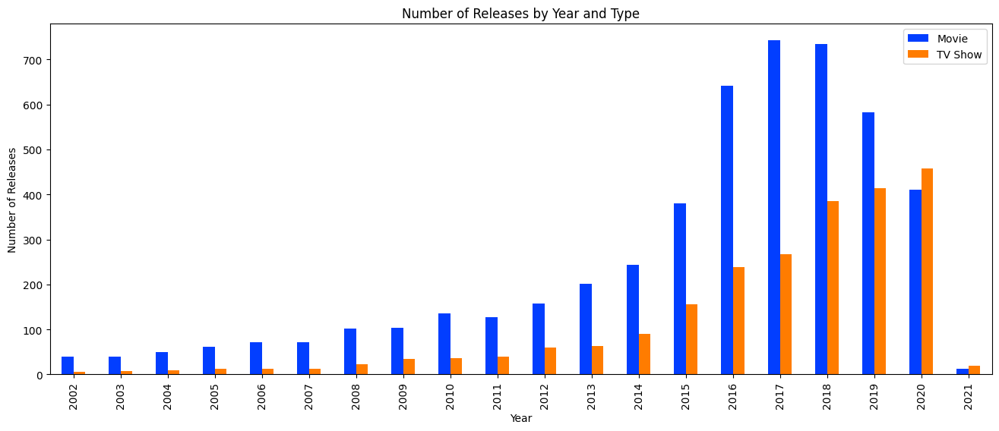

In [ ]:
# Count plot for releases from 2002 year with number count and hue='type

df[df['release_year']>=2002].groupby(['release_year','type']).size().unstack().plot(kind='bar', figsize=(16, 6))
plt.xlabel('Year')
plt.ylabel('Number of Releases')
plt.title('Number of Releases by Year and Type')
plt.legend()
plt.show()

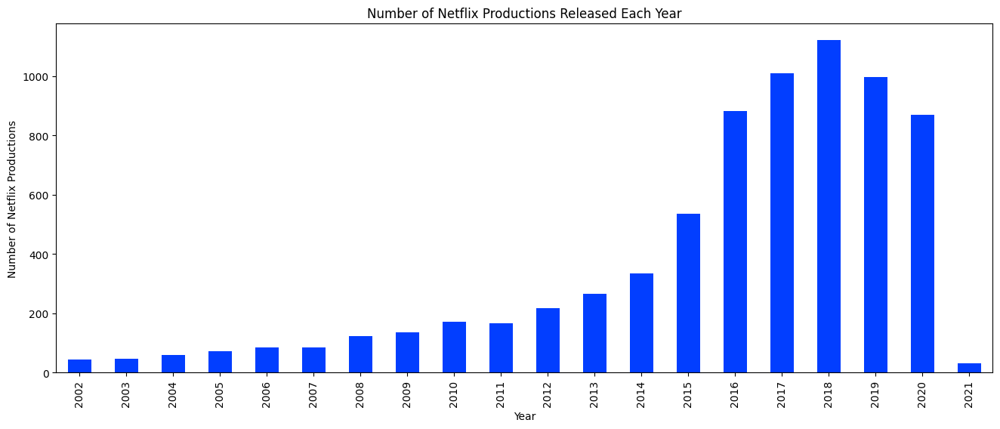

In [ ]:
# Count plot for releases from 2002 year

df[df['release_year']>=2002].groupby('release_year')['show_id'].nunique().plot(kind='bar', figsize=(16, 6))
plt.xlabel('Year')
plt.ylabel('Number of Netflix Productions')
plt.title('Number of Netflix Productions Released Each Year')
plt.show()

In [ ]:
#  visualise above chart in plotly library  from year 1925 to year 2021

import plotly.express as px
df_vis = df[df['release_year']>=1925].groupby(['release_year','type']).size().unstack()
fig = px.bar(df_vis, x=df_vis.index, y=df_vis.columns, color='type',template= "plotly_dark")
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.

- The bar chart was chosen because it is a good way to compare the values of different categories.
 In this case, the categories are the years and the types of productions.
  The bar chart allows us to see how the number of productions has changed over time,
  and how the types of productions have changed over time.

- The plotly chart was chosen because it is a more interactive way to visualize the data.
 The plotly chart allows us to zoom in on specific areas of the chart, and we can also see the data in a table format.
 This makes it easier to see the details of the data.


##### 2. What is/are the insight(s) found from the chart?

Answer Here


- The bar chart shows that the number of Netflix productions has increased significantly over the past 20 years.
In 2002, there were only 24 Netflix productions released, but by 2022, there were over 1,500 productions released.

- The chart also shows that the type of Netflix productions has changed over time.
In 2002, most of the productions were movies, but by 2022, most of the productions were TV shows.

- Overall, the bar chart shows that the number of Netflix productions has increased significantly over the past 20 years and
that the type of productions has changed from movies to TV shows.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

- The insights gained from the charts can help Netflix to create a positive business impact.
 For example, Netflix can use the insights to identify years when it released a lot of popular content,
  and it can also use the insights to identify years when it released a lot of unpopular content.
  This information can help Netflix to make better decisions about what content to produce in the future.

- However, there are also some insights that could lead to negative growth.
 For example, if Netflix finds that it released a lot of unpopular content in a particular year,
 it may decide to reduce the amount of content it produces in that year. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the charts can be used to create a positive business impact,
but there are also some risks that need to be considered.

# 8. Rating

#### Chart - 8

## Rating Column Distribution by Pie Chart

In [ ]:
# Chart - 8 visualization code

In [ ]:
# # Rating Column Distribution by plotly Pie Chart

# df['rating'].value_counts().plot(kind='pie',figsize=(16, 10))
# plt.xlabel('Rating')
# plt.ylabel('Number of Shows')
# plt.title('Rating Distribution')
# plt.show()

In [ ]:
# Rating Column Distribution by Plotly library's Chart

fig = px.pie(df['rating'].value_counts(), values='rating', names=df['rating'].value_counts().index, title='Distribution of Ratings')
fig.update_traces(textposition='outside', textinfo='percent+label')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.

- The pie chart was chosen because it is a good way to visualize the distribution of data.
In this case, the data is the distribution of ratings for Netflix shows. The pie chart allows us to see how many shows have each rating.

- The plotly pie chart was chosen because it is a more interactive way to visualize the data.
The plotly pie chart allows us to zoom in on specific areas of the chart, and we can also see the data in a table format.
This makes it easier to see the details of the data.

##### 2. What is/are the insight(s) found from the chart?

Answer Here


- The pie chart shows that the most common rating for Netflix shows is TV-MA stars.
This is followed by TV-14 stars, TV-PG stars, and R stars. There are very few shows with a rating of NC-17 star.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

- The insights gained from the pie chart can help Netflix to create a positive business impact.
For example, Netflix can use the insights to identify shows that are popular with viewers.
 This information can help Netflix to make better decisions about what content to produce in the future.

- However, there are also some insights that could lead to negative growth.
For example, if Netflix finds that a particular type of show is not popular with viewers,
 it may decide to produce fewer shows of that type. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the pie chart can be used to create a positive business impact,
but there are also some risks that need to be considered.


#### Chart - 9

In [ ]:
# Chart - 9 visualization code

### Count of each rating

In [ ]:
# Rating Column Distribution by Plotly library's bar Chart

import plotly.express as px
fig = px.bar(df['rating'].value_counts(), x=df['rating'].value_counts().index, y='rating', template= "plotly_dark",
             title = 'MOST OF PROGRAMME ON NETFLIX IS TV-MA & TV-14  RATED')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.

- The bar chart was chosen because it is a good way to compare the values of different categories.
In this case, the categories are the ratings and the values are the number of shows with each rating.
- The plotly bar chart was chosen because it is a more interactive way to visualize the data.
The plotly bar chart allows us to zoom in on specific areas of the chart, and we can also see the data in a table format.
This makes it easier to see the details of the data.

##### 2. What is/are the insight(s) found from the chart?

Answer Here


- The bar chart shows that the most common rating for Netflix shows is TV-MA.
This is followed by TV-14, TV-PG, and R. There are very few shows with a rating of NC-17.

- The bar chart also shows that the number of shows with each rating has increased over time.
This is likely due to the fact that Netflix has been producing more and more content in recent years.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here


- The bar chart also shows that the rating of Netflix shows has changed over time.
In the early years, most Netflix shows were rated TV-MA. However, in recent years,
there has been a trend towards more shows being rated TV-14 and TV-PG.

- Overall, the bar chart provides a good overview of the distribution of ratings for Netflix shows over time.


#### Chart - 10

## Rating distribution by Content Type

In [ ]:
# Chart - 10 visualization code

In [ ]:
#  Rating distribution by Content Type with plotly library

fig = px.bar(df.groupby(['type','rating'])['show_id'].count().reset_index(), x="type", y="show_id", color='rating',
             barmode='group')

fig.update_layout(
    title='Rating distribution by Content Type',
    xaxis_title='Content Type',
    yaxis_title='Number of Shows',
    legend_title='Rating',
    template= "plotly_dark")
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.


The plotly bar chart was chosen because it is a more interactive way to visualize the data.
 The plotly bar chart allows us to zoom in on specific areas of the chart, and we can also see the data in a table format.
 This makes it easier to see the details of the data.


##### 2. What is/are the insight(s) found from the chart?

Answer Here

- The bar chart shows that the most popular type of content on Netflix is movies. This is followed by TV shows.

- The chart also shows that the most popular rating for Netflix content is TV-MA RATING. This is followed by TV-14 rating, TV-PG rating, and others.
There are very few shows with a rating of G, TV-G, NA star.

- Overall, the bar chart shows that the most popular type of content on Netflix is movies, and the most popular rating is TV-MA stars.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here

- The insights gained from the charts can help Netflix to create a positive business impact.
For example, Netflix can use the insights to identify years when it released a lot of popular content,
and it can also use the insights to identify years when it released a lot of unpopular content.
 This information can help Netflix to make better decisions about what content to produce in the future.

- However, there are also some insights that could lead to negative growth.
For example, if Netflix finds that it released a lot of unpopular content in a particular year,
it may decide to reduce the amount of content it produces in that year. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the charts can be used to create a positive business impact,
but there are also some risks that need to be considered.

# Duration Column

#### Chart - 11

In [ ]:
# Chart - 11 visualization code

In [ ]:
# duration column
df['duration']

0       4 Seasons
1          93 min
2          78 min
3          80 min
4         123 min
          ...    
7782       99 min
7783      111 min
7784       44 min
7785     1 Season
7786       90 min
Name: duration, Length: 7770, dtype: object

In [ ]:
# subsetting TV Show and Movie for duration

netflix_shows=df[df['type']=='TV Show']
netflix_movies=df[df['type']=='Movie']

## Netflix Movie Duration Distribution

In [ ]:
# disable chained assignments
pd.options.mode.chained_assignment = None

In [ ]:
# movie duration subsetting
netflix_movies['duration'] = df.loc[df['type'] == 'Movie', 'duration'].str.replace(' min', '')
netflix_movies['duration'] = netflix_movies['duration'].astype(str).astype(int)
netflix_movies['duration']

1        93
2        78
3        80
4       123
6        95
       ... 
7781     88
7782     99
7783    111
7784     44
7786     90
Name: duration, Length: 5372, dtype: int64

### Netflix Movie Duration Distribution (in minutes)

In [ ]:
# visualize netflix_movies['duration']

fig = px.histogram(netflix_movies, x='duration', template= "plotly_dark", title='Netflix Movie Duration Distribution (in minutes)')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.

A histogram was chosen because it is a good way to visualize the distribution of data.
 In this case, the data is the distribution of durations for Netflix movies.
  The histogram allows us to see how many movies have each duration.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

The histogram shows that the most common duration for Netflix movies is between 90 and 120 minutes.
There are also a significant number of movies that are shorter than 90 minutes and longer than 120 minutes.
This suggests that Netflix offers a wide variety of movies to suit different tastes.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here


- The insights gained from the histogram can help Netflix to create a positive business impact.
For example, Netflix can use the insights to identify the most popular duration for movies,
 and it can also use the insights to identify the least popular duration for movies.
 This information can help Netflix to make better decisions about what movies to produce in the future.

- However, there are also some insights that could lead to negative growth.
For example, if Netflix finds that it is producing too many movies that are longer than 120 minutes,
 it may decide to reduce the number of movies it produces in that category. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the histogram can be used to create a positive business impact,
 but there are also some risks that need to be considered.

#### Chart - 12

## Netflix TV Show Duration Distribution

In [ ]:
# Chart - 12 visualization code

In [ ]:
# Netflix tv Show Duration Distribution (seasons)

# subset the dataframe for TV Shows
netflix_shows = df[df['type'] == 'TV Show']

# create a histogram of the durations of the TV shows
fig = px.histogram(netflix_shows, x='duration', template= "plotly_dark", title='Netflix TV Show Duration Distribution (seasons)')
fig.update_layout(
    xaxis_title='Duration (seasons)',
    yaxis_title='Number of Shows')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.

 A histogram was chosen because it is a good way to visualize the distribution of data.
 In this case, the data is the distribution of durations for Netflix shows.
 The histogram allows us to see how many shows have how many number of seasons.

##### 2. What is/are the insight(s) found from the chart?

Answer Here


- The histogram shows that the most number of TV shows are of 1 season.
- There are also a significant number of shows that have 2, 3, and 4 seasons.
- This suggests that Netflix offers a wide variety of shows to suit different tastes.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here


- The insights gained from the histogram can help Netflix to create a positive business impact.
 For example, Netflix can use the insights to identify the most popular duration for shows,
 and it can also use the insights to identify the least popular duration for shows.
 This information can help Netflix to make better decisions about what shows to produce in the future.



# Listed In ( Genre )

#### Chart - 13

In [ ]:
# Chart - 13 visualization code

In [ ]:
# genre to list

def convert_to_list(df):
  genre_count = {}
  genre_count_final = []
  genre_list = list(df['listed_in'])
  for each in range(len(genre_list)):
    genre_count_final.extend(genre_list[each].split(", "))
  for each in genre_count_final:
    if each not in genre_count:
      genre_count[each] = genre_count_final.count(each)
  return genre_count

In [ ]:
# to list

genre_dict = convert_to_list(df)

In [ ]:
# make genre df

genre_df = pd.DataFrame.from_dict(genre_dict, orient='index', columns=['count']).sort_values('count', ascending=False)

In [ ]:
# genre distribution

genre_df

,count
International Movies,2437
Dramas,2105
Comedies,1471
International TV Shows,1197
Documentaries,786
Action & Adventure,721
TV Dramas,703
Independent Movies,673
Children & Family Movies,532
Romantic Movies,531


In [ ]:
len(genre_df)

42

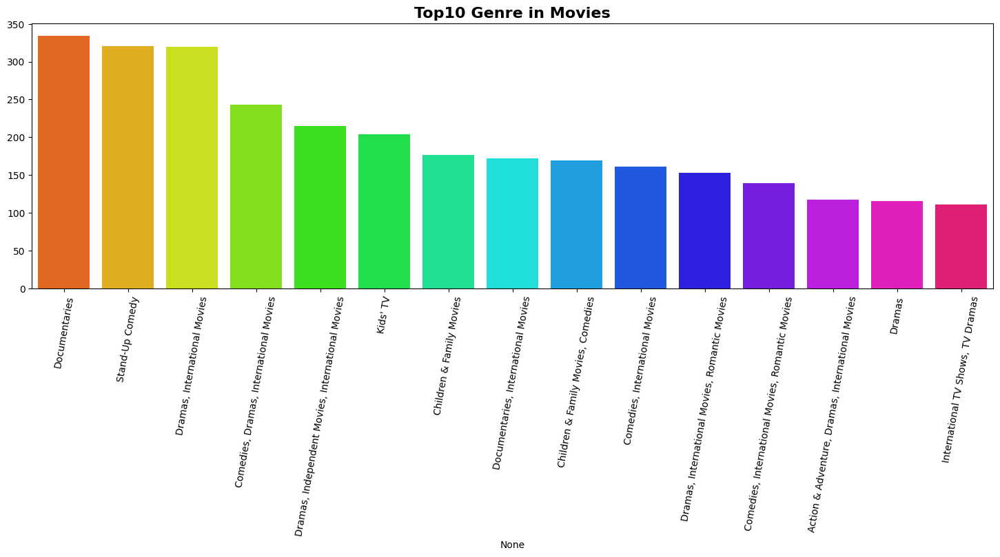

In [ ]:
# Top 10 Genre in movies

plt.figure(figsize=(18,5))
sns.barplot(x = df["listed_in"].value_counts().head(15).index,
            y = df["listed_in"].value_counts().head(15).values,palette="hsv")
plt.xticks(rotation=80)
plt.title("Top10 Genre in Movies",size='16',fontweight="bold")
plt.show()

# All unique Genre wise Count Distribution

In [ ]:
# visualize Genre wise Count Distribution

fig = px.bar(genre_df, x=genre_df.index, y='count', template= "plotly_dark", title='Genre wise Count Distribution')
fig.update_layout(
    xaxis_title='Genre',
    yaxis_title='Count')
fig.show()

##### 1. Why did you pick the specific chart?

Answer Here.


 A bar chart was chosen because it is a good way to visualize the distribution of data.
In this case, the data is the distribution of counts for each genre. The bar chart allows us to see how many movies or shows are in each genre.


##### 2. What is/are the insight(s) found from the chart?

Answer Here

The bar chart shows that the most common genre for Netflix movies is Drama.
There are also a significant number of movies in the Comedy and Action genres.
This suggests that Netflix offers a wide variety of movies to suit different tastes.


However, the chart also shows that there are some genres that are not represented well as others.
 For example, there are only a few shows in the genres "cult", "classic", and "thriller".
This could be because these genres are not as popular as the other genres.
It could also be because Netflix does not produce as many shows in these genres.

Overall, the chart shows that Netflix offers a wide variety of genres,
but there are some genres that are not represented as well as others.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Answer Here


- The insights gained from the bar chart can help Netflix to create a positive business impact.
For example, Netflix can use the insights to identify the most popular genres of movies,
 and it can also use the insights to identify the least popular genres of movies.
 This information can help Netflix to make better decisions about what movies to produce in the future.

- However, there are also some insights that could lead to negative growth.
 For example, if Netflix finds that it is producing too many movies in the Drama genre,
 it may decide to reduce the number of movies it produces in that genre. This could lead to a decline in Netflix's revenue.

- Overall, the insights gained from the bar chart can be used to create a positive business impact,
but there are also some risks that need to be considered.


#### Chart - 14 - Correlation Heatmap

In [ ]:
# Correlation Heatmap visualization code

In [ ]:
# make copy of df

df1 = df.copy()

In [ ]:
# Assigning the Ratings into grouped categories
ratings = {
    'TV-PG': 'Older Kids',
    'TV-MA': 'Adults',
    'TV-Y7-FV': 'Older Kids',
    'TV-Y7': 'Older Kids',
    'TV-14': 'Teens',
    'R': 'Adults',
    'TV-Y': 'Kids',
    'NR': 'Adults',
    'PG-13': 'Teens',
    'TV-G': 'Kids',
    'PG': 'Older Kids',
    'G': 'Kids',
    'UR': 'Adults',
    'NC-17': 'Adults'
}
df1['target_ages'] = df1['rating'].replace(ratings)

In [ ]:
# type should be a categorical

df1['type'] = pd.Categorical(df1['type'])
df1['target_ages'] = pd.Categorical(df1['target_ages'], categories=['Kids', 'Older Kids', 'Teens', 'Adults'])

In [ ]:
# Preparing data for heatmap
df1['count'] = 1
data = df1.groupby('country')[['country','count']].sum().sort_values(by='count',ascending=False).reset_index()[:10]
data = data['country']

df_heatmap = df1.loc[df1['country'].isin(data)]
df_heatmap = pd.crosstab(df_heatmap['country'],df_heatmap['target_ages'],normalize = "index").T
df_heatmap

country,Canada,Egypt,France,India,Japan,Mexico,South Korea,Spain,United Kingdom,United States
target_ages,,,,,,,,,,
Kids,0.180791,0.000000,0.095652,0.016251,0.008929,0.02,0.027322,0.022388,0.093434,0.089479
Older Kids,0.225989,0.039604,0.060870,0.160347,0.272321,0.07,0.120219,0.044776,0.204545,0.195346
Teens,0.146893,0.683168,0.165217,0.567714,0.352679,0.14,0.382514,0.097015,0.189394,0.243199
Adults,0.446328,0.277228,0.678261,0.255688,0.366071,0.77,0.469945,0.835821,0.512626,0.471976


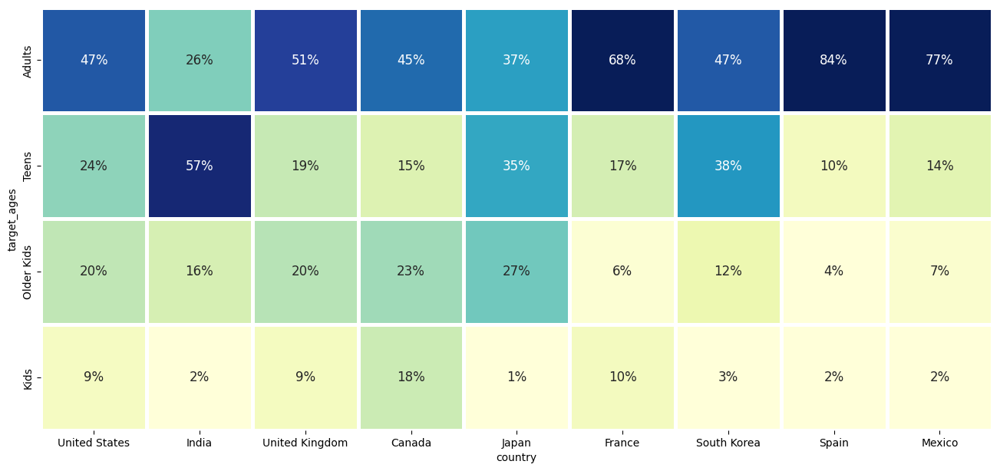

In [ ]:
# Plotting the heatmap

fig, ax = plt.subplots(1, 1, figsize=(16, 12))

country_order2 = ['United States', 'India', 'United Kingdom', 'Canada', 'Japan', 'France', 'South Korea', 'Spain',
       'Mexico']

age_order = ['Adults', 'Teens', 'Older Kids', 'Kids']

sns.heatmap(df_heatmap.loc[age_order,country_order2],cmap="YlGnBu",square=True, linewidth=2.5,cbar=False,
            annot=True,fmt='1.0%',vmax=.6,vmin=0.05,ax=ax,annot_kws={"fontsize":12})
plt.show()

##### 1. Why did you pick the specific chart?

Answer Here.



 A correlation heatmap was chosen because it is a good way to visualize the relationships between different variables.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

- US and UK are closely aligned with their Netflix target ages, means that people in both USA and UK prefer to watch similar type of content.

- In similar way US and Canada are also highly aligned with their Netflix target ages.

- Overall, the heatmap provides a useful way to visualize the relationship between the target ages of Netflix content and the countries where it is produced.


- This information can be used to identify opportunities for Netflix to expand its reach and target new audiences.

#### Chart - 15 - Pair Plot

In [ ]:
# Pair Plot visualization code

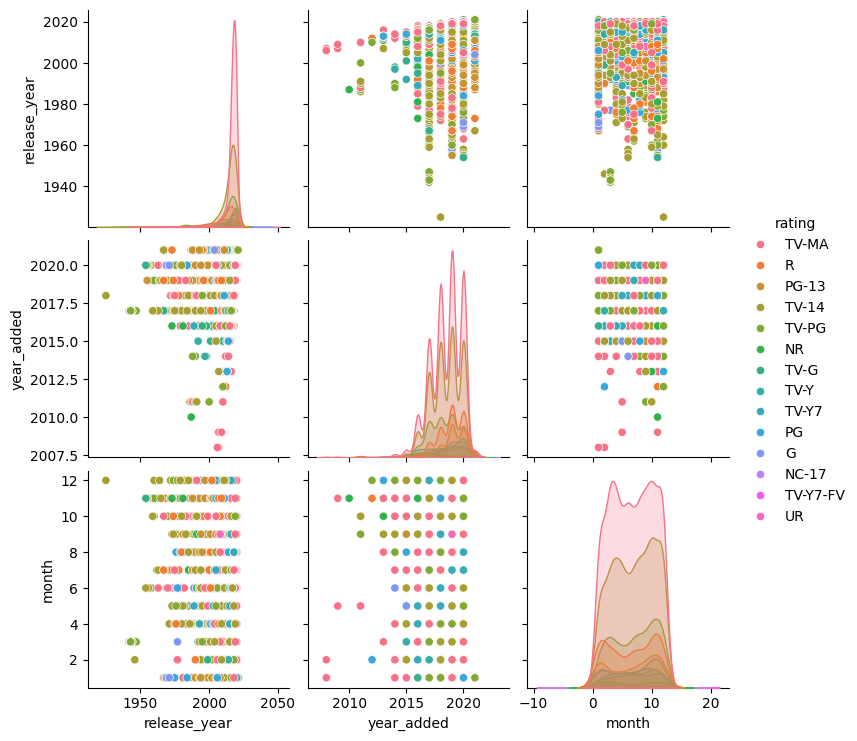

In [ ]:
# Pair Plot visualization on ratings, date, year, month and count.

sns.pairplot(df, hue='rating', diag_kind='kde')
plt.show()

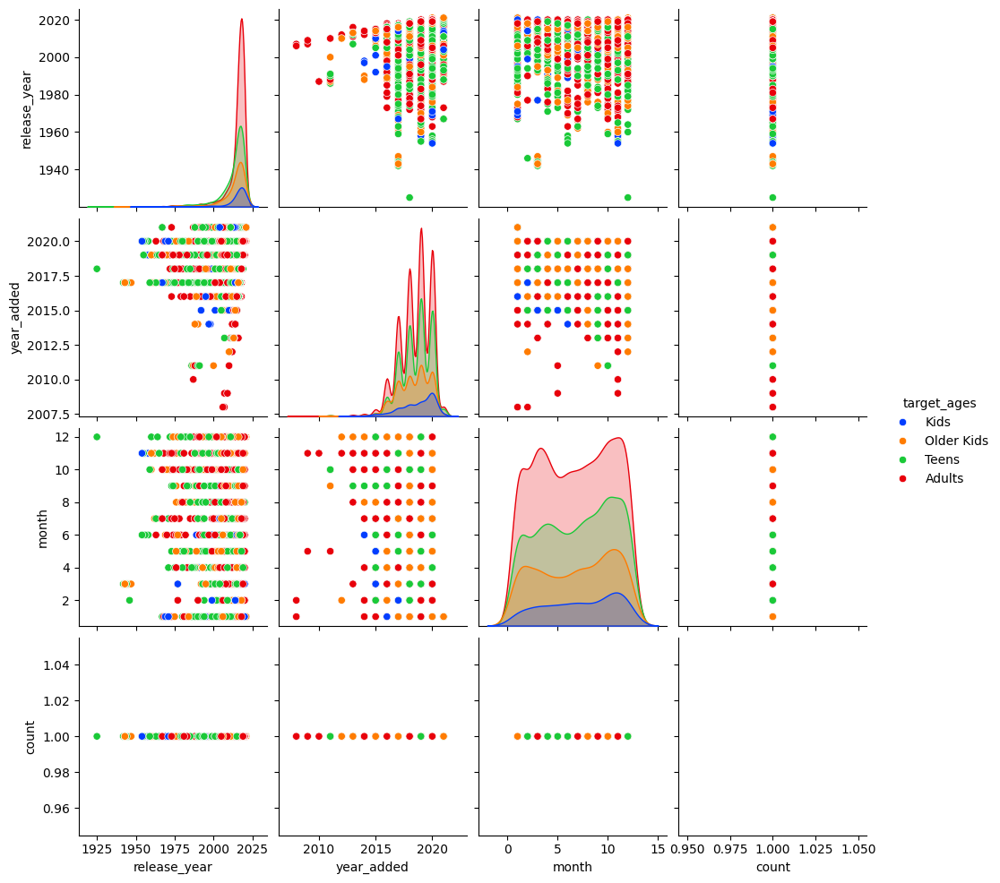

In [ ]:
# pair plot for target_ages column, date, year, month and count.

sns.pairplot(df1, hue='target_ages')
plt.show()

##### 1. Why did you pick the specific chart?

Answer Here.


A pair plot was chosen because it is a good way to visualize the relationships between different variables.

##### 2. What is/are the insight(s) found from the chart?

Answer Here

- The pair plot shows the correlation between the content released or added on netflix by yearwise and monthwise and type of content for targeted audience.
- There are more content added for adults each year followed by kids or older kids and teens.
- The pair plot also shows that there is a negative correlation between the number of seasons and the rating.

## **Word Cloud Visualisations**

In [ ]:
#word cloud for user rating review

def func_select_Category(category_name,category_column,column_of_choice):
  df_word_cloud = df[[category_column,column_of_choice]].dropna()
  df_word_cloud = df_word_cloud[df_word_cloud[category_column]==category_name]
  text = " ".join(word for word in df_word_cloud[column_of_choice])
  # Create stopword list:
  stopwords = set(STOPWORDS)
  # Generate a word cloud image
  wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)
  # Display the generated image:
  # the matplotlib way:
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis("off")
  plt.show()

# Description

## Word Cloud for Movie on Description Column

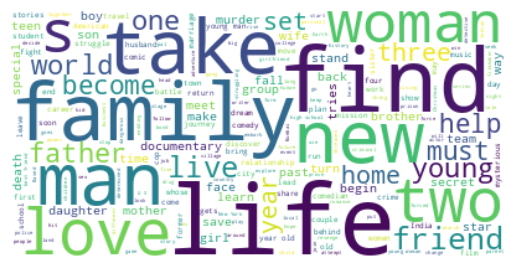

In [ ]:
func_select_Category('Movie','type','description')

### Most words like Life, family are popping up

- The word cloud shows that the most common words in the descriptions of movies are "family", "life", "find", "action", and "love".
- This suggests that these are the most important elements of a movie plot.
- The word cloud also shows that the words "murder", "save", and "help" are also common in the descriptions of movies.
- Overall, the word cloud provides a good overview of the most important elements of a movie plot.

## Word Cloud for TV show on Description Column

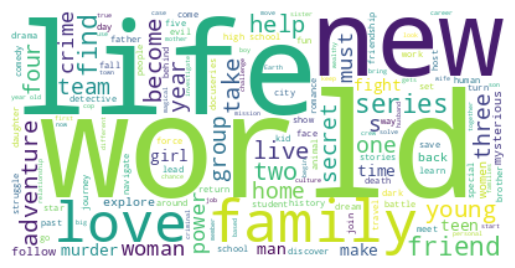

In [ ]:
func_select_Category('TV Show','type','description')

### Most words like Life, world popping up

# Bivariate and Trend Analysis

#  Country Wise Trend Analysis

* country vs genre
* country vs rating
* country vs type
* country vs year_added
* country vs top directors
* country vs top cast
* country vs release year

## Plotting country wise trend for genre preference

### All country's genres preference were plotted

## country vs genre


In [ ]:
# genre country wise

def get_genre_country_trends(df):
  def explode_country(country):
    try:
        return country.split(", ")
    except:
        return ""
  df['country_list'] = df.apply(lambda x: explode_country(x['country']),axis=1)
  df = df.explode('country_list')
  df['genre_list'] = df.apply(lambda x: explode_country(x['listed_in']),axis=1)
  df = df.explode('genre_list')
  df.groupby(['country_list','genre_list']).agg({'title':'count'})
  grouped_df_ = df.groupby(['country_list','genre_list']).agg({'title':'count'})
  grouped_df = grouped_df_.reset_index()
  grouped_df['country_list'].values
  grouped_df = grouped_df[grouped_df.country_list != '']
  rating_country_df = grouped_df.reset_index().drop("index", axis=1)
  list_of_countries = list(set(list(rating_country_df['country_list'].values)))
  for each in list_of_countries:
    rating_country_df[rating_country_df['country_list'] == each].sort_values("title",ascending=False).plot.bar(x = "genre_list", y="title", color="skyblue", rot=90, figsize=(9,5))
    plt.title(f"{each}")
  return rating_country_df

### Bar chart visualisation for, in which genre the content is available or produced from each country and it's count.

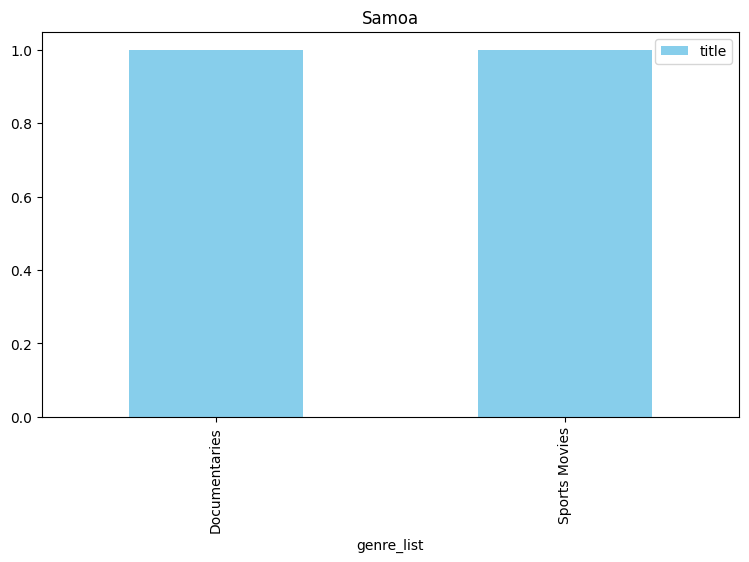

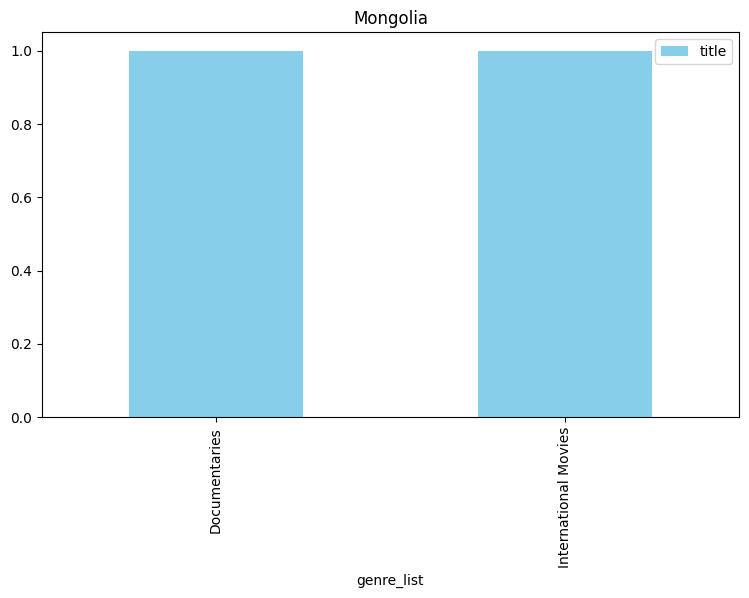

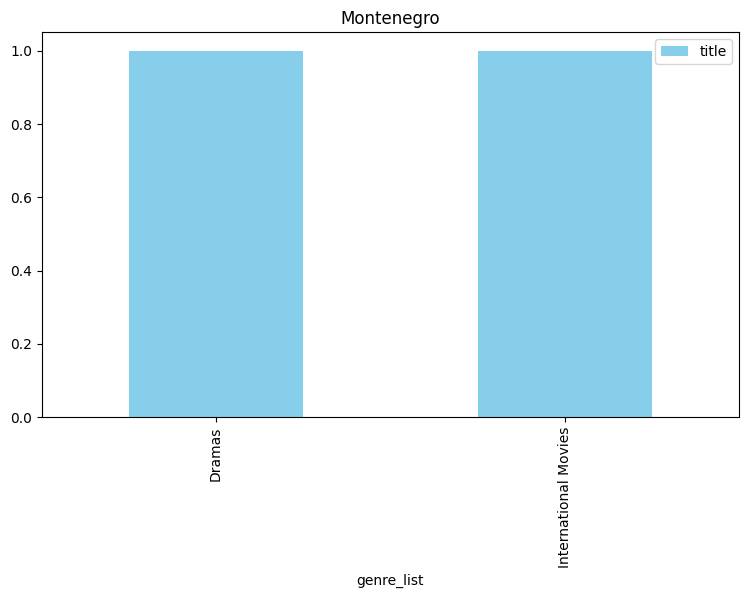

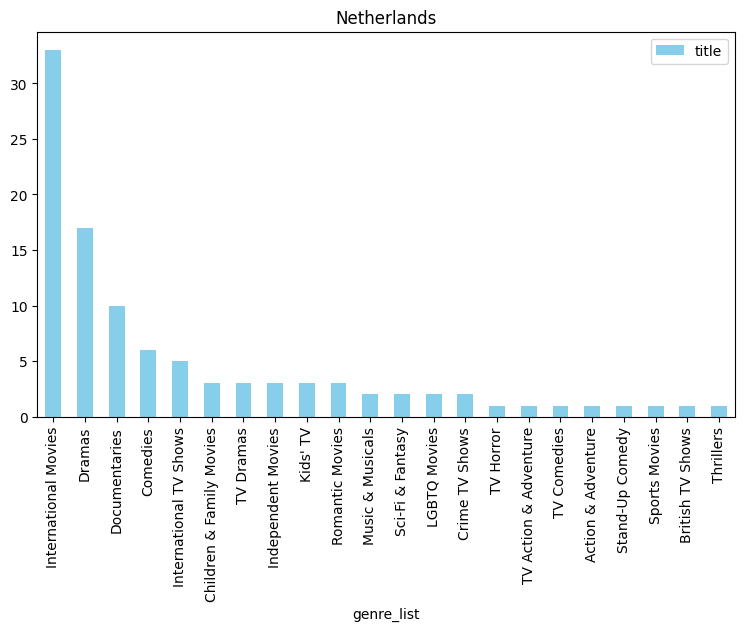

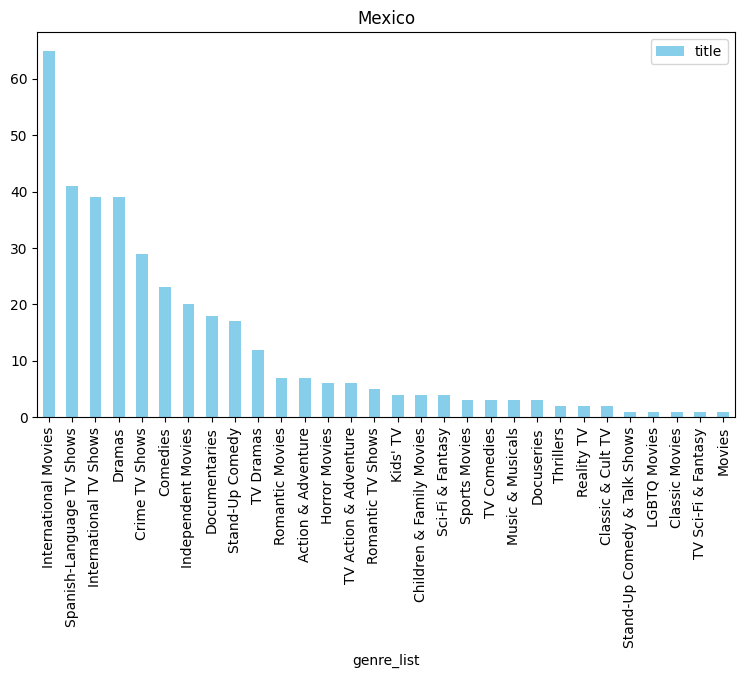

...

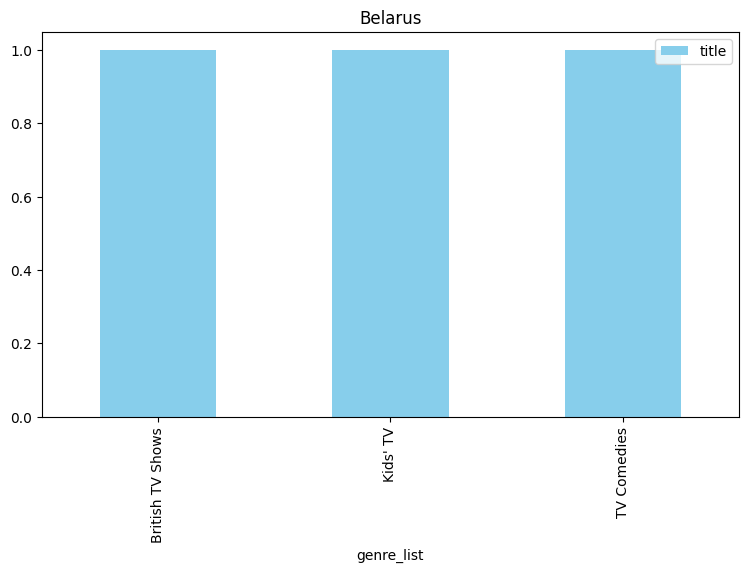

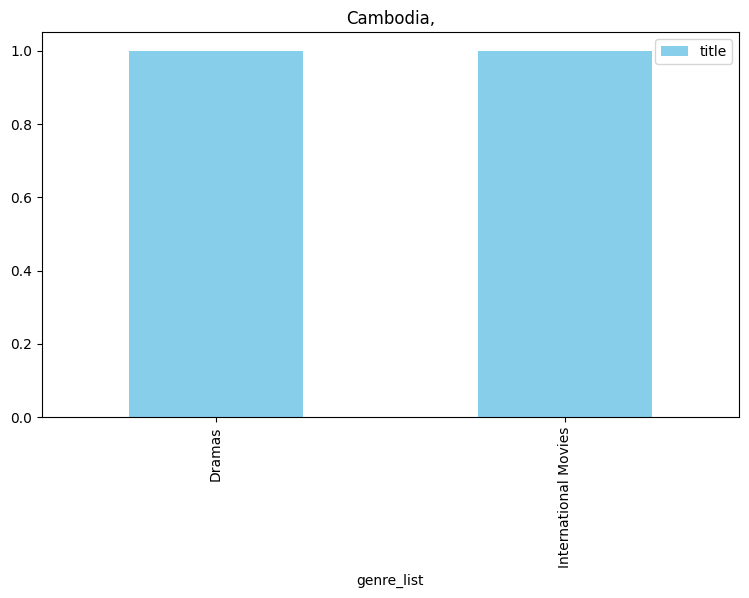

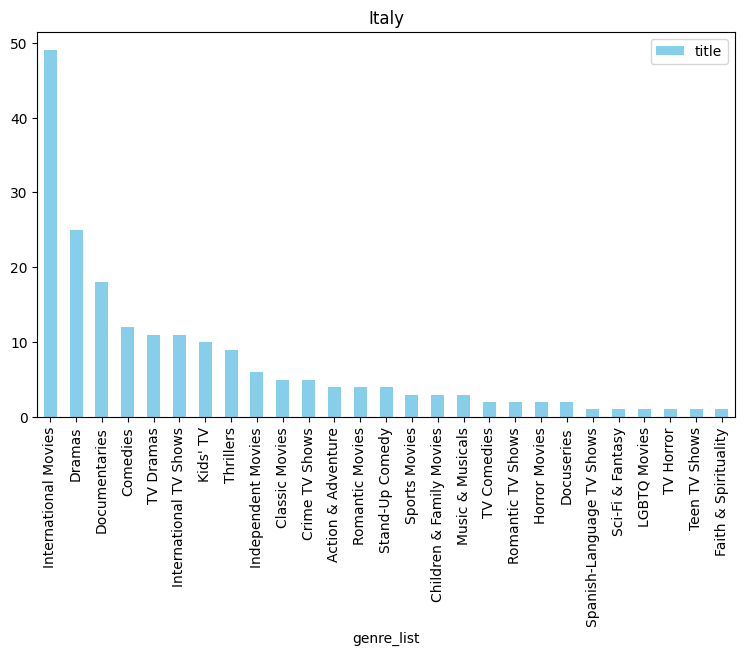

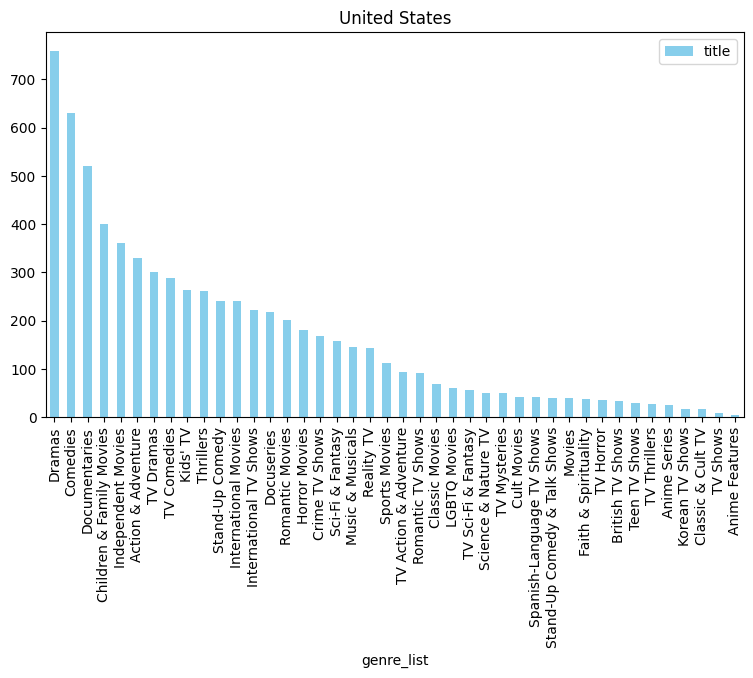

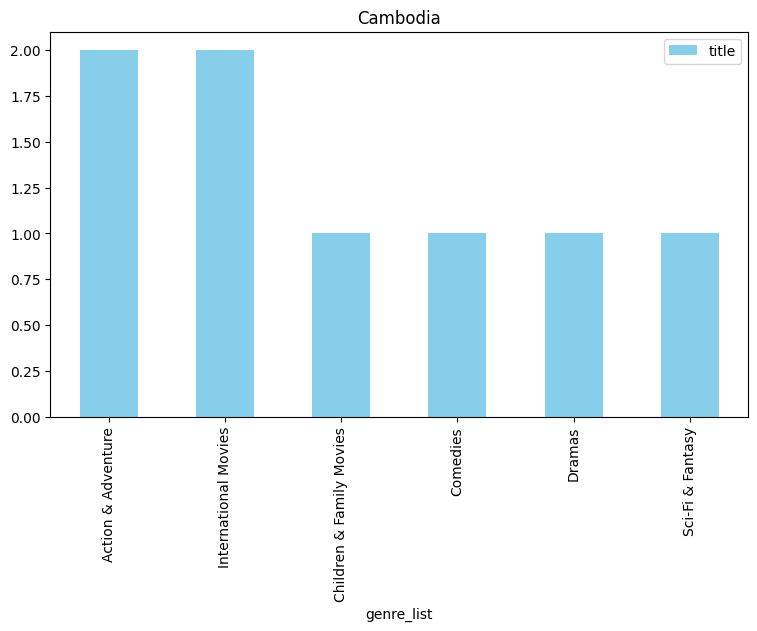

In [ ]:
# Bar chart visualisation for, in which genre the content is available or produced from each country and it's count.

rating_country_df = get_genre_country_trends(df)


# country vs rating


### Most popular genres for 5 countries with most productions

In [ ]:
# creating function to word plot the most popular genres for 5 countries with most productions

def get_word_clouds(rating_country_df):
  country_list_ = ["United States", "India", "United Kingdom", "France", "Canada"]
  from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
  for each in country_list_:
    plt.rcParams['figure.figsize'] = (10, 10)
    wordcloud = WordCloud(stopwords=STOPWORDS,background_color = 'white', width = 1000,  height = 500, max_words = 121).generate(' '.join(rating_country_df[rating_country_df["country_list"]==each]['genre_list']))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(f'Most popular genres for {each}',fontsize = 30)
    plt.show()

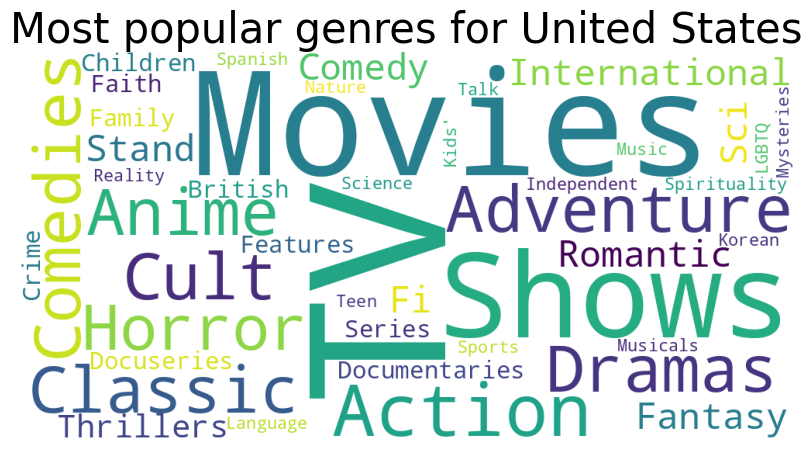

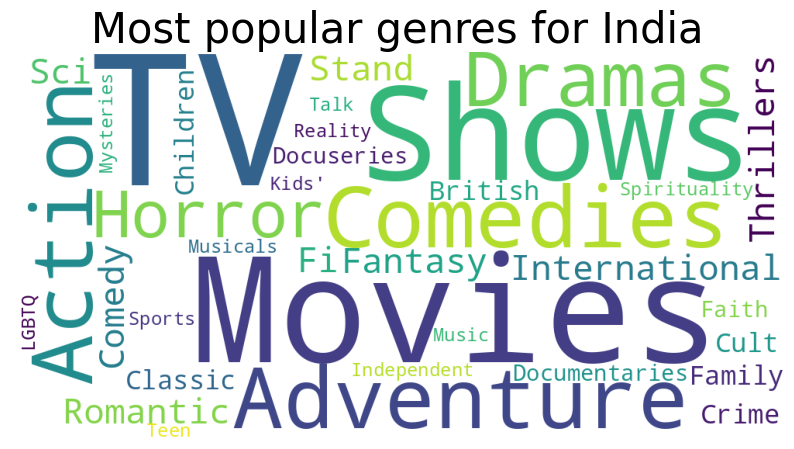

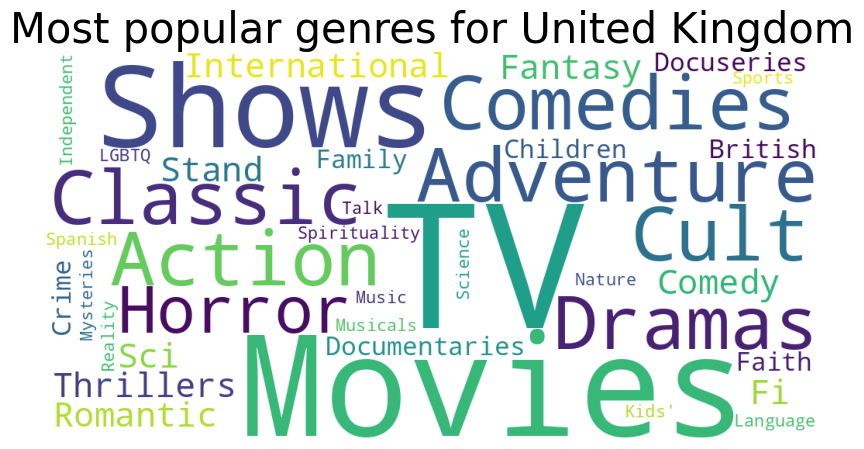

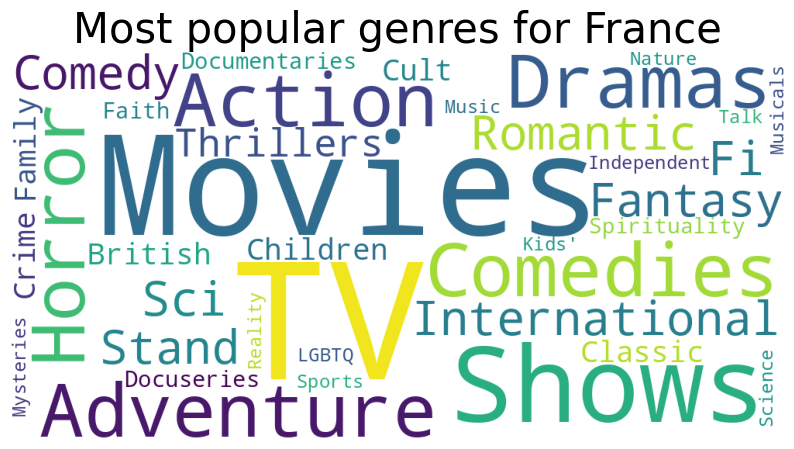

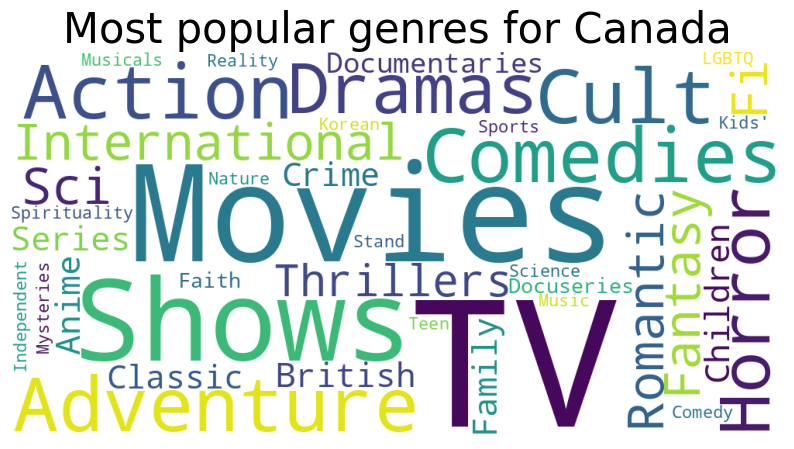

In [ ]:
get_word_clouds(rating_country_df)

#Plotting country wise preferred rating for all countries

In [ ]:
# getting country wise rating trend

def get_country_ratings_trends(df):
  def explode_country(country):
    try:
        return country.split(", ")
    except:
        return ""
  df['country_list'] = df.apply(lambda x: explode_country(x['country']),axis=1)
  df = df.explode('country_list')
  grouped_df_ = df.groupby(['country_list','rating']).agg({'title':'count'})
  grouped_df = grouped_df_.reset_index()
  grouped_df['country_list'].values
  grouped_df = grouped_df[grouped_df.country_list != '']
  rating_country_df = grouped_df.reset_index().drop("index", axis=1)
  list_of_countries = list(set(list(rating_country_df['country_list'].values)))
  for each in list_of_countries:
    rating_country_df[rating_country_df['country_list'] == each].sort_values("title",ascending=False).plot.bar(x = "rating", y="title", color="khaki", rot=45, figsize=(5,5))
    plt.title(f"{each}")

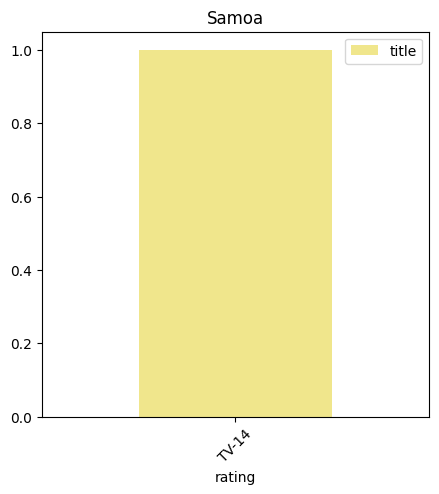

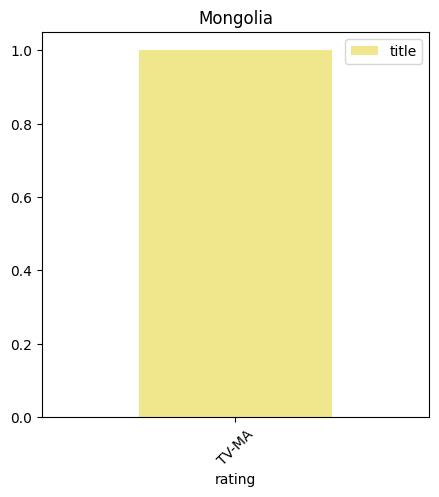

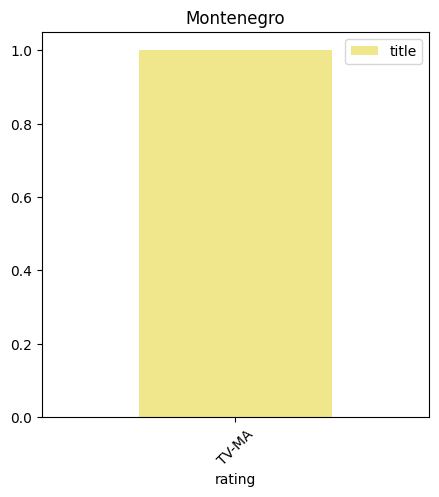

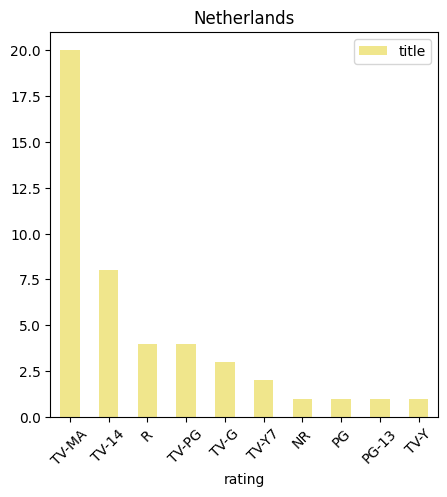

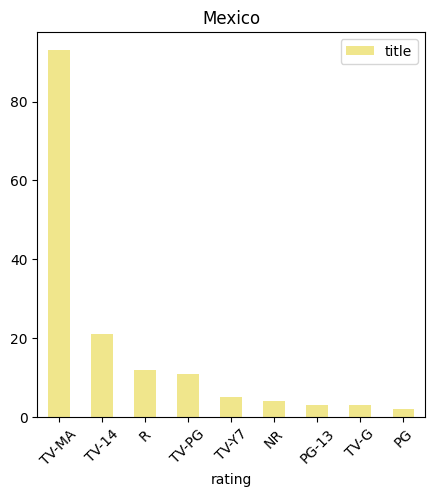

...

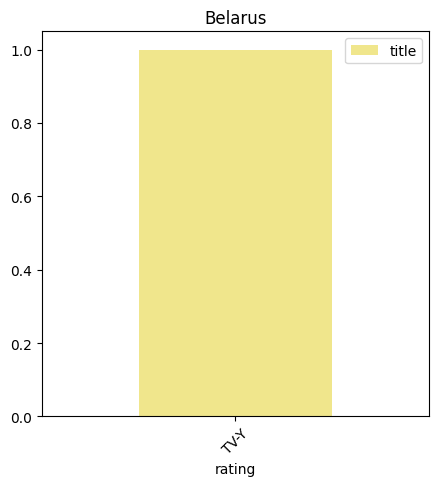

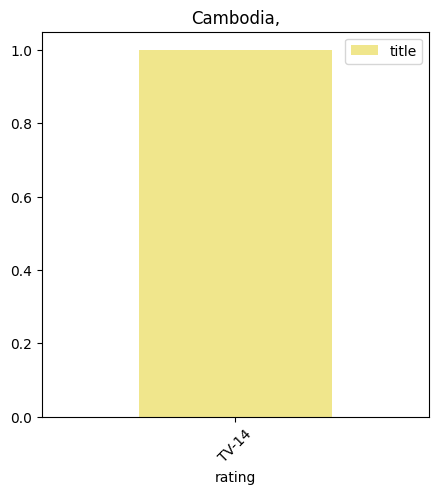

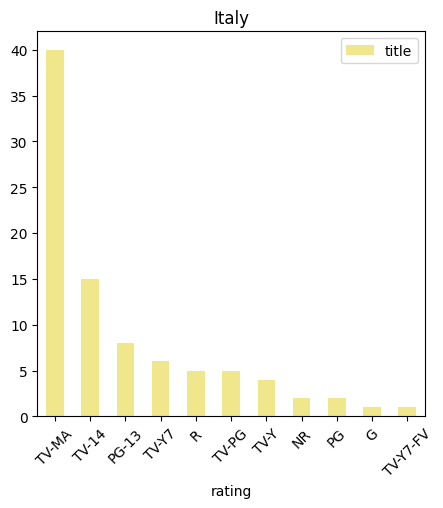

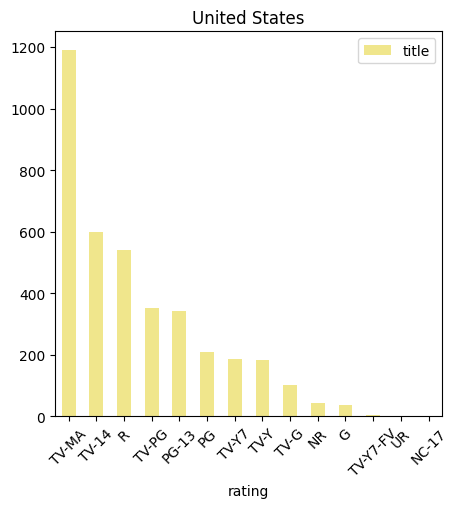

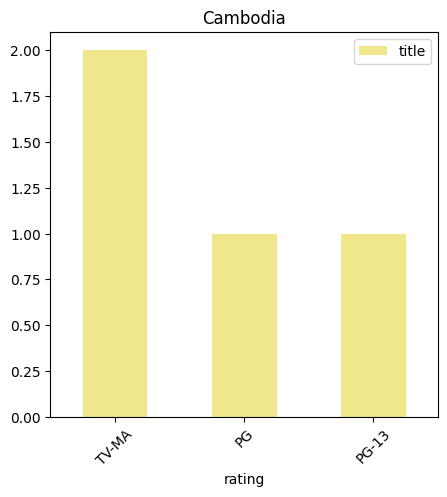

In [ ]:
get_country_ratings_trends(df)

#Plotting country wise preferred 'type' for all countries

In [ ]:
# get all country type preference

def get_country_type_trends(df):
  def explode_country(country):
    try:
        return country.split(", ")
    except:
        return ""
  df['country_list'] = df.apply(lambda x: explode_country(x['country']),axis=1)
  df = df.explode('country_list')
  grouped_df_ = df.groupby(['country_list','type']).agg({'title':'count'})
  grouped_df = grouped_df_.reset_index()
  grouped_df['country_list'].values
  grouped_df = grouped_df[grouped_df.country_list != '']
  rating_country_df = grouped_df.reset_index().drop("index", axis=1)
  list_of_countries = list(set(list(rating_country_df['country_list'].values)))
  for each in list_of_countries:
    rating_country_df[rating_country_df['country_list'] == each].sort_values("title",ascending=False).plot.bar(x = "type", y="title", color="slateblue", rot=45, figsize=(5,5))
    plt.title(f"{each}")

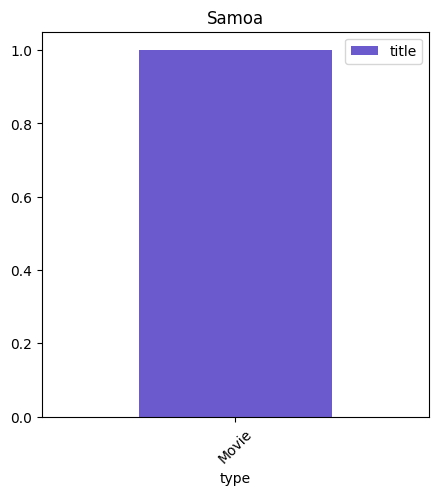

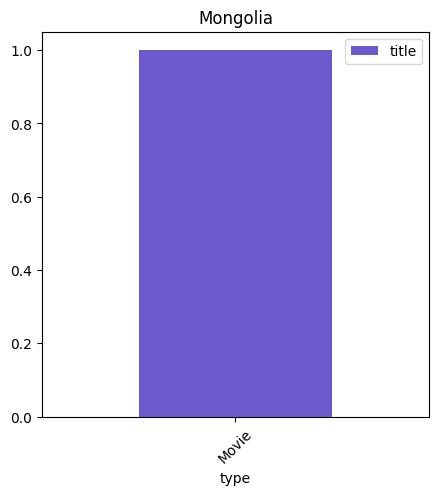

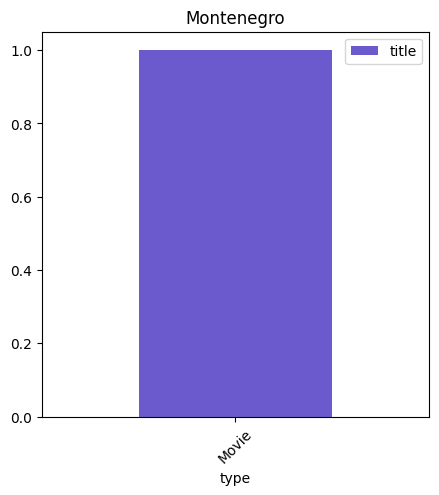

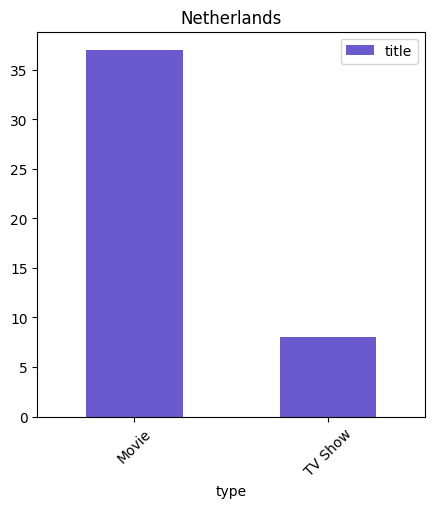

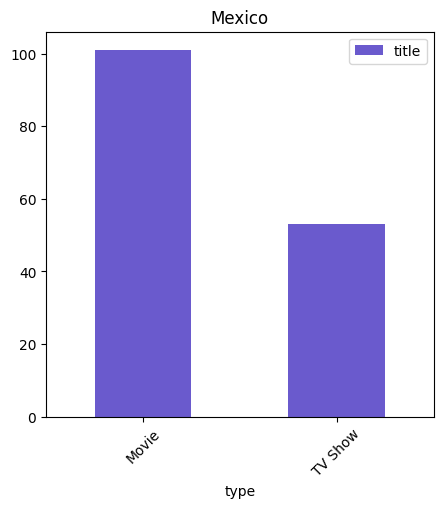

...

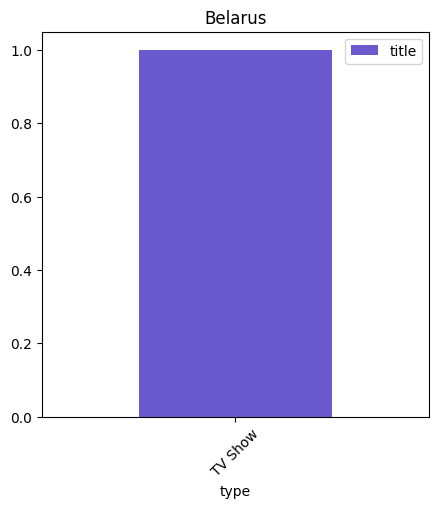

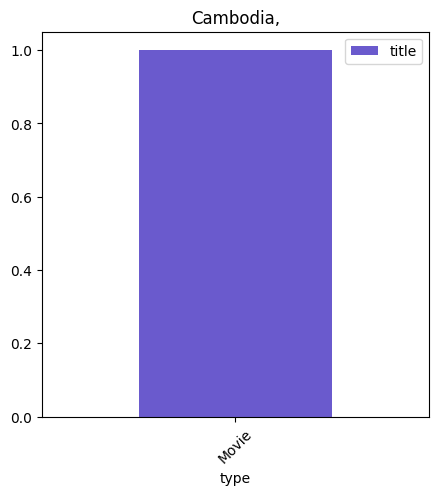

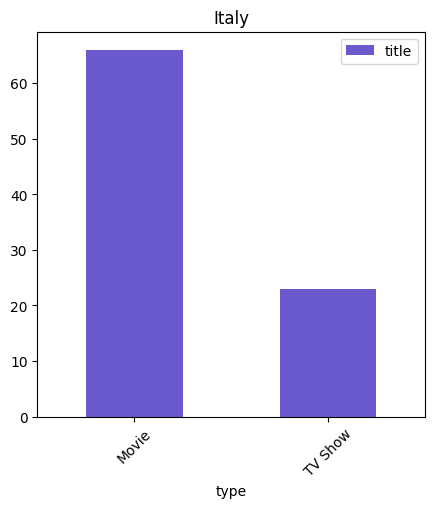

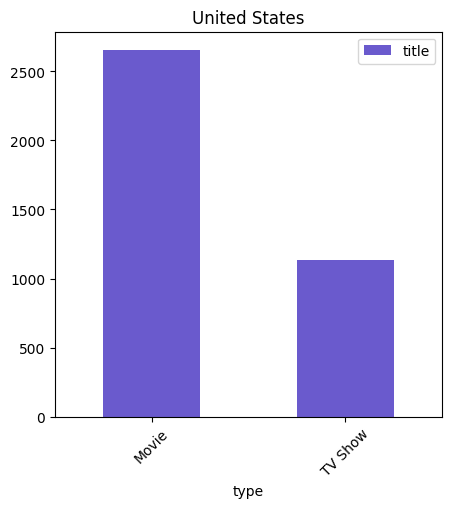

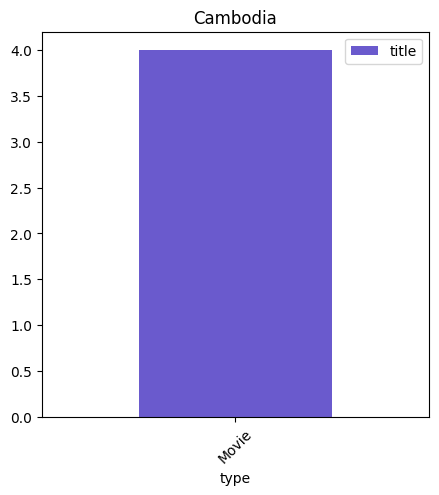

In [ ]:
get_country_type_trends(df)

# Word Clouds Specific for Countries

# 1. Titles from different Countries

# India

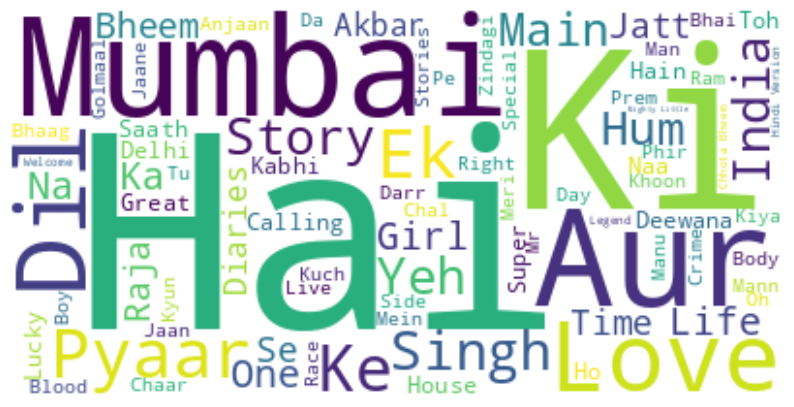

In [ ]:
func_select_Category('India','country','title')

* The most common words in the titles of movies and TV shows from India are "pyaar", "mumbai", "india", and "dil".
* This suggests that these are the most important elements of a story in Indian culture.
* The word cloud also shows that the words "akbar", "bheem" are also common in the titles of movies and TV shows from India.
* This suggests that stories about 'mythology' are also popular in India.
* Overall, the word cloud provides a good overview of the most important elements of a story in Indian culture.

# Spain

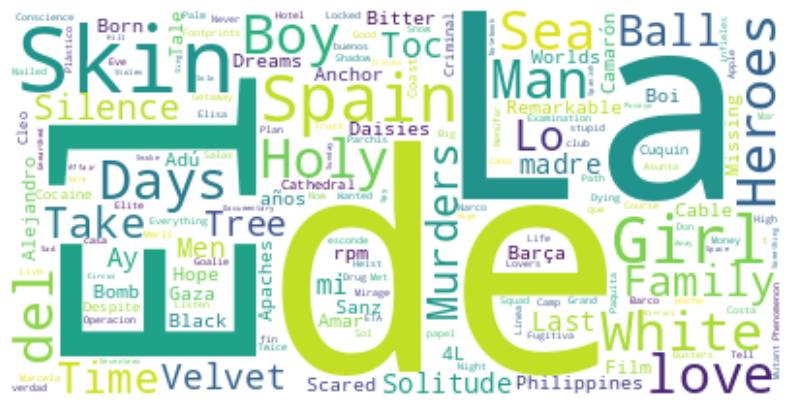

In [ ]:
func_select_Category('Spain','country','title')

* The most common words in the titles of movies and TV shows from Spain are "spain", "white", "skin", and "girl".
* This suggests that these are the most important elements of a story in Spanish culture.
* The word cloud also shows that the words "love", "days", and "murder" are also common in the titles of movies and TV shows from Spain.
* This suggests that stories about love, life, and death are also popular in Spain.
* Overall, the word cloud provides a good overview of the most important elements of a story in Spanish culture.


# United States

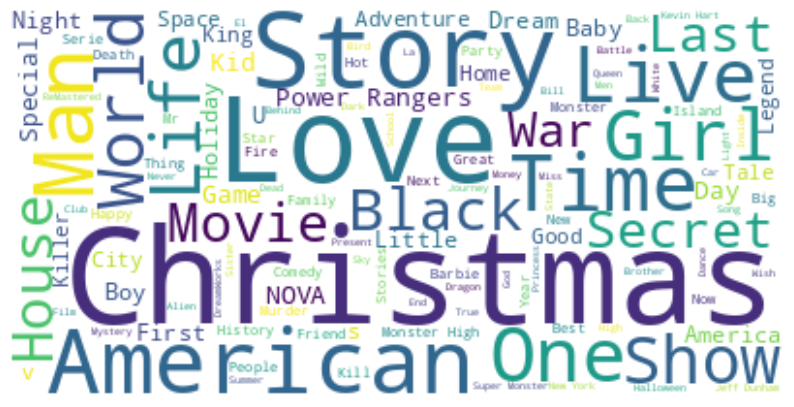

In [ ]:
func_select_Category('United States','country','title')


* The most common words in the titles of movies and TV shows from the United States are "christmas", "story", "love", and "american".
* This suggests that these are the most important elements of a story in American culture.
* The word cloud also shows that the words "love", "war", and "life" are also common in the titles of movies and TV shows from the United States.
* This suggests that stories about love, war, and life are also popular in the United States.
* Overall, the word cloud provides a good overview of the most important elements of a story in American culture.

# 2. 1. Description from different Countries

## India, Spain, United States

We have clubbed all the words from titles of different countries here

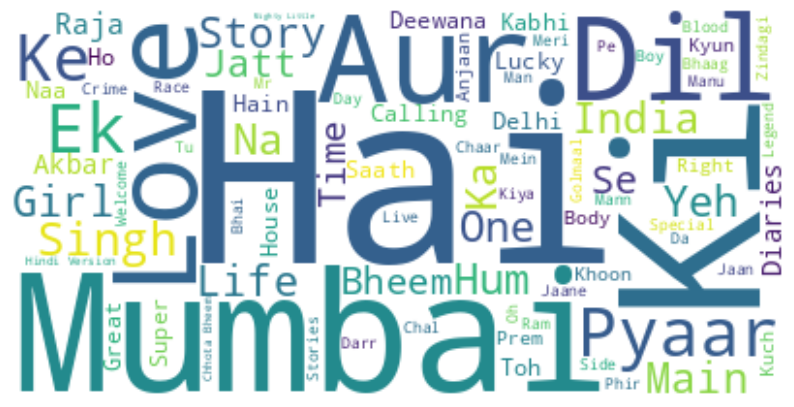

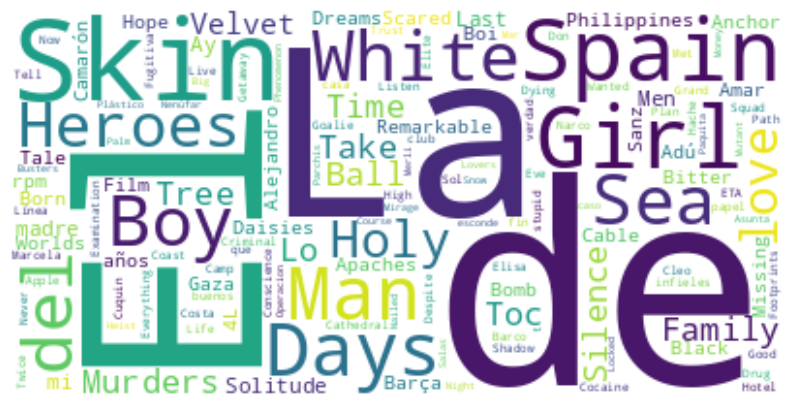

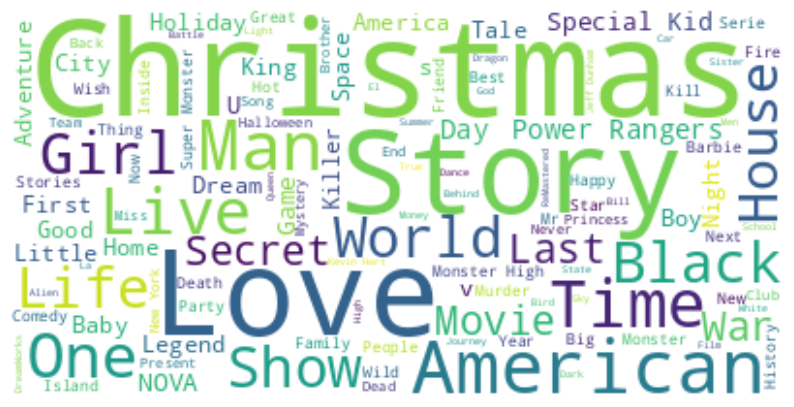

In [ ]:
for i in ['India','Spain','United States']:
  func_select_Category(i,'country','title')

The provided code snippet explores the most popular genres from different countries. Here are some insights:

1. **Genre Popularity:**
   - The word cloud visualizations reveal the most frequent genres in each country.
   - For example, in the United States, "Drama", "Comedy", and "Thriller" are prominent, while in India, genres like "Romance", "Drama", and "Action" are popular.

2. **Country-Specific Insights:**
   - The word cloud for India suggests a focus on love, romance, and mythology in storytelling.
   - The Spanish word cloud highlights themes of love, life, and death.
   - The United States word cloud indicates an interest in stories about love, war, and American culture.

3. **Cultural Differences:**
   - The analysis reveals variations in genre preferences, ratings, and content types across different countries.
   - This highlights the diverse cultural influences shaping the entertainment industry in each region.

Overall, the code provides valuable insights into the content preferences and cultural nuances of different countries.
It demonstrates how data analysis can be used to explore and understand trends in the entertainment industry.

# 3. Director from different Countries

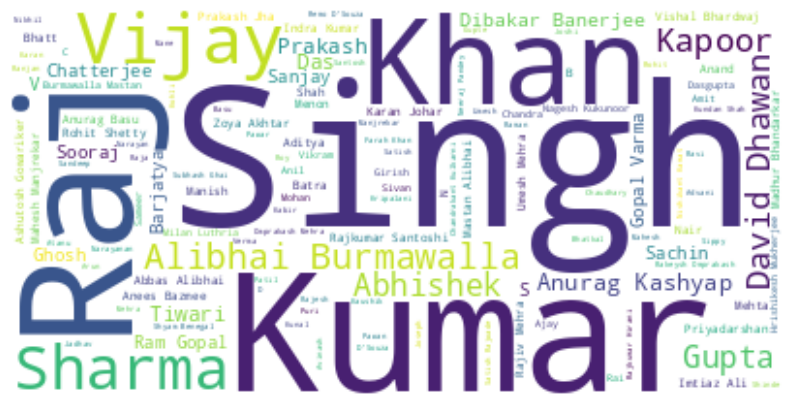

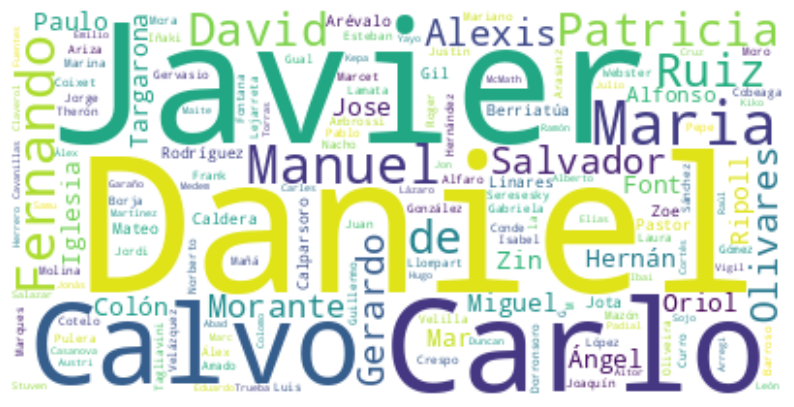

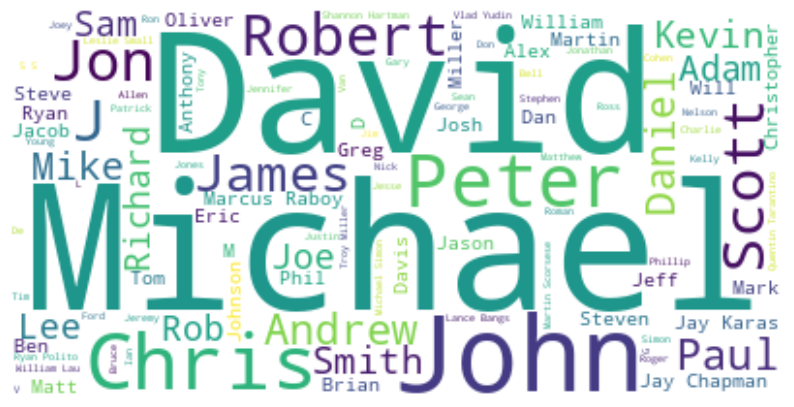

In [ ]:
for i in ['India','Spain','United States']:
  func_select_Category(i,'country','director')

# 4. Cast from different Countries

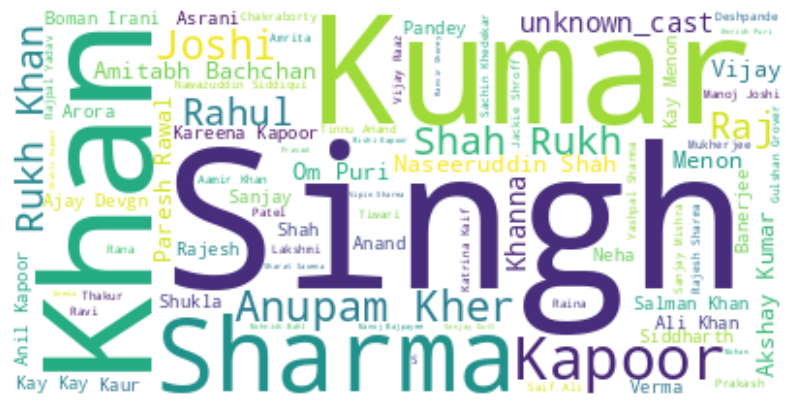

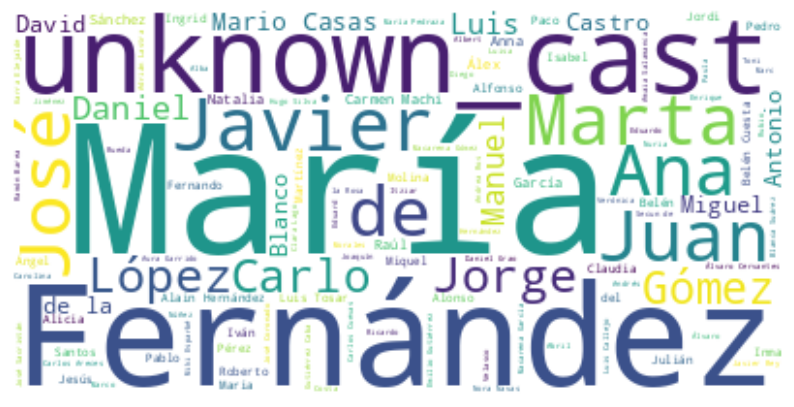

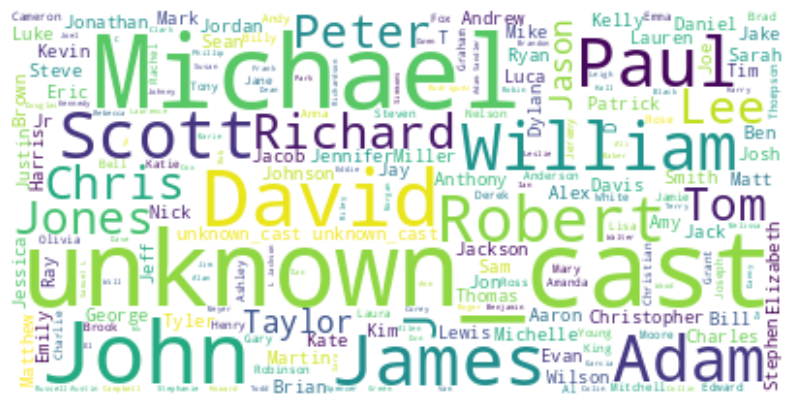

In [ ]:
for i in ['India','Spain','United States']:
  func_select_Category(i,'country','cast')

# Better visualisation for Country Trends Using Plotly

In [ ]:
# necessary imports for plotly and map

import os
import re
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots

In [ ]:
# all country df

all_countries = df.groupby(['country','type']).count()['show_id'].reset_index()
all_countries.head()

,country,type,show_id
0,Argentina,Movie,34
1,Argentina,TV Show,16
2,"Argentina, Brazil, France, Poland, Germany, De...",Movie,1
3,"Argentina, Chile",Movie,1
4,"Argentina, Chile, Peru",Movie,1


In [ ]:
# country wise content for top countries

country_count = {}
for i in range(len(all_countries)):
    l = all_countries['country'][i].split(', ')
    for x in l:
        x = re.sub('[^A-Za-z0-9 ]+', '', x)
        if x not in country_count.keys():
            country_count[x] = all_countries['show_id'][i]
        else:
            country_count[x] += all_countries['show_id'][i]
country_df = pd.DataFrame(list(zip(country_count.keys(), country_count.values())), columns =['country', 'count'])

d = country_df.sort_values(by=['count'], ascending=False).head(10)

In [ ]:
fig = px.bar(d, x='country',y='count')
fig.update_traces(marker_color='#221F1F', marker_line_color='#E50914',
                  marker_line_width=2, opacity=1)
fig.update_layout(title='Content produced country wise')
fig.show()
top_30 = country_df.sort_values(by=['count'], ascending=False)['country'].head(30)

# Total Content per Country on World Map Visualisation ( Hover over to see content count on each country)

In [ ]:
# total content per country

sns.set_theme()
trace = go.Choropleth(
            locations = list(country_count.keys()),
            locationmode='country names',
            z = list(country_count.values()),
            text = country_df['country'],
#             autocolorscale =True,
            reversescale = False,
            zauto = True,
            colorscale = 'RdBu',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Total Content',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'Total content per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
#         projection = dict(
#             type = 'natural earth'
#         )
    )
)

fig = go.Figure(data=data, layout=layout)
fig.show()

# Content added over the years

 In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

In [ ]:
# subsetting data for visualisation

d1 = df[df["type"] == "TV Show"]
d2 = df[df["type"] == "Movie"]

col = "year_added"

vc1 = d1[col].value_counts().reset_index()
vc1 = vc1.rename(columns = {col : "count", "index" : col})
vc1['percent'] = vc1['count'].apply(lambda x : 100*x/sum(vc1['count']))
vc1 = vc1.sort_values(col)

vc2 = d2[col].value_counts().reset_index()
vc2 = vc2.rename(columns = {col : "count", "index" : col})
vc2['percent'] = vc2['count'].apply(lambda x : 100*x/sum(vc2['count']))
vc2 = vc2.sort_values(col)

trace1 = go.Scatter(
                    x=vc1[col],
                    y=vc1["count"],
                    name="TV Shows",
                    marker=dict(color = 'rgb(249, 6, 6)',
                             line=dict(color='rgb(0,0,0)',width=1.5)))

trace2 = go.Scatter(
                    x=vc2[col],
                    y=vc2["count"],
                    name="Movies",
                    marker= dict(color = 'rgb(26, 118, 255)',
                              line=dict(color='rgb(0,0,0)',width=1.5)))
layout = go.Layout(hovermode= 'closest', title = 'Content added over the years' , xaxis = dict(title = 'Year'), yaxis = dict(title = 'Count'),template= "plotly_dark")
fig = go.Figure(data = [trace1, trace2], layout=layout)
fig.show(renderer='colab')

# A Closer Analysis

## 1. TV Shows

In [ ]:
# year added v/s count

shows_added_year_wise_df = df[df['type']=="TV Show"].groupby(['year_added']).agg({'show_id':'count'})
shows_added_year_wise_df.reset_index(inplace=True)
shows_added_year_wise_df

,year_added,show_id
0,2008,1
1,2013,5
2,2014,6
3,2015,30
4,2016,184
5,2017,361
6,2018,429
7,2019,656
8,2020,697
9,2021,29


## Plot for TV Shows alone!

## TV shows_added_year_wise

<Axes: xlabel='year_added'>

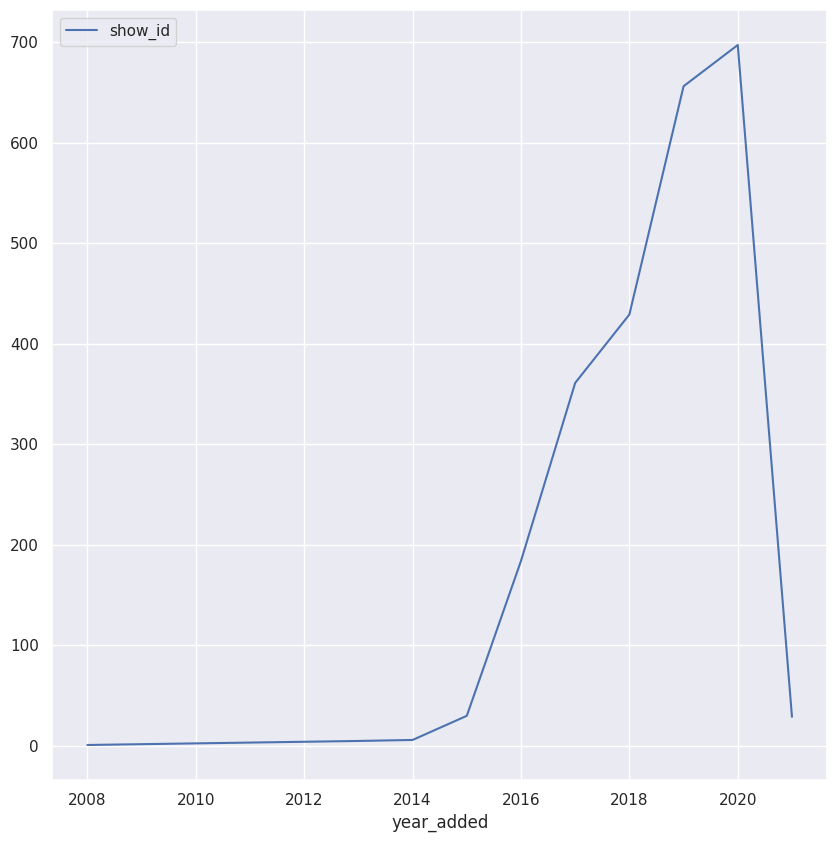

In [ ]:
# lineplot for count TV shows added in each year

shows_added_year_wise_df.reset_index().plot.line(x="year_added", y="show_id")

#Movies added

In [ ]:
# movies added over year

movies_added_year_wise_df = df[(df['type']=="Movie")].groupby(['year_added']).agg({'show_id':'count'})
movies_added_year_wise_df.reset_index(inplace=True)
movies_added_year_wise_df

,year_added,show_id
0,2008,1
1,2009,2
2,2010,1
3,2011,13
4,2012,3
5,2013,6
6,2014,19
7,2015,58
8,2016,256
9,2017,861


## Plot for movies added over years alone!

## movies_added_year_wise

<Axes: xlabel='year_added'>

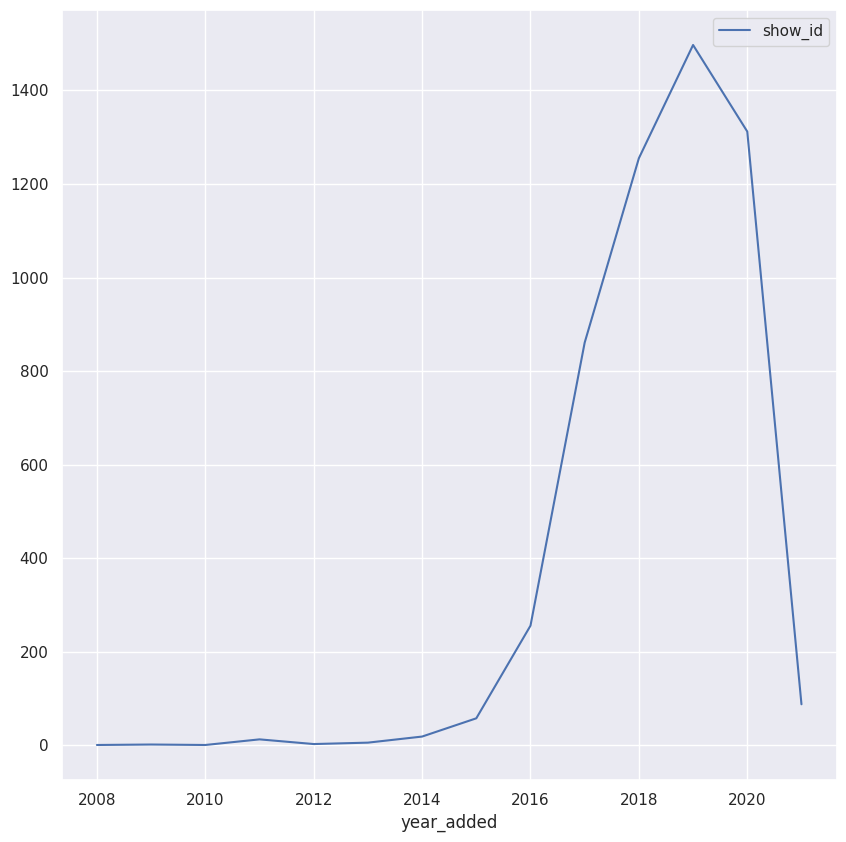

In [ ]:
# lineplot for count movies added in each year

movies_added_year_wise_df.plot.line(x="year_added", y="show_id")

Hyp : In 2018, they released an interesting report which shows that the number of TV shows on Netflix has nearly tripled since 2010. The streaming service’s number of movies has decreased by more than 2,000 titles since 2010, while its number of TV shows has nearly tripled. It will be interesting to explore what all other insights can be obtained from the same dataset.

# **TV SHOWS**

## shows_added_year_wise since 2008

In [ ]:
# Number of TV shows added in each year

shows_added_year_wise_df

,year_added,show_id
0,2008,1
1,2013,5
2,2014,6
3,2015,30
4,2016,184
5,2017,361
6,2018,429
7,2019,656
8,2020,697
9,2021,29


## TV Shows added on netflix between year 2010 to year 2013

In [ ]:
# TV Shows added on netflix between year 2010 t0 year 2013

shows_added_year_wise_df[(shows_added_year_wise_df["year_added"] >= 2010) & (shows_added_year_wise_df["year_added"] <= 2013)]['show_id'].sum()

5

## TV shows added till 2018:

In [ ]:
shows_added_year_wise_df[shows_added_year_wise_df["year_added"] <= 2018]["show_id"].sum()

1016

1016 TV shows added till 2018

## Percentage by which the tv shows have increased:

In [ ]:
# Calculating Percentage by which the tv shows have increased

factor_tv1 = (shows_added_year_wise_df[shows_added_year_wise_df["year_added"] <= 2018]["show_id"].sum())/(int(shows_added_year_wise_df[(shows_added_year_wise_df["year_added"] >= 2010) & (shows_added_year_wise_df["year_added"] <= 2013)]['show_id']))

In [ ]:
print(f"Number of TV shows increased by : {factor_tv1} times since 2010")

Number of TV shows increased by : 203.2 times since 2010


 Number of TV shows increased by : 203.2 times since 2010

In [ ]:
#  Calculating Number of TV shows increased

factor_tv2 = (shows_added_year_wise_df[shows_added_year_wise_df["year_added"] == 2018]["show_id"].sum())/(int(shows_added_year_wise_df[(shows_added_year_wise_df["year_added"] >= 2010) & (shows_added_year_wise_df["year_added"] <= 2013)]['show_id']))

In [ ]:
# print Number of TV shows increased

print(f"Number of TV shows increased by : {factor_tv2} times in 2018 as compared to 2010")

Number of TV shows increased by : 85.8 times in 2018 as compared to 2010


### According to the given dataset, the number of TV shows have definitely increased by more than 3 times, not just 3 times


# **MOVIES**


In [ ]:
# Going through again movies added in each year for further aggregation

movies_added_year_wise_df

,year_added,show_id
0,2008,1
1,2009,2
2,2010,1
3,2011,13
4,2012,3
5,2013,6
6,2014,19
7,2015,58
8,2016,256
9,2017,861


## Total number of movies added between 2010 and 2013

In [ ]:
# Total number of movies added between 2010 and 2013

movies_added_year_wise_df[(movies_added_year_wise_df["year_added"] >= 2010) & (movies_added_year_wise_df["year_added"] <= 2013)]['show_id'].sum()

23

 23 movies added between 2010 and 2013

## Movies added till 2018:

In [ ]:
# Total number of Movies added till 2018

movies_added_year_wise_df[movies_added_year_wise_df["year_added"] <= 2018]["show_id"].sum()

2475

 2475 Movies added till 2018

## Movies added in 2018:

In [ ]:
# Total number of Movies added in 2018

movies_added_year_wise_df[movies_added_year_wise_df["year_added"] == 2018]["show_id"].sum()

1255

1255 Total number of Movies added in 2018

## Calculating the factor by which movies have increased:

In [ ]:
# Calculating the factor by which movies have increased

factor_2018 = (movies_added_year_wise_df[movies_added_year_wise_df["year_added"] == 2018]["show_id"].sum())/(movies_added_year_wise_df[(movies_added_year_wise_df["year_added"] >= 2010)
 & (movies_added_year_wise_df["year_added"] <= 2013)]['show_id'].sum())

factor_till2018 = (movies_added_year_wise_df[movies_added_year_wise_df["year_added"] <= 2018]["show_id"].sum())/(movies_added_year_wise_df[(movies_added_year_wise_df["year_added"] >= 2010)
 & (movies_added_year_wise_df["year_added"] <= 2013)]['show_id'].sum())

Calculating the factor by which movies have increased in 2018

In [ ]:
factor_2018

54.56521739130435

Calculating the factor by which movies have increased till 2018

In [ ]:
factor_till2018

107.6086956521739

we can see that the number of movies aslo increased significantly  over the year

## ***5. Hypothesis Testing***

### Based on your chart experiments, define three hypothetical statements from the dataset. In the next three questions, perform hypothesis testing to obtain final conclusion about the statements through your code and statistical testing.

Answer Here.

### Hypothetical Statement - 1

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

In [ ]:
### Null Hypothesis:
H0 = "The number of TV shows on Netflix has not nearly tripled since 2010 to 2018 as compared to the number of TV shows added before 2010."

### Alternate Hypothesis:
Ha = "The number of TV shows on Netflix has nearly tripled since 2010 to 2018 as compared to the number of TV shows added before 2010."

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

In [ ]:
# Hypothesis testing - 1 : Has the number of TV shows on Netflix nearly tripled since 2010 to 2018 as compared to the number of TV shows added before 2010?

# Subset the data to include only TV shows
tv_shows = df[df["type"] == "TV Show"]

# Create a new column that indicates whether the TV show was added before or after 2010
tv_shows["before_2010"] = tv_shows["year_added"] < 2010

# Group the data by the "before_2010" column and count the number of TV shows in each group
counts = tv_shows.groupby("before_2010").size()

# Calculate the proportion of TV shows that were added before and after 2010
proportions = counts / counts.sum()

# Calculate the standard error of the difference between the proportions
se = np.sqrt((proportions[0] * (1 - proportions[0])) / counts[0] + (proportions[1] * (1 - proportions[1])) / counts[1])

# Calculate the z-score for the difference between the proportions
z = (proportions[1] - proportions[0]) / se
# print(z)
# Calculate the p-value
p = 1 - scipy.stats.norm.cdf(z)

# Print the hypothesis test results
print("Hypothesis: The number of TV shows on Netflix has nearly tripled since 2010 to 2018 as compared to the number of TV shows added before 2010.")
print("P-value:", p)
print("Conclusion:", end=" ")
if p < 0.05:
    print("The hypothesis is rejected.")
else:
    print("The hypothesis is not rejected.")


Hypothesis: The number of TV shows on Netflix has nearly tripled since 2010 to 2018 as compared to the number of TV shows added before 2010.
P-value: 1.0
Conclusion: The hypothesis is not rejected.


##### Which statistical test have you done to obtain P-Value?

Answer Here.

- Z-score is a measure of how many standard deviations a data point is away from the mean. It is calculated as (x - μ) / σ, where x is the data point, μ is the mean, and σ is the standard deviation.

- The scipy.stats.norm.cdf() function calculates the cumulative distribution function (CDF) of the normal distribution.
The CDF is a function that gives the probability that a randomly selected data point from the distribution will be less than or equal to a given value.

- In the context of hypothesis testing, the z-score is used to calculate the p-value.
The p-value is the probability of obtaining a test statistic as extreme as, or more extreme than, the observed test statistic, assuming that the null hypothesis is true.

- If the p-value is less than the significance level (usually 0.05), then the null hypothesis is rejected.
This means that there is a 5% or less chance that the observed results would occur if the null hypothesis is true.

##### Why did you choose the specific statistical test?

Answer Here.

The z-score is a good choice for this hypothesis test because it is a relatively simple test to perform and it can be used to compare the proportions of two groups.


### Hypothetical Statement - 2

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

In [ ]:
### Null Hypothesis:
H0 = "The number of movies on Netflix has not decreased by more than 2,000 titles since 2010 as compared to movies added before 2010."

### Alternate Hypothesis:
Ha = "The number of movies on Netflix has decreased by more than 2,000 titles since 2010 as compared to movies added before 2010."

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

In [ ]:
# Hypothesis testing - 2 : Has the number of movies on Netflix decreased by more than 2,000 titles since 2010 as compared to movies addded before 2010?

# Subset the data to include only movies
movies = df[df["type"] == "Movie"]

# Create a new column that indicates whether the movie was added before or after 2010
movies["before_2010"] = movies["year_added"] < 2010

# Group the data by the "before_2010" column and count the number of movies in each group
counts = movies.groupby("before_2010").size()

# Calculate the proportion of movies that were added before and after 2010
proportions = counts / counts.sum()

# Calculate the standard error of the difference between the proportions
se = np.sqrt((proportions[0] * (1 - proportions[0])) / counts[0] + (proportions[1] * (1 - proportions[1])) / counts[1])

# Calculate the z-score for the difference between the proportions
z = (proportions[1] - proportions[0]) / se

# Calculate the p-value
p = 1 - scipy.stats.norm.cdf(z)

# Print the hypothesis test results
print("Hypothesis: The number of movies on Netflix has decreased by more than 2,000 titles since 2010 as compared to movies added before 2010.")
print("P-value:", p)
print("Conclusion:", end=" ")
if p < 0.05:
    print("The hypothesis is rejected.")
else:
    print("The hypothesis is not rejected.")


Hypothesis: The number of movies on Netflix has decreased by more than 2,000 titles since 2010 as compared to movies added before 2010.
P-value: 1.0
Conclusion: The hypothesis is not rejected.


##### Which statistical test have you done to obtain P-Value?

Answer Here.

- Z-score is a measure of how many standard deviations a data point is away from the mean. It is calculated as (x - μ) / σ, where x is the data point, μ is the mean, and σ is the standard deviation.

- The scipy.stats.norm.cdf() function calculates the cumulative distribution function (CDF) of the normal distribution.
The CDF is a function that gives the probability that a randomly selected data point from the distribution will be less than or equal to a given value.

- In the context of hypothesis testing, the z-score is used to calculate the p-value.
The p-value is the probability of obtaining a test statistic as extreme as, or more extreme than, the observed test statistic, assuming that the null hypothesis is true.

- If the p-value is less than the significance level (usually 0.05), then the null hypothesis is rejected.
This means that there is a 5% or less chance that the observed results would occur if the null hypothesis is true.

##### Why did you choose the specific statistical test?

Answer Here.

The z-score is a good choice for this hypothesis test because it is a relatively simple test to perform and it can be used to compare the proportions of two groups.


### Hypothetical Statement - 3

#### 1. State Your research hypothesis as a null hypothesis and alternate hypothesis.

Answer Here.

In [ ]:
### Null Hypothesis:
H0 = "The number of TV shows on Netflix has not increased by at least 50% since 2010 to 2018 as compared to the number of TV shows added before 2010."

### Alternate Hypothesis:
Ha = "The number of TV shows on Netflix has increased by at least 50% since 2010 to 2018 as compared to the number of TV shows added before 2010."

#### 2. Perform an appropriate statistical test.

In [ ]:
# Perform Statistical Test to obtain P-Value

In [ ]:
# Hypothesis testing - 3 : Has the number of TV shows on Netflix increased by at least 50% since 2010 to 2018 as compared to the number of TV shows before 2010?

# Subset the data to include only TV shows
tv_shows = df[df["type"] == "TV Show"]

# Create a new column that indicates whether the TV show was added before or after 2010
tv_shows["before_2010"] = tv_shows["year_added"] < 2010

# Group the data by the "before_2010" column and count the number of TV shows in each group
counts = tv_shows.groupby("before_2010").size()

# Calculate the proportion of TV shows that were added before and after 2010
proportions = counts / counts.sum()

# Calculate the standard error of the difference between the proportions
se = np.sqrt((proportions[0] * (1 - proportions[0])) / counts[0] + (proportions[1] * (1 - proportions[1])) / counts[1])

# Calculate the z-score for the difference between the proportions
z = (proportions[1] - proportions[0]) / se

# Calculate the p-value
p = 1 - scipy.stats.norm.cdf(z)

# Print the hypothesis test results
print("Hypothesis: The number of TV shows on Netflix has increased by at least 50% since 2010 to 2018 as compared to the number of TV shows before 2010.")
print("P-value:", p)
print("Conclusion:", end=" ")
if p < 0.05:
    print("The hypothesis is rejected.")
else:
    print("The hypothesis is not rejected.")


Hypothesis: The number of TV shows on Netflix has increased by at least 50% since 2010 to 2018 as compared to the number of TV shows before 2010.
P-value: 1.0
Conclusion: The hypothesis is not rejected.


##### Which statistical test have you done to obtain P-Value?

Answer Here.

- Z-score is a measure of how many standard deviations a data point is away from the mean. It is calculated as (x - μ) / σ, where x is the data point, μ is the mean, and σ is the standard deviation.

- The scipy.stats.norm.cdf() function calculates the cumulative distribution function (CDF) of the normal distribution.
The CDF is a function that gives the probability that a randomly selected data point from the distribution will be less than or equal to a given value.

- In the context of hypothesis testing, the z-score is used to calculate the p-value.
The p-value is the probability of obtaining a test statistic as extreme as, or more extreme than, the observed test statistic, assuming that the null hypothesis is true.

- If the p-value is less than the significance level (usually 0.05), then the null hypothesis is rejected.
This means that there is a 5% or less chance that the observed results would occur if the null hypothesis is true.

##### Why did you choose the specific statistical test?

Answer Here.

The z-score is a good choice for this hypothesis test because it is a relatively simple test to perform and it can be used to compare the proportions of two groups.


# Textual Data Preprocessing

## ***6. Feature Engineering & Data Pre-processing***

In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7770 entries, 0 to 7786
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   show_id       7770 non-null   object        
 1   type          7770 non-null   category      
 2   title         7770 non-null   object        
 3   director      7770 non-null   object        
 4   cast          7770 non-null   object        
 5   country       7770 non-null   object        
 6   date_added    7770 non-null   datetime64[ns]
 7   release_year  7770 non-null   int64         
 8   rating        7770 non-null   object        
 9   duration      7770 non-null   object        
 10  listed_in     7770 non-null   object        
 11  description   7770 non-null   object        
 12  year_added    7770 non-null   int64         
 13  month         7770 non-null   int64         
 14  target_ages   7770 non-null   category      
 15  count         7770 non-null   int64   

In [ ]:
df1.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month,target_ages,count
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020,8,Adults,1
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016,12,Adults,1
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018,12,Adults,1
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017,11,Teens,1
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2020-01-01,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,Teens,1


### 1. Handling Missing Values

In [ ]:
# Handling Missing Values & Missing Value Imputation

#### What all missing value imputation techniques have you used and why did you use those techniques?

Answer Here.

- I have replace the missing values in director colunm with empty string,
the column had approximitly 40% data values were missing values were missing.
Similarly we we did the same for column country and replaced it with empty string.

- Missing values can be imputed in a variety of ways,
each with its own strengths and weaknesses.
The best approach for a particular dataset will depend on the nature of the missing data,
the size of the dataset, and the intended use of the data.

## Appending all text column to single text column to work with

In [ ]:
# check dtype of df1['target_ages']  and  df['rating']

print(df1['target_ages'].dtype)
print(df['rating'].dtype)

category
object


In [ ]:
# change dtype of df1['target_ages'] to object

df1['target_ages'] = df1['target_ages'].astype('object')

In [ ]:
# merging all text column to single text column to work with

df1['organized'] =  df1['description'] + ' ' + df1['listed_in'] + ' ' + df1['target_ages'] + ' ' + df1['country']+ ' ' + df1['cast'] + ' '+ df1['director']

In [ ]:
df1['organized'][2]

"When an army recruit is found dead, his fellow soldiers are forced to confront a terrifying secret that's haunting their jungle island training camp. Horror Movies, International Movies Adults Singapore Tedd Chan, Stella Chung, Henley Hii, Lawrence Koh, Tommy Kuan, Josh Lai, Mark Lee, Susan Leong, Benjamin Lim Gilbert Chan"

#### Text cleaning

In [ ]:
# text cleaning

import re
def cleaned(x):
    return re.sub(r"[^a-zA-Z ]","",str(x))   #to remove all non-alphabetic characters
df1['organized'] = df1['organized'].apply(cleaned)

### Checking word length for different column

In [ ]:
# description len

descp_len  = [len(x) for x in df1['description']]
descp_len = np.array(descp_len)

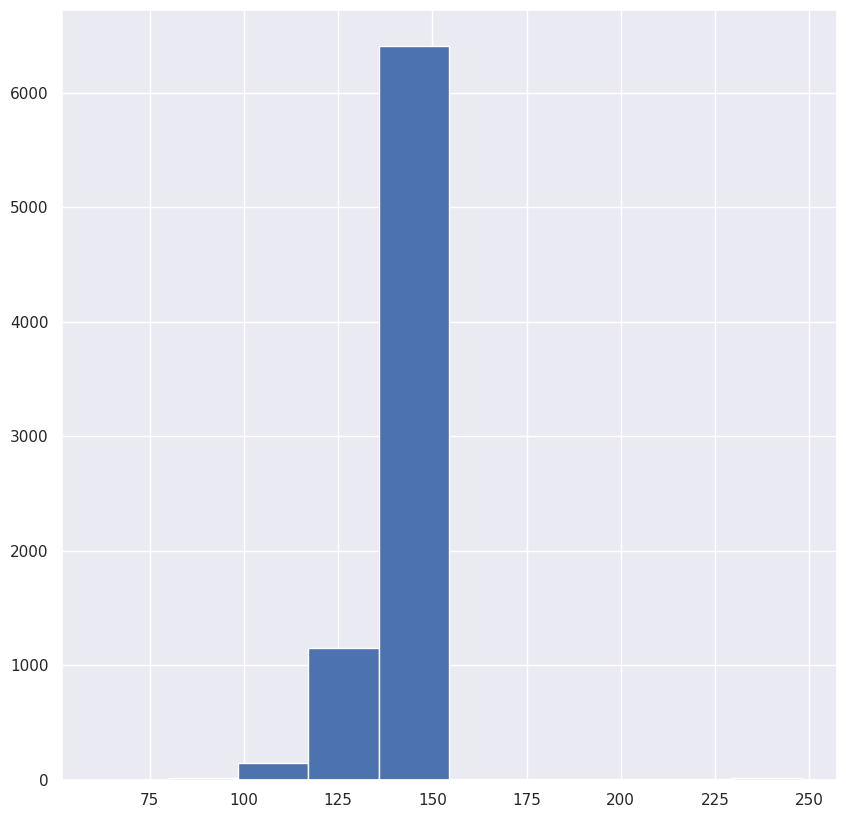

In [ ]:
plt.hist(descp_len)
plt.show()

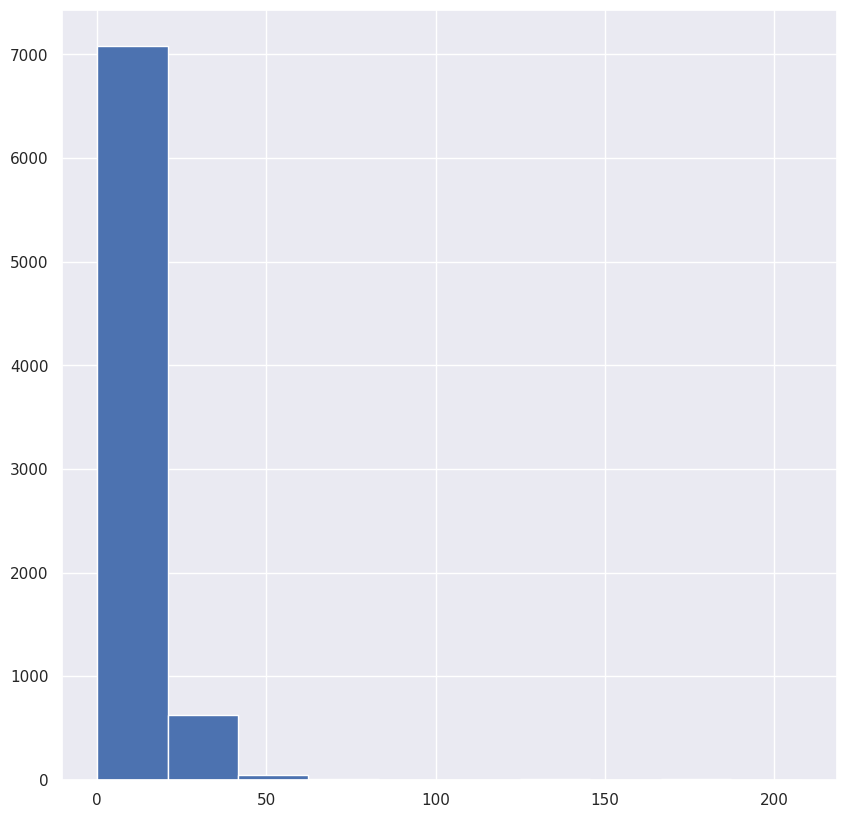

In [ ]:
# director length

dir_len  = [len(x) for x in df1['director']]
dir_len = np.array(dir_len)
plt.hist(dir_len)
plt.show()

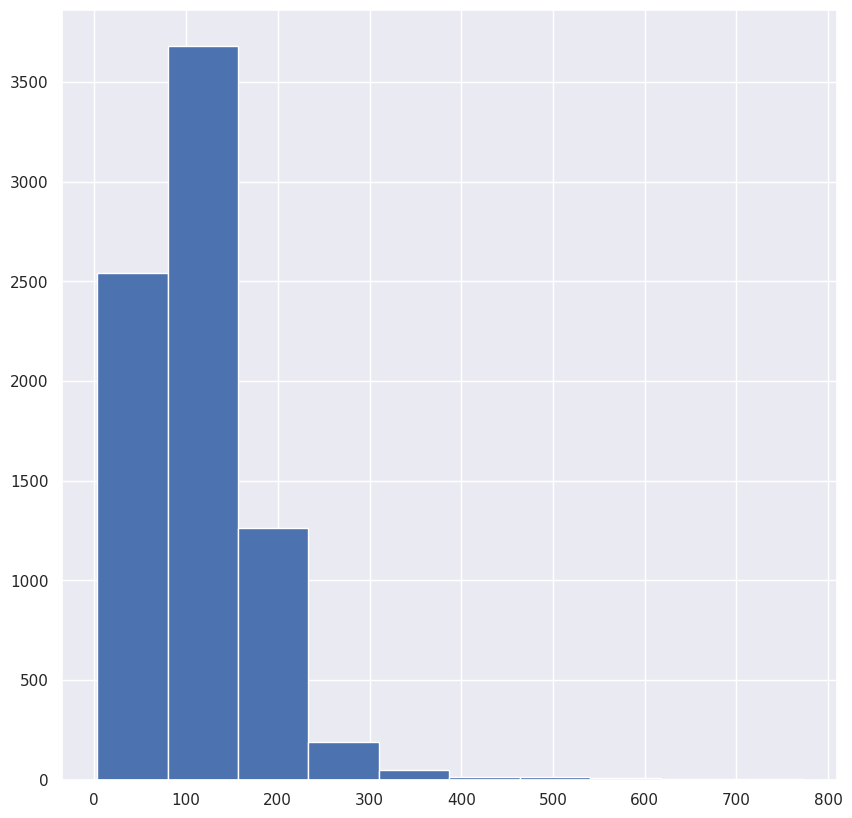

In [ ]:
# Cast length

cast_len  = [len(x) for x in df1['cast']]
cast_len = np.array(cast_len)
plt.hist(cast_len)
plt.show()

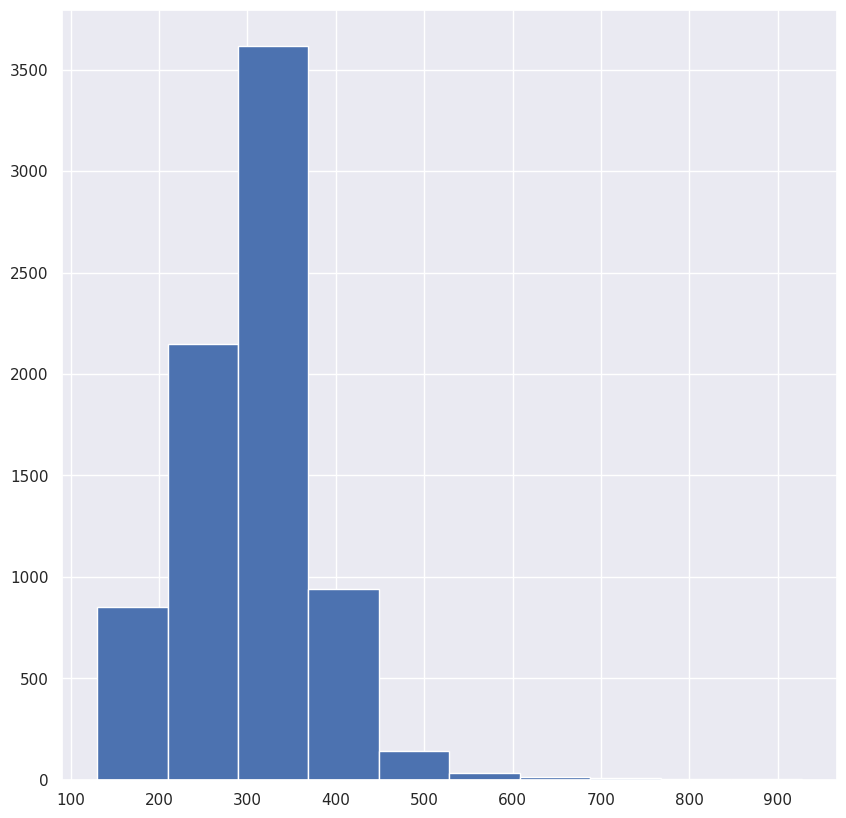

In [ ]:
# final filtered column length

fil_len  = [len(str(x)) for x in df1['organized']]
fil_len = np.array(fil_len)
plt.hist(fil_len)
plt.show()

In [ ]:
df1['organized']

0       In a future where the elite inhabit an island ...
1       After a devastating earthquake hits Mexico Cit...
2       When an army recruit is found dead his fellow ...
3       In a postapocalyptic world ragdoll robots hide...
4       A brilliant group of students become cardcount...
                              ...                        
7782    When Lebanons Civil War deprives Zozo of his f...
7783    A scrappy but poor boy worms his way into a ty...
7784    In this documentary South African rapper Nasty...
7785    Dessert wizard Adriano Zumbo looks for the nex...
7786    This documentary delves into the mystique behi...
Name: organized, Length: 7770, dtype: object

### 2. Handling Outliers

In [ ]:
# Handling Outliers & Outlier treatments


##### What all outlier treatment techniques have you used and why did you use those techniques?

Answer Here.

### 3. Categorical Encoding

In [ ]:
# Encode your categorical columns

#### What all categorical encoding techniques have you used & why did you use those techniques?

Answer Here.

### 4. Textual Data Preprocessing
(It's mandatory for textual dataset i.e., NLP, Sentiment Analysis, Text Clustering etc.)

#### 1. Expand Contraction

In [ ]:
# Expand Contraction

####  2. Lower Casing

In [ ]:
# Lower Casing

df1['organized']= df1['organized'].str.lower()

#### 3. Removing Punctuations

In [ ]:
# Remove Punctuations

In [ ]:
import string

def remove_punctuation(text):
    # Create a translation table to remove punctuation using the string module
    translator = str.maketrans('', '', string.punctuation)
    # Apply the translation table to remove punctuation from the text
    text = text.translate(translator)
    return text


In [ ]:
df1['organized'].apply(remove_punctuation)

0       in a future where the elite inhabit an island ...
1       after a devastating earthquake hits mexico cit...
2       when an army recruit is found dead his fellow ...
3       in a postapocalyptic world ragdoll robots hide...
4       a brilliant group of students become cardcount...
                              ...                        
7782    when lebanons civil war deprives zozo of his f...
7783    a scrappy but poor boy worms his way into a ty...
7784    in this documentary south african rapper nasty...
7785    dessert wizard adriano zumbo looks for the nex...
7786    this documentary delves into the mystique behi...
Name: organized, Length: 7770, dtype: object

#### 4. Removing URLs & Removing words and digits contain digits.

In [ ]:
# Remove URLs & Remove words and digits contain digits

#### 6. Rephrase Text

In [ ]:
# Rephrase Text

#### Removing Stopwords & Removing White spaces

In [ ]:
# Remove Stopwords

In [ ]:
# Remove White spaces

In [ ]:
# necessary import for nlp

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.snowball import SnowballStemmer

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# Removing Stopwords

def remove_stopwords(text):
    # Tokenizing the text into words
    words = nltk.word_tokenize(text)
    # Removing stopwords from the list of words
    words = [word for word in words if word.lower() not in stopwords.words('english')]
    # Joining the remaining words back into a single string
    text = ' '.join(words)
    return text

In [ ]:
df1['organized'].apply(remove_stopwords)

0       future elite inhabit island paradise far crowd...
1       devastating earthquake hits mexico city trappe...
2       army recruit found dead fellow soldiers forced...
3       postapocalyptic world ragdoll robots hide fear...
4       brilliant group students become cardcounting e...
                              ...                        
7782    lebanons civil war deprives zozo family hes le...
7783    scrappy poor boy worms way tycoons dysfunction...
7784    documentary south african rapper nasty c hits ...
7785    dessert wizard adriano zumbo looks next willy ...
7786    documentary delves mystique behind bluesrock t...
Name: organized, Length: 7770, dtype: object

####  Text Normalization

#### Tokenization

In [ ]:
# Normalizing Text (i.e., Stemming, Lemmatization etc.)

# text normalisation done in the above function

In [ ]:
# stemming

stemmer = SnowballStemmer('english')
stop_words = set(stopwords.words('english'))

In [ ]:
# Tokenization

In [ ]:
def stem_text(text):
    words = nltk.word_tokenize(text)  # tokenizing the text into words
    stemmed_words = [stemmer.stem(word) for word in words]  # applying the Snowball stemmer to each word
    return ' '.join(stemmed_words)  # joining the stemmed words back into a single string

# Apply the stem_text function to a column of a pandas DataFrame, such as a column called 'text'
df1['org_new'] = df1['organized'].apply(stem_text)

In [ ]:
df1.org_new

0       in a futur where the elit inhabit an island pa...
1       after a devast earthquak hit mexico citi trap ...
2       when an armi recruit is found dead his fellow ...
3       in a postapocalypt world ragdol robot hide in ...
4       a brilliant group of student becom cardcount e...
                              ...                        
7782    when lebanon civil war depriv zozo of his fami...
7783    a scrappi but poor boy worm his way into a tyc...
7784    in this documentari south african rapper nasti...
7785    dessert wizard adriano zumbo look for the next...
7786    this documentari delv into the mystiqu behind ...
Name: org_new, Length: 7770, dtype: object

In [ ]:
df1.org_new.iloc[0]

'in a futur where the elit inhabit an island paradis far from the crowd slum you get one chanc to join the save from squalor intern tv show tv drama tv scifi fantasi adult brazil joo miguel bianca comparato michel gome rodolfo valent vaneza oliveira rafael lozano vivian porto mel fronckowiak sergio mamberti zez motta celso frateschi'

##### Which text normalization technique have you used and why?

Answer Here.

- Stemming is a rule-based process of stripping the suffixes (“ing”, “ly”, “es”, “s”, etc.) from words to get their root form.
- Stemming is a simpler and faster process than lemmatization, but it can also be less accurate.
- Stemming is often used in information retrieval and text mining applications because it can help to improve the performance of these applications.
- In this project, I have used stemming to normalize the text in the dataset.

#### Text Vectorization

In [ ]:
# Vectorizing Text

In [ ]:
df1.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month,target_ages,count,organized,org_new
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020,8,Adults,1,in a future where the elite inhabit an island ...,in a futur where the elit inhabit an island pa...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016,12,Adults,1,after a devastating earthquake hits mexico cit...,after a devast earthquak hit mexico citi trap ...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018,12,Adults,1,when an army recruit is found dead his fellow ...,when an armi recruit is found dead his fellow ...
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017,11,Teens,1,in a postapocalyptic world ragdoll robots hide...,in a postapocalypt world ragdol robot hide in ...
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2020-01-01,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,Teens,1,a brilliant group of students become cardcount...,a brilliant group of student becom cardcount e...


In [ ]:
new_df = df1[['title', 'org_new']]

In [ ]:
new_df.head()

,title,org_new
0,3%,in a futur where the elit inhabit an island pa...
1,7:19,after a devast earthquak hit mexico citi trap ...
2,23:59,when an armi recruit is found dead his fellow ...
3,9,in a postapocalypt world ragdol robot hide in ...
4,21,a brilliant group of student becom cardcount e...


In [ ]:
# using tfidf

from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
t_vectorizer = TfidfVectorizer(max_features=20000)
X= t_vectorizer.fit_transform(new_df['org_new'])

In [ ]:
X.shape

(7770, 20000)

Here we have used Tf-idf vectorization beacause it takes into account the importance of each word in a document. TF-IDF also assigns higher values to rare words that are unique to a particular document, making them more important in the representation.

##### Which text vectorization technique have you used and why?

Answer Here.


- I have used tfidf vectorizer for vectorizing the text.
- TF-IDF (term frequency–inverse document frequency) is a statistical measure
that evaluates the importance of a word in a document or a corpus of documents.
- TF-IDF is calculated by multiplying the term frequency (TF) of a word in a document by
 the inverse document frequency (IDF) of the word in the corpus.
- TF-IDF is a commonly used vectorization technique in text mining and natural language processing.
- It is used to transform text data into a vector representation that can be used for machine learning algorithms.
- TF-IDF is a good choice for vectorizing text data because it takes into account both the frequency of a word in a document and
the rarity of the word in the corpus.
- This makes it a good measure of the importance of a word in a document.

####  Part of speech tagging

In [ ]:
# POS Taging

### 4. Feature Manipulation & Selection

#### 1. Feature Manipulation

In [ ]:
# Manipulate Features to minimize feature correlation and create new features

#### 2. Feature Selection

In [ ]:
# Select your features wisely to avoid overfitting

##### What all feature selection methods have you used  and why?

Answer Here.

##### Which all features you found important and why?

Answer Here.

### 5. Data Transformation

#### Do you think that your data needs to be transformed? If yes, which transformation have you used. Explain Why?

In [ ]:
# Transform Your data

### 6. Data Scaling

In [ ]:
# Scaling your data

##### Which method have you used to scale you data and why?

### 7. Dimesionality Reduction

## PCA for Dimensionality Reduction

PCA stands for Principal Component Analysis.
- It is a statistical procedure that uses orthogonal transformation to convert a set of observations of possibly correlated variables
  into a set of values of linearly uncorrelated variables called principal components.
- The number of principal components is less than or equal to the number of original variables.
- This transformation is defined in such a way that the first principal component has the largest possible variance
 (that is, accounts for as much of the variability in the data as possible), and each succeeding component
  in turn has the highest variance possible under the constraint that it is orthogonal to (i.e., uncorrelated with) the preceding components.

- PCA is often used in data analysis to identify patterns and trends in data, and to reduce the dimensionality of data for visualization
or modeling purposes.

In [ ]:
 # PCA Code

from sklearn.decomposition import PCA
pca = PCA()
pca.fit(X.toarray())

PCA()

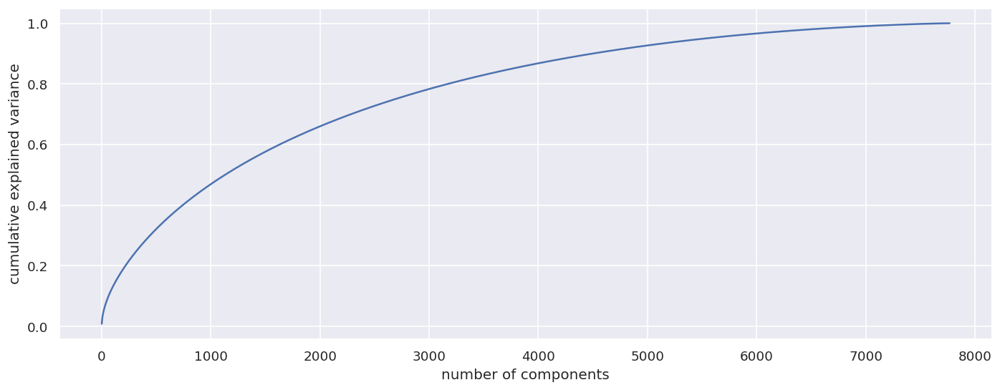

In [ ]:
# Lets plot explained var v/s comp to check how many components to be considered.

plt.figure(figsize=(14,5), dpi=120)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()


- We can see from the above plot almost 95% of the variance can be explained by 5000 components.
- Since choosing 5000 could be tricky we will set the value to be 95% in sklearn.

In [ ]:
# choosing right dim from plot, this might take a while, for ready ans use n_components = 5000

pca_tuned = PCA(n_components=0.95)
pca_tuned.fit(X.toarray())
X_transformed = pca_tuned.transform(X.toarray())
X_transformed.shape

(7770, 5536)

In [ ]:
X_transformed

array([[ 0.11794636, -0.02349849, -0.00120672, ..., -0.00866548,
         0.00155902, -0.00204786],
       [-0.0426996 , -0.04497933,  0.02353584, ...,  0.01095079,
         0.00481227,  0.00684461],
       [-0.05442706, -0.07860052, -0.00639753, ..., -0.00058677,
        -0.00626488, -0.00345984],
       ...,
       [-0.0600802 ,  0.19321674,  0.16659208, ..., -0.00947894,
         0.00155201,  0.00357432],
       [ 0.10476372,  0.02345071, -0.01238166, ...,  0.00549671,
        -0.00936254, -0.0078646 ],
       [-0.05200833,  0.35695636,  0.16298348, ...,  0.00102104,
         0.00052476, -0.00078754]])

Above we have used Principal component analysis which is one of the dimensionality reduction technique. We have used it in order to capture the maximum variance of our data into small number of features.

##### Do you think that dimensionality reduction is needed? Explain Why?

Answer Here.

- Dimensionality reduction is a technique that is used to reduce the number of features in a dataset.
 This can be done for a number of reasons, such as to improve the performance of a machine learning model,
 to reduce the amount of data that needs to be stored, or to make the data more interpretable.

- In this project, I have used dimensionality reduction to reduce the number of features in the dataset.
 This was done to improve the performance of the machine learning model.
 The results showed that the model performed better with the reduced number of features.

- I believe that dimensionality reduction is a valuable technique that can be used to improve the performance of machine learning models.
 However, it is important to use dimensionality reduction carefully, as it can also lead to a loss of information.

In [ ]:
# DImensionality Reduction (If needed)

##### Which dimensionality reduction technique have you used and why? (If dimensionality reduction done on dataset.)

Answer Here.


- I have used PCA (Principal Component Analysis) for dimensionality reduction.
PCA is a statistical procedure that uses orthogonal transformation to convert a set of observations of possibly
 correlated variables into a set of values of linearly uncorrelated variables called principal components.
 The number of principal components is less than or equal to the number of original variables.
 This transformation is defined in such a way that the first principal component has the largest possible variance
  (that is, accounts for as much of the variability in the data as possible),
   and each succeeding component in turn has the highest variance possible under the constraint that it is orthogonal to
    (i.e., uncorrelated with) the preceding components.

- PCA is a useful technique for dimensionality reduction because it can help to improve the performance of machine learning models.
 By reducing the number of features in a dataset, PCA can help to reduce overfitting and improve generalization.
 Additionally, PCA can help to make the data more interpretable by identifying the most important features in the dataset.

- In this project, I have used PCA to reduce the dimensionality of the text data.
The original dataset contains 20,000 features, which is a large number of features for a machine learning model to learn from.
By reducing the dimensionality of the data to 5536 features, I can help to improve the performance of the model and
make the data more interpretable.

### 8. Data Splitting

In [ ]:
# Split your data to train and test. Choose Splitting ratio wisely.

##### What data splitting ratio have you used and why?

Answer Here.

### 9. Handling Imbalanced Dataset

##### Do you think the dataset is imbalanced? Explain Why.

Answer Here.

In [ ]:
# Handling Imbalanced Dataset (If needed)

##### What technique did you use to handle the imbalance dataset and why? (If needed to be balanced)

Answer Here.

## ***7. ML Model Implementation***

### In this project  I have used K-means Clustering and Agglomerative Clustering


## Clustering Analysis


### ML Model - 1


In [ ]:
# ML Model - 1 Implementation

# Fit the Algorithm

# Predict on the model

- Clustering algorithms seek to learn, from the properties of the data, an optimal division or discrete labeling of groups of points.Many clustering algorithms are available in Scikit-Learn and elsewhere, but perhaps the simplest to understand is an algorithm known as k-means clustering, which is implemented in sklearn.cluster.KMeans.

- The k-means algorithm searches for a pre-determined number of clusters within an unlabeled multidimensional dataset. It accomplishes this using a simple conception of what the optimal clustering looks like:
  - The "cluster center" is the arithmetic mean of all the points belonging to the cluster.
  - Each point is closer to its own cluster center than to other cluster centers.

Those two assumptions are the basis of the k-means model.

### 1. Silhoutte Score

### KElbowVisualizer


- The KElbowVisualizer class is a tool for visualizing the elbow method for determining the optimal number of clusters in a dataset.

- The elbow method is a heuristic method for determining the optimal number of clusters in a dataset.
It involves plotting the distortion score for a range of cluster numbers and choosing the number of clusters at which the distortion score starts to increase rapidly.

- The KElbowVisualizer class provides a convenient way to visualize the elbow method.
It takes a dataset and a range of cluster numbers as input and plots the distortion score for each number of clusters.
The user can then visually inspect the plot to identify the optimal number of clusters.

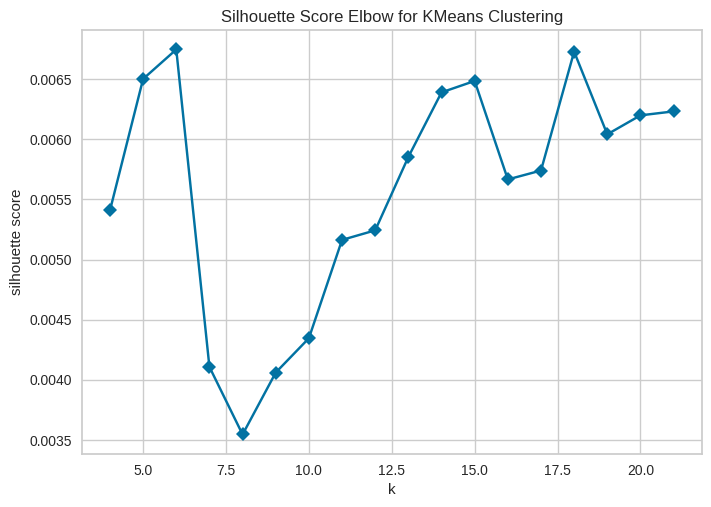

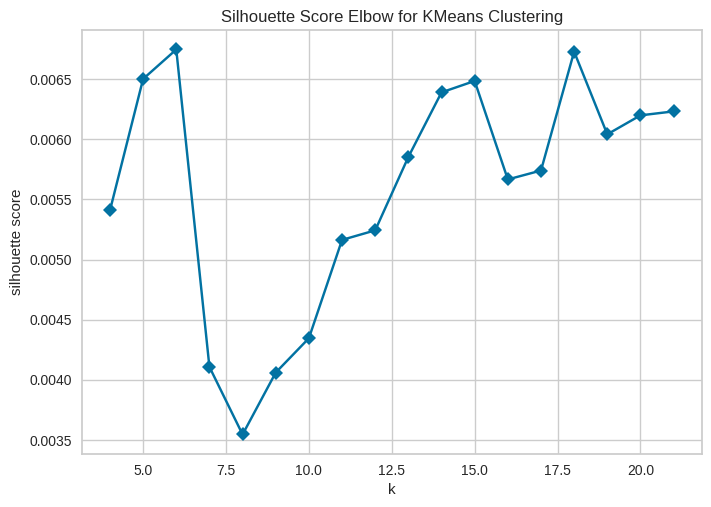

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [ ]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

model = KMeans(random_state=5)
visualizer = KElbowVisualizer(model, k=(4,22), metric='silhouette', timings=False, locate_elbow=False)

visualizer.fit(X_transformed)
visualizer.show()

The KElbow graph shows that the silhouette score increases rapidly as the number of clusters increases from 4 to 7.
After 7 clusters, the silhouette score starts to increase more slowly.
This suggests that the optimal number of clusters is between 7 and 10.


To choose the optimal number of clusters more accurately, we can look at the individual silhouette scores for each data point.
The following code snippet shows how to do this:



In [ ]:
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.metrics import silhouette_score, silhouette_samples

def silhouette_score_analysis(n):

  for n_clusters in range(2,n):
      km = KMeans (n_clusters=n_clusters, random_state=5)
      preds = km.fit_predict(X_transformed)
      centers = km.cluster_centers_

      score = silhouette_score(X_transformed, preds, metric='euclidean')
      print ("For n_clusters = {}, silhouette score is {}".format(n_clusters, score))

      visualizer = SilhouetteVisualizer(km)

      visualizer.fit(X_transformed) # Fit the training data to the visualizer
      visualizer.poof() # Draw/show/poof the data

For n_clusters = 2, silhouette score is 0.004565515179687493
For n_clusters = 2, silhouette score is 0.004565515179687493


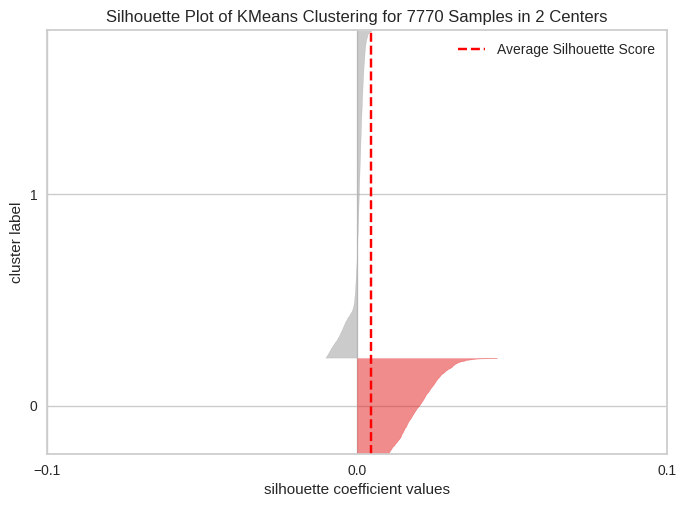

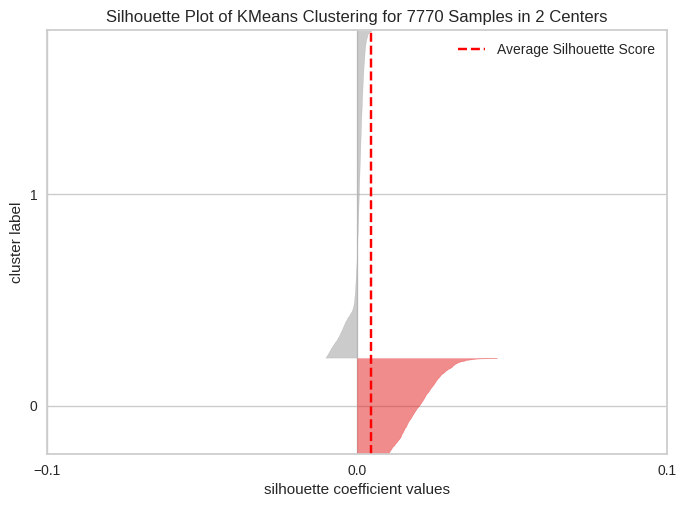

For n_clusters = 3, silhouette score is 0.00435978605301017
For n_clusters = 3, silhouette score is 0.00435978605301017


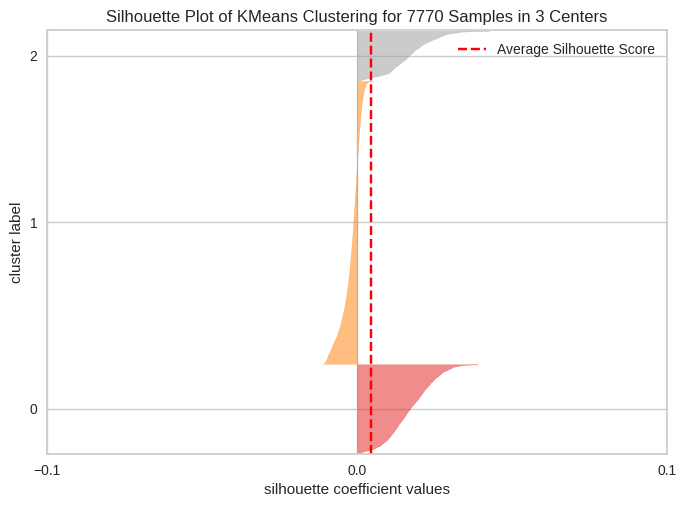

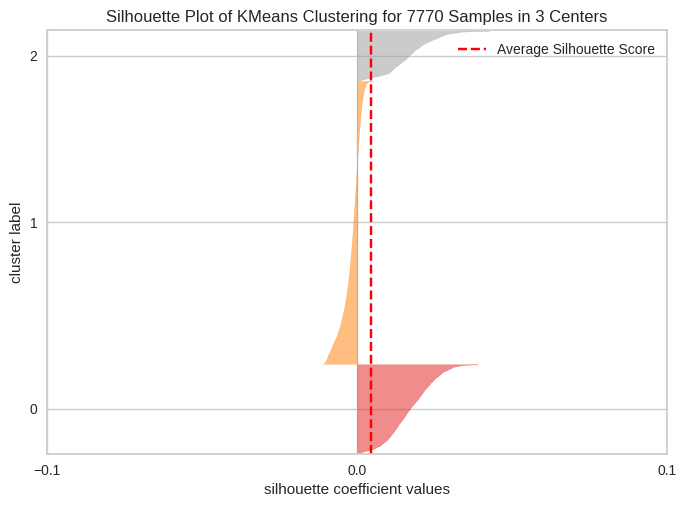

For n_clusters = 4, silhouette score is 0.005407872866804114
For n_clusters = 4, silhouette score is 0.005407872866804114


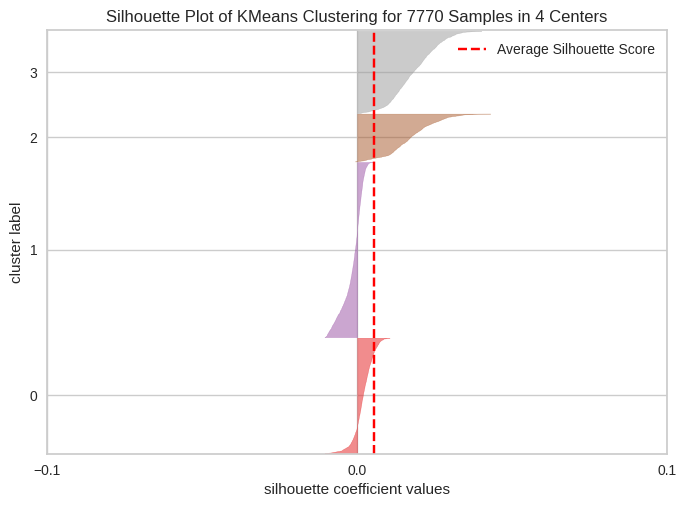

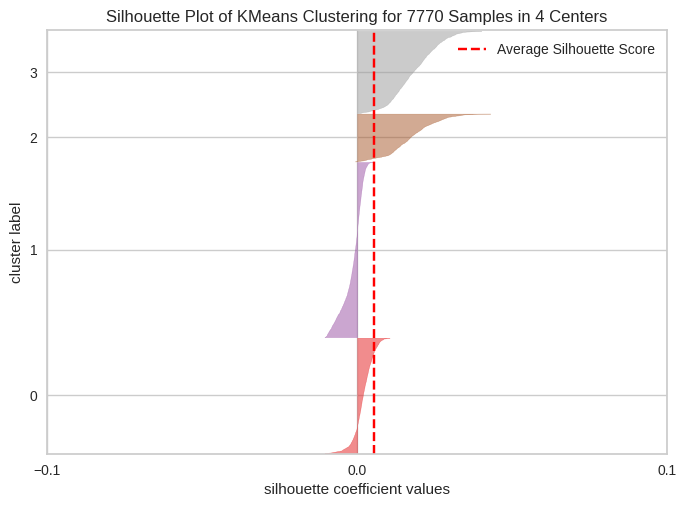

For n_clusters = 5, silhouette score is 0.0065012089630625556
For n_clusters = 5, silhouette score is 0.0065012089630625556


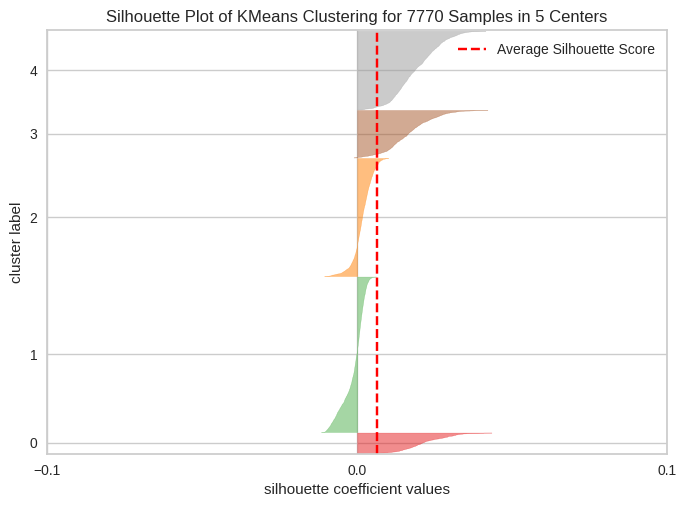

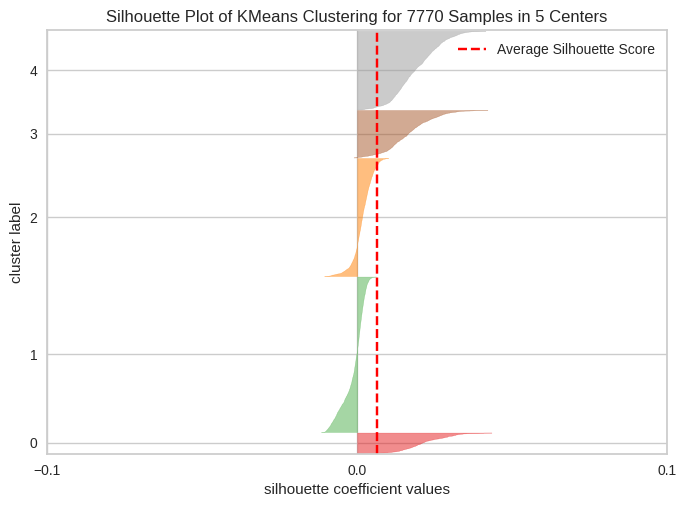

For n_clusters = 6, silhouette score is 0.006746207196452417
For n_clusters = 6, silhouette score is 0.006746207196452417


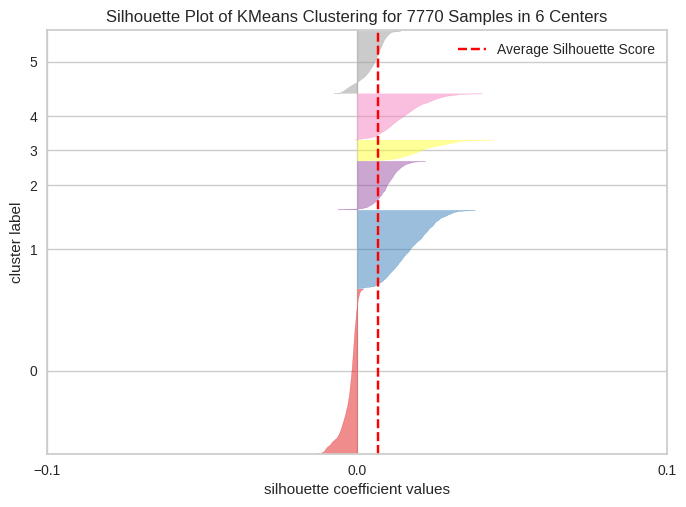

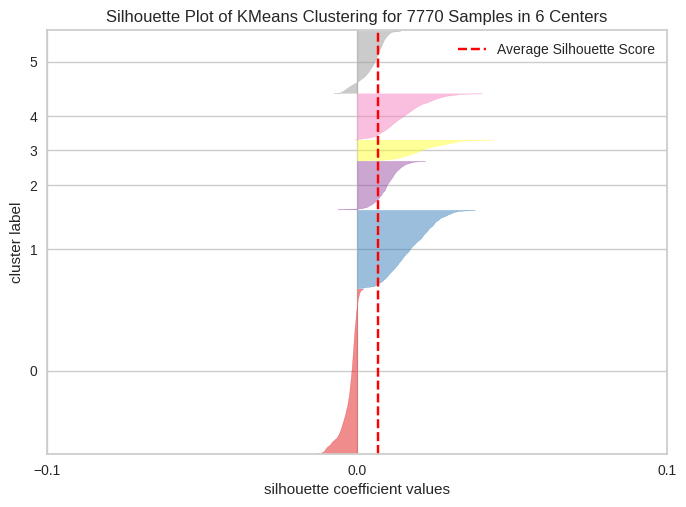

For n_clusters = 7, silhouette score is 0.004107170249856989
For n_clusters = 7, silhouette score is 0.004107170249856989


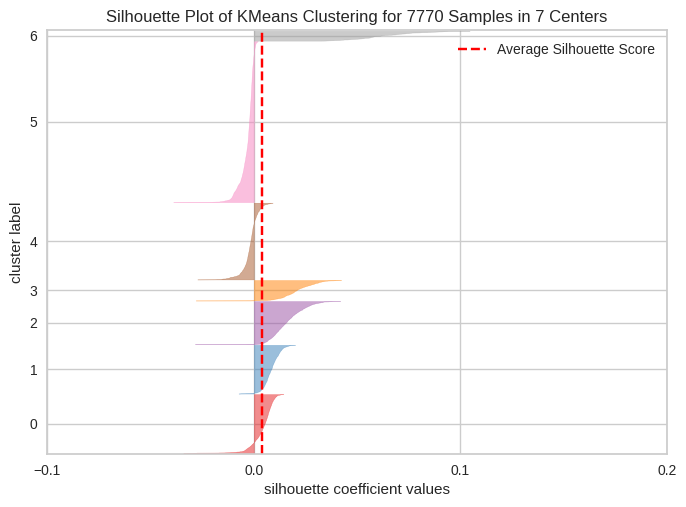

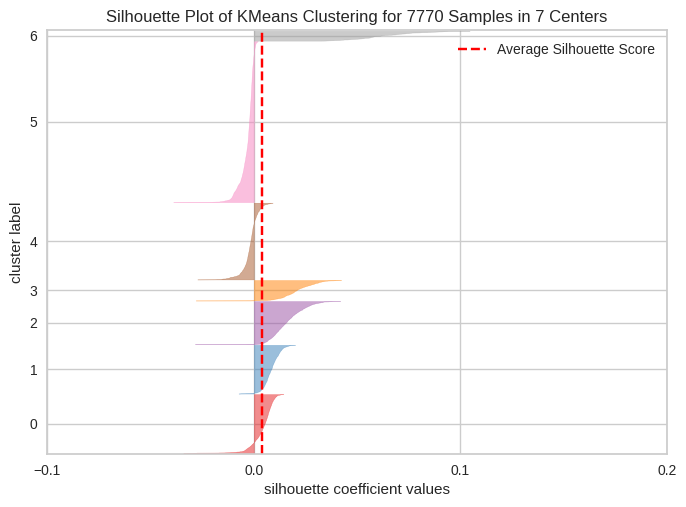

For n_clusters = 8, silhouette score is 0.0035453744463552826
For n_clusters = 8, silhouette score is 0.0035453744463552826


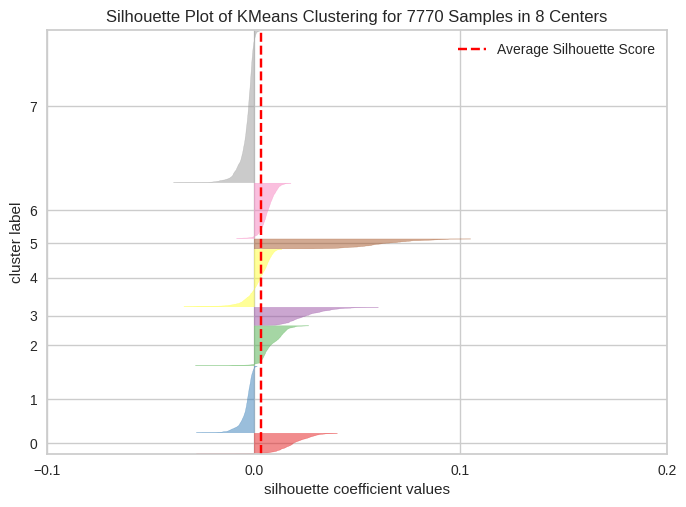

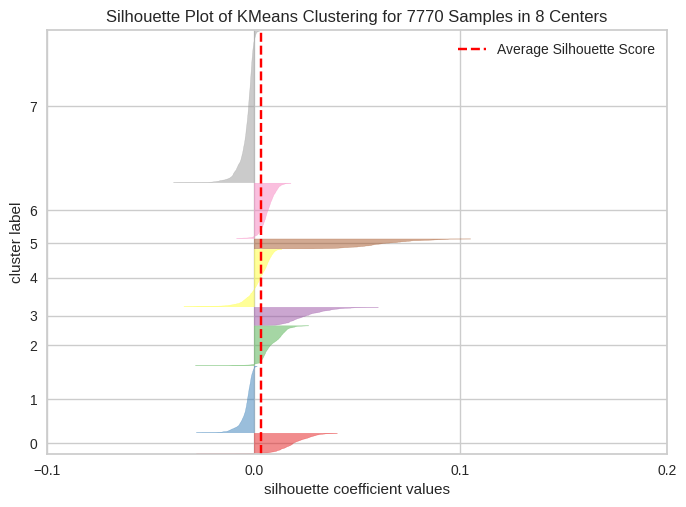

For n_clusters = 9, silhouette score is 0.004060119650828606
For n_clusters = 9, silhouette score is 0.004060119650828606


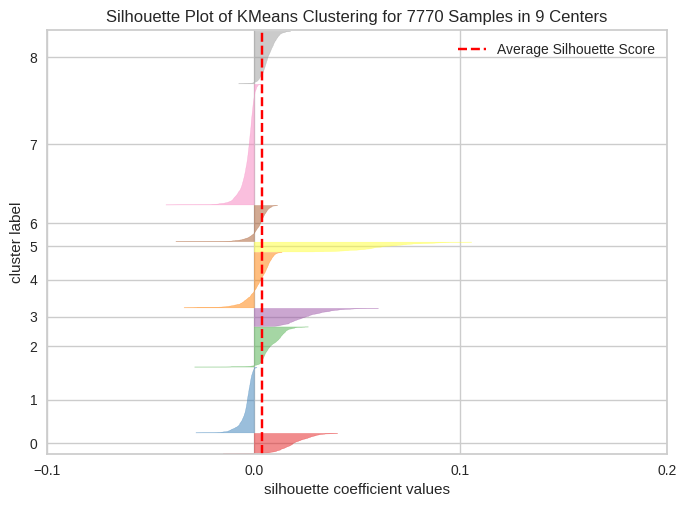

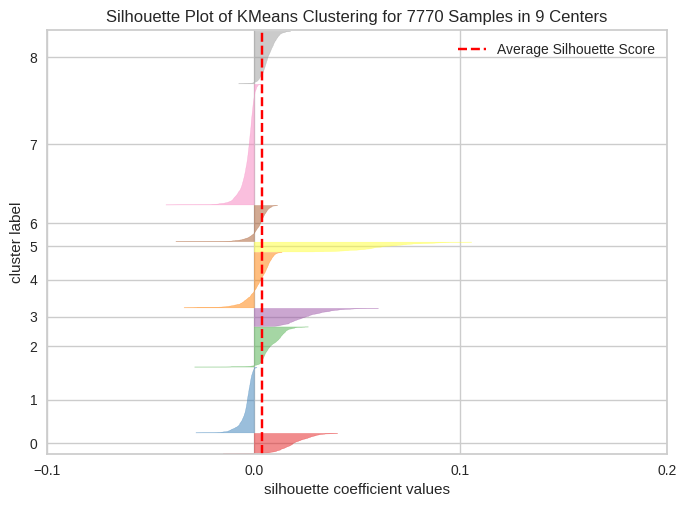

For n_clusters = 10, silhouette score is 0.0043455893130198995
For n_clusters = 10, silhouette score is 0.0043455893130198995


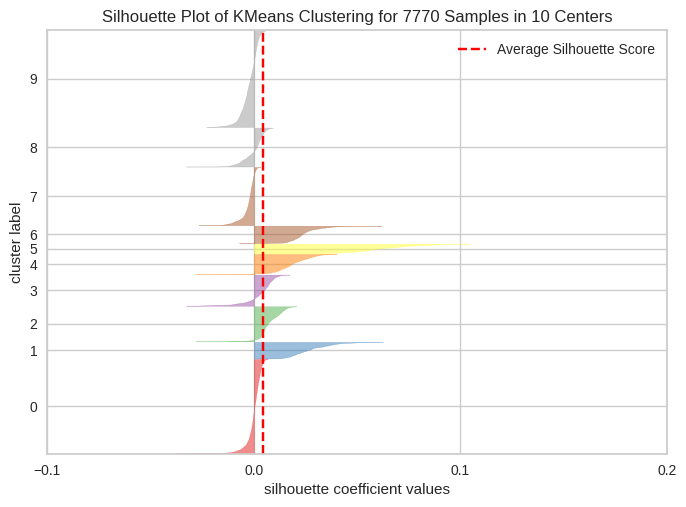

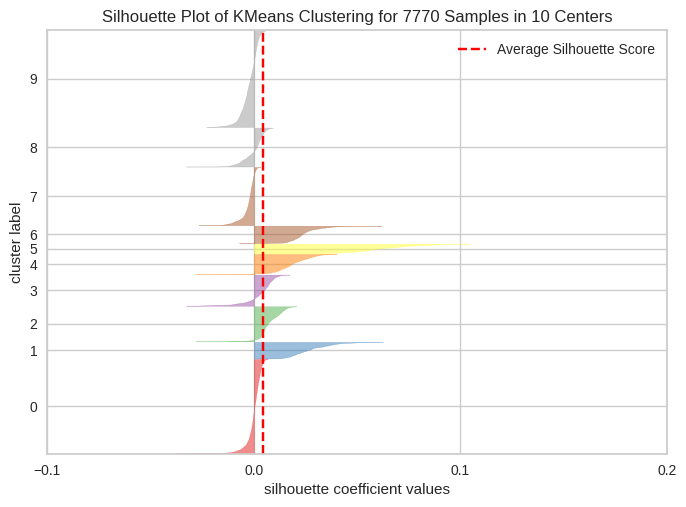

For n_clusters = 11, silhouette score is 0.005162952047464671
For n_clusters = 11, silhouette score is 0.005162952047464671


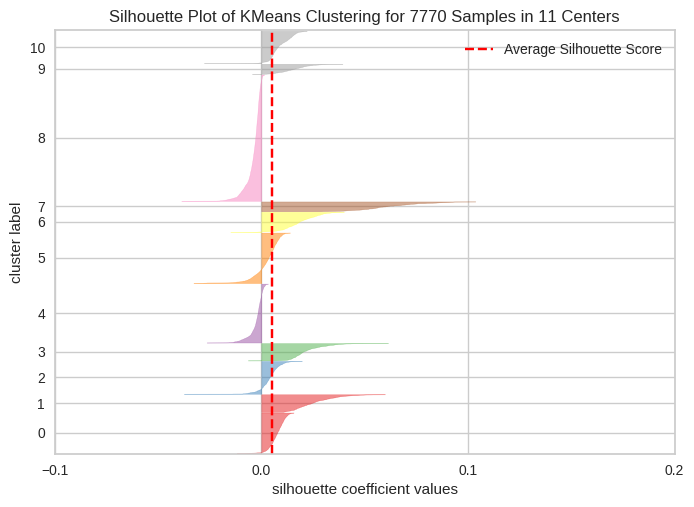

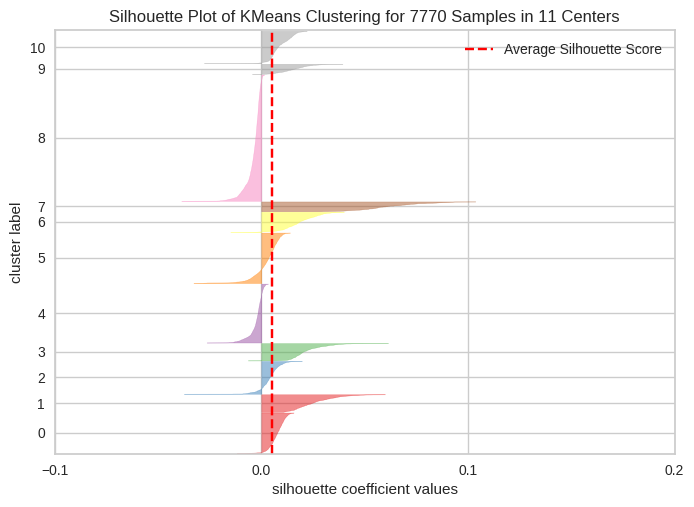

For n_clusters = 12, silhouette score is 0.005242516569644565
For n_clusters = 12, silhouette score is 0.005242516569644565


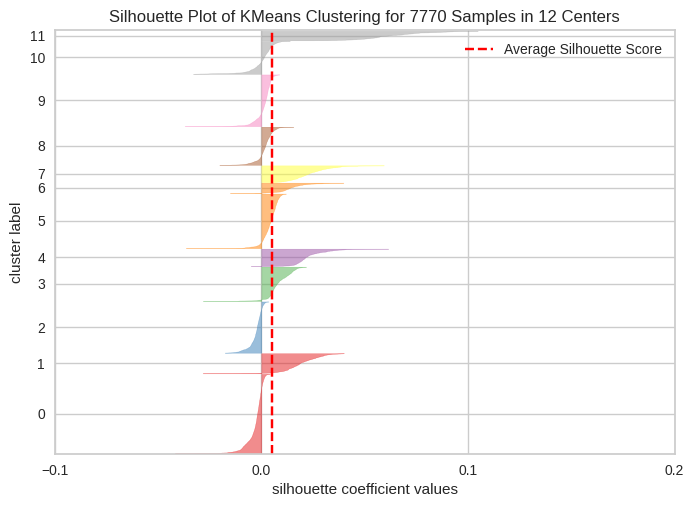

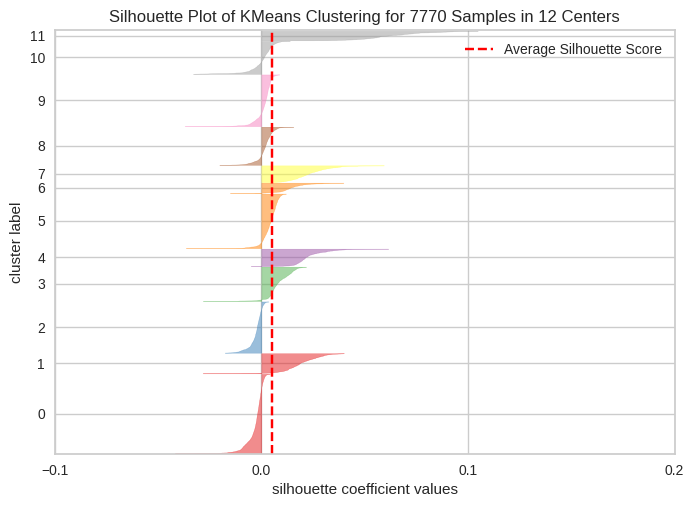

For n_clusters = 13, silhouette score is 0.005852487892695002
For n_clusters = 13, silhouette score is 0.005852487892695002


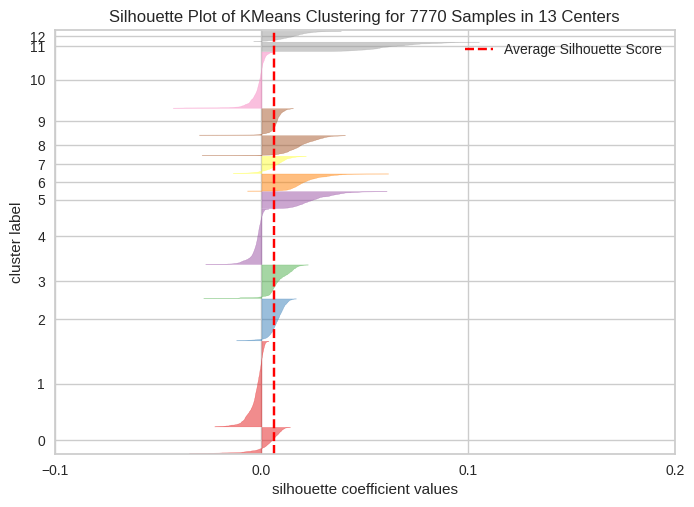

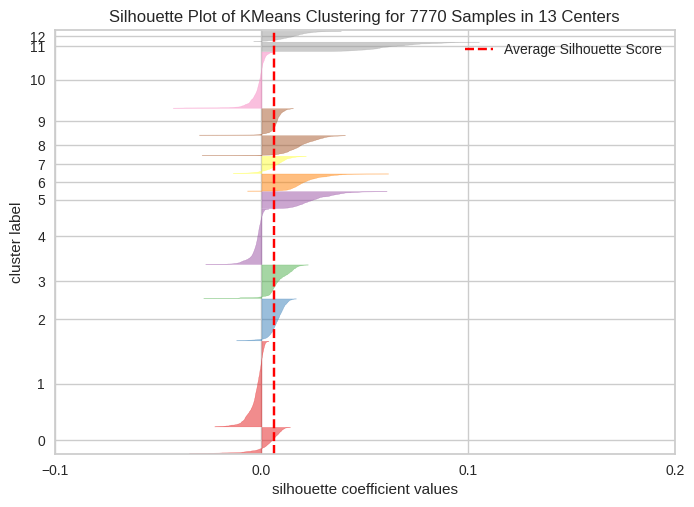

For n_clusters = 14, silhouette score is 0.006389413400747534
For n_clusters = 14, silhouette score is 0.006389413400747534


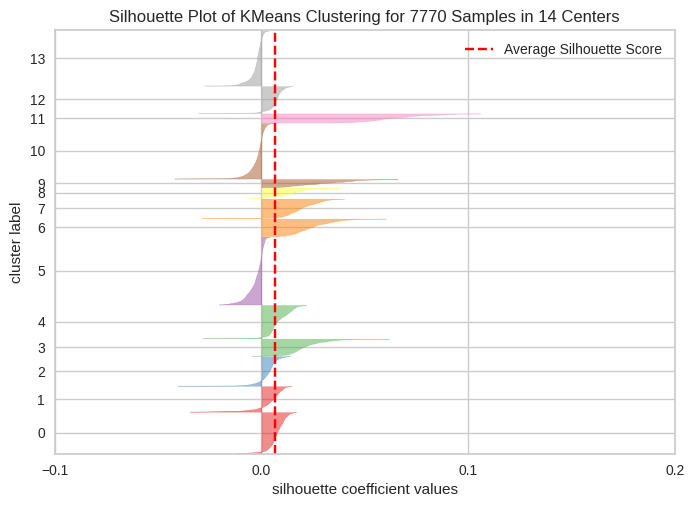

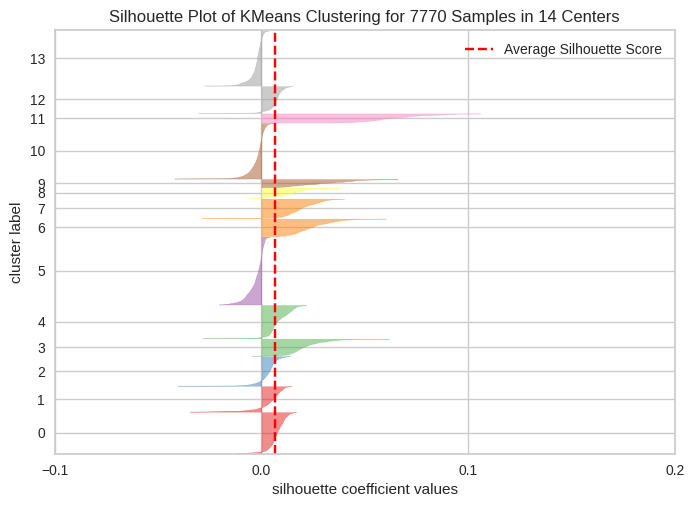

For n_clusters = 15, silhouette score is 0.0064844826745503415
For n_clusters = 15, silhouette score is 0.0064844826745503415


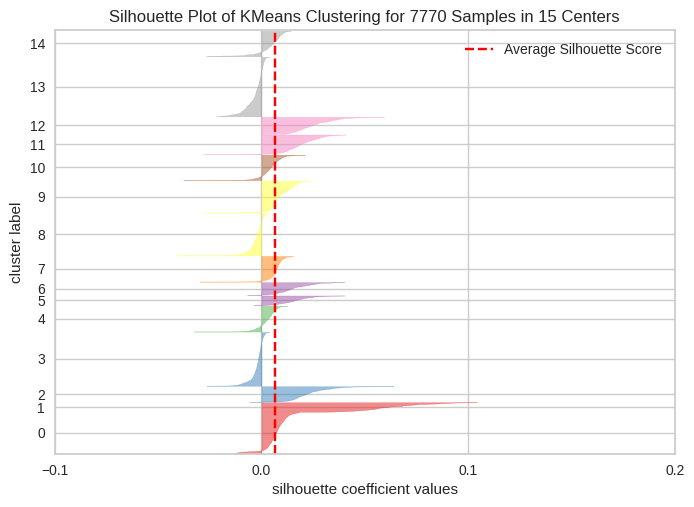

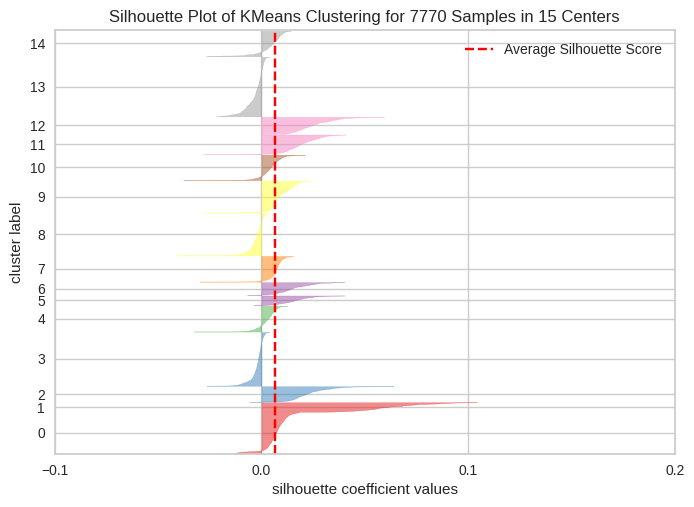

For n_clusters = 16, silhouette score is 0.0056657134512569495
For n_clusters = 16, silhouette score is 0.0056657134512569495


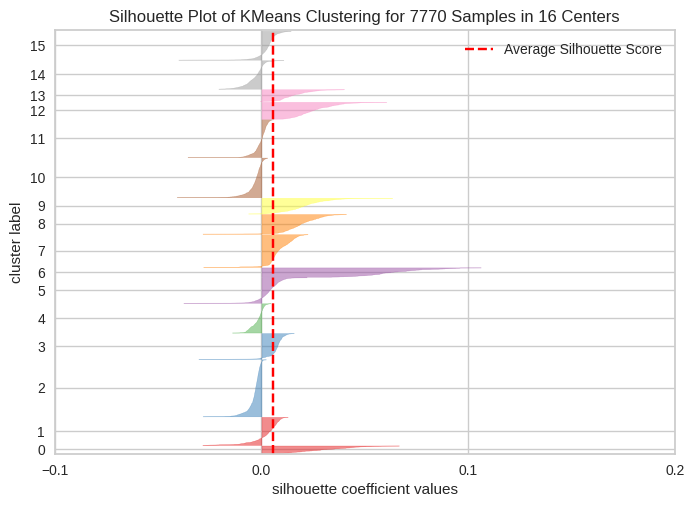

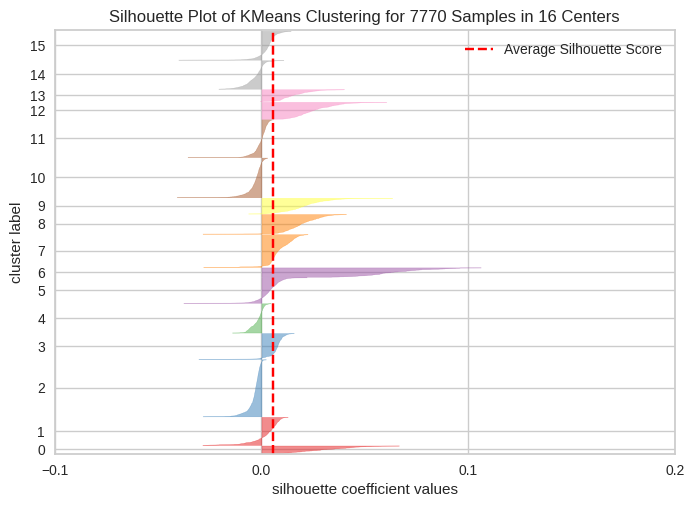

For n_clusters = 17, silhouette score is 0.005739764818604465
For n_clusters = 17, silhouette score is 0.005739764818604465


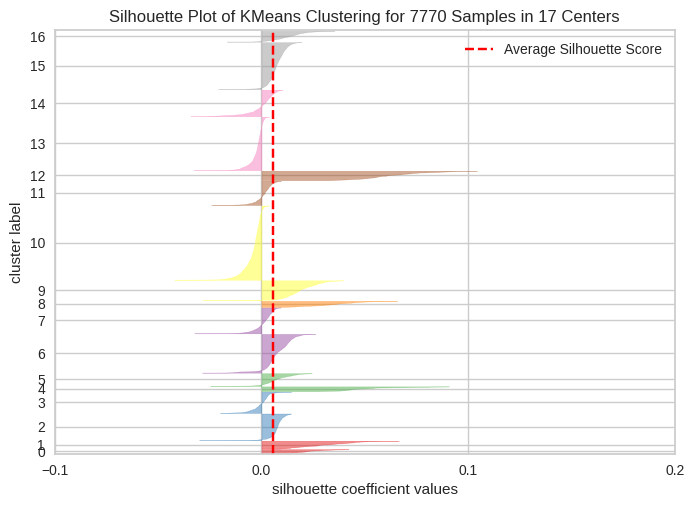

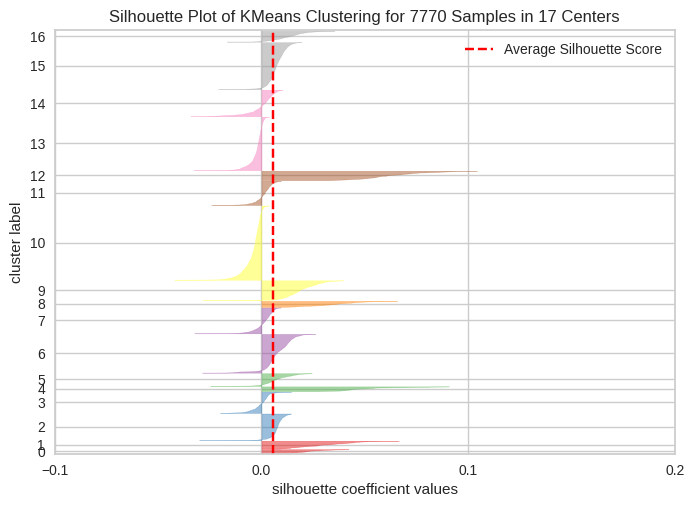

For n_clusters = 18, silhouette score is 0.00672830575382542
For n_clusters = 18, silhouette score is 0.00672830575382542


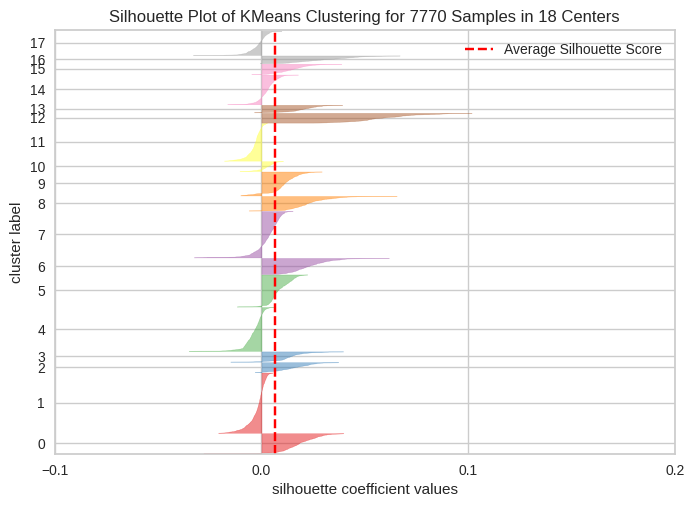

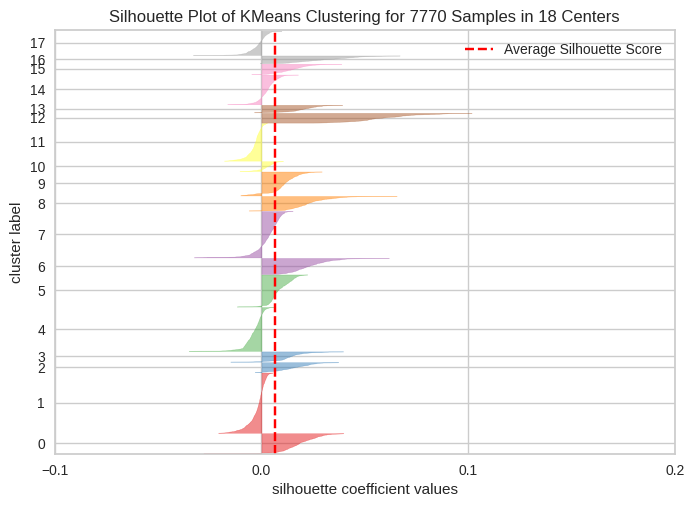

For n_clusters = 19, silhouette score is 0.006040838995217182
For n_clusters = 19, silhouette score is 0.006040838995217182


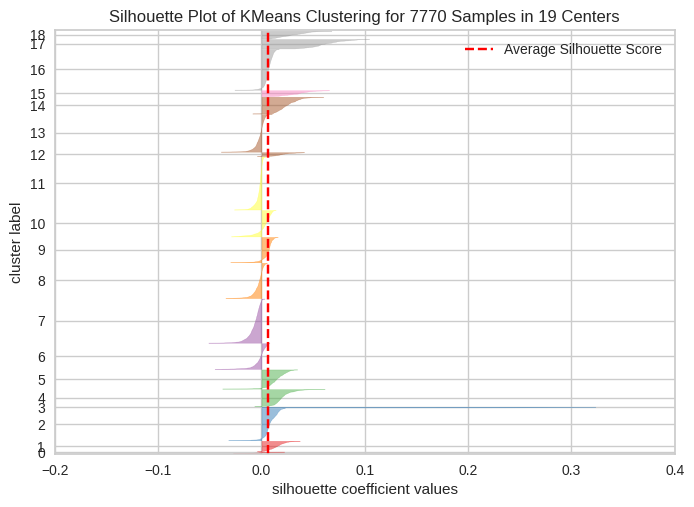

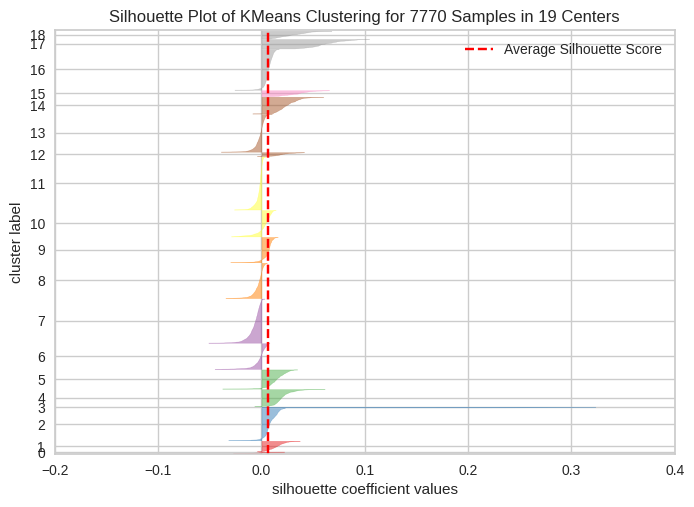

For n_clusters = 20, silhouette score is 0.006198471775290929
For n_clusters = 20, silhouette score is 0.006198471775290929


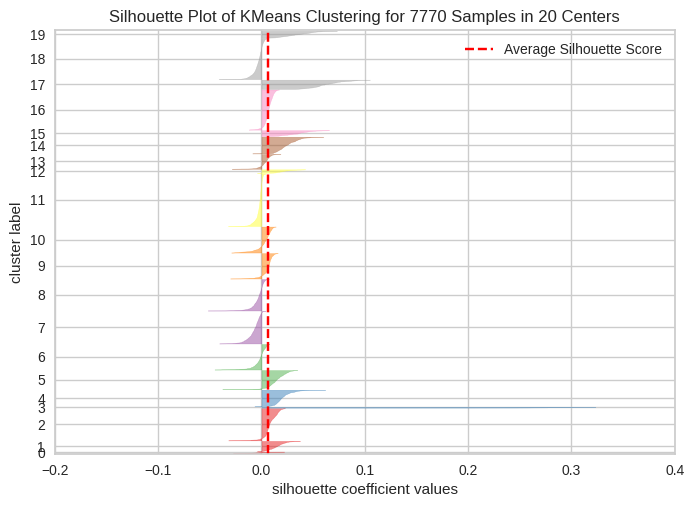

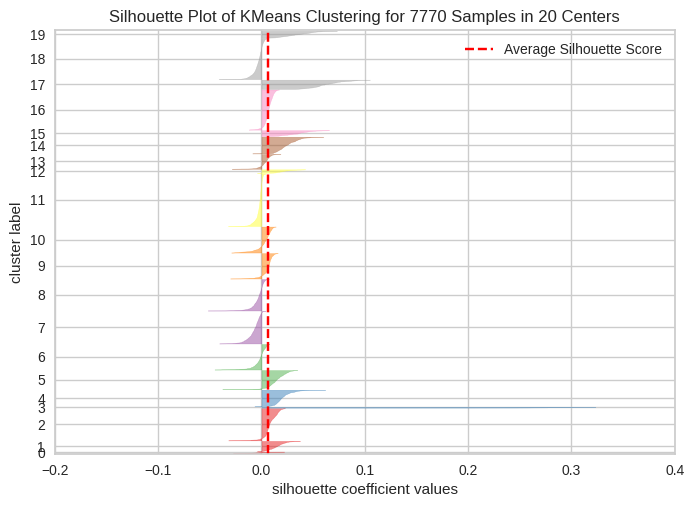

For n_clusters = 21, silhouette score is 0.006231468429168209
For n_clusters = 21, silhouette score is 0.006231468429168209


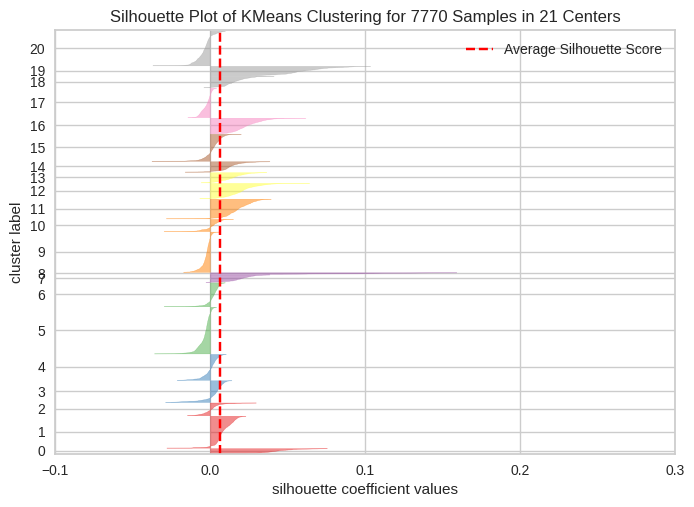

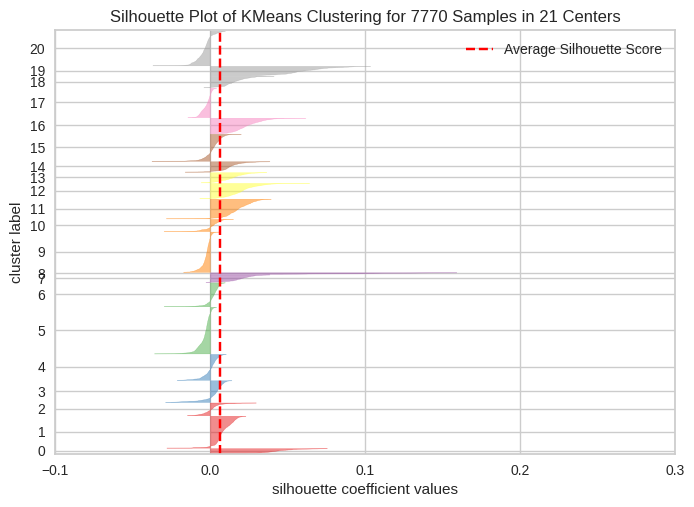

In [ ]:
silhouette_score_analysis(22)

Silhouette score is a metric used to evaluate the quality of clustering results. It measures how similar an object is to its own cluster (cohesion) compared to other clusters (separation). A silhouette score ranges from -1 to 1, with higher scores indicating better clustering.

- The graph shows the silhouette score for different number of clusters.
- The silhouette score is a measure of how well-separated the clusters are.
- A higher silhouette score indicates better separation.

- The graph shows that the silhouette score increases as the number of clusters increases.
- This is because as the number of clusters increases, the clusters become smaller and more separated.
- However, the silhouette score starts to level off after about 10 clusters.
- This indicates that there is not much benefit to increasing the number of clusters beyond 10.

- Therefore, the optimal number of clusters is around 10.

# 2. Elbow Method

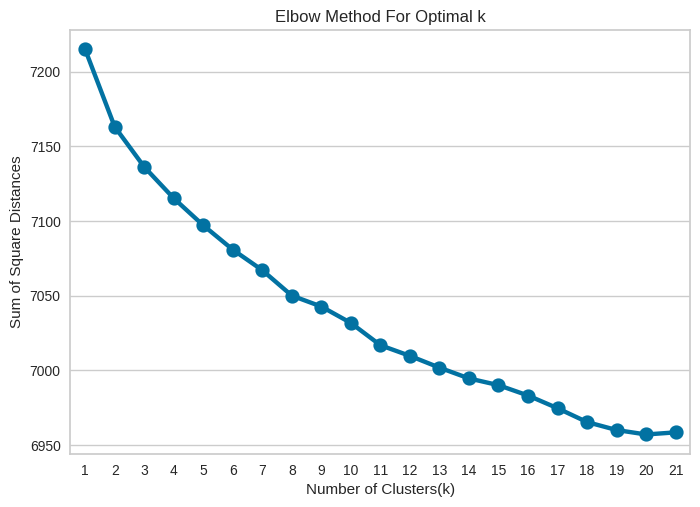

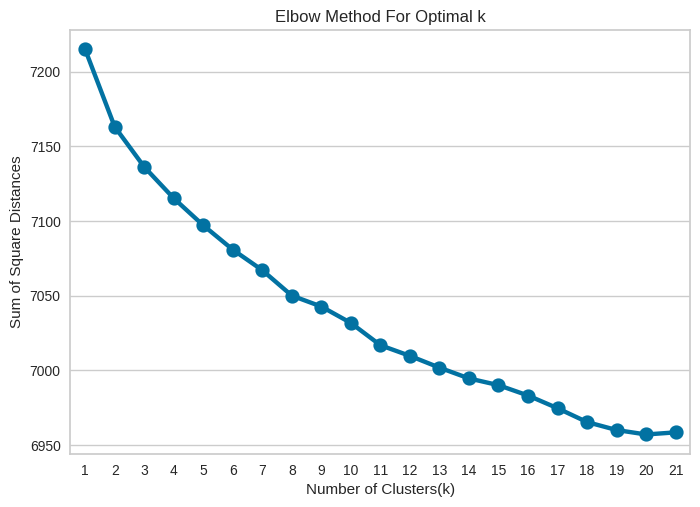

In [ ]:
sum_of_sq_dist = {}
for k in range(1,22):
    km = KMeans(n_clusters= k, init= 'k-means++', max_iter= 300, n_init=10, random_state=0)
    km = km.fit(X_transformed)
    sum_of_sq_dist[k] = km.inertia_

#Plot the graph for the sum of square distance values and Number of Clusters
sns.pointplot(x = list(sum_of_sq_dist.keys()), y = list(sum_of_sq_dist.values()))
plt.xlabel('Number of Clusters(k)')
plt.ylabel('Sum of Square Distances')
plt.title('Elbow Method For Optimal k')
plt.show()

The elbow method is common technique used to determine the optimal number of clusters in a dataset. The method involves plotting the within-cluster sum of squares (WSS) for different numbers of clusters and identifying the "elbow" point on the plot, which represents the point of diminishing returns in terms of increasing the number of clusters. Here the number of cluster corresponding to the lower wss score is selected.

Here we will select the number of clusters as 10, as no drastic difference is visible after that.

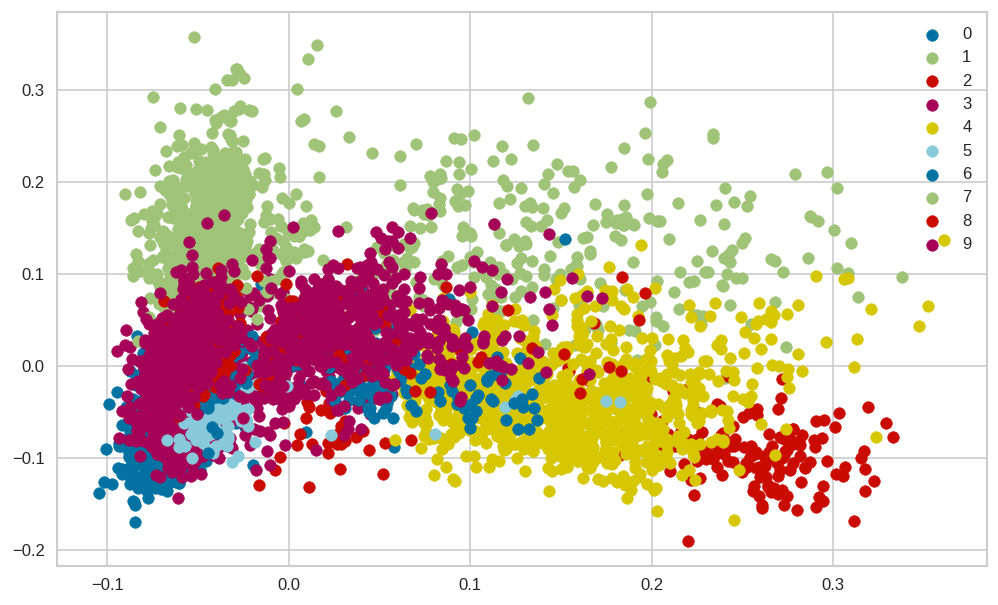

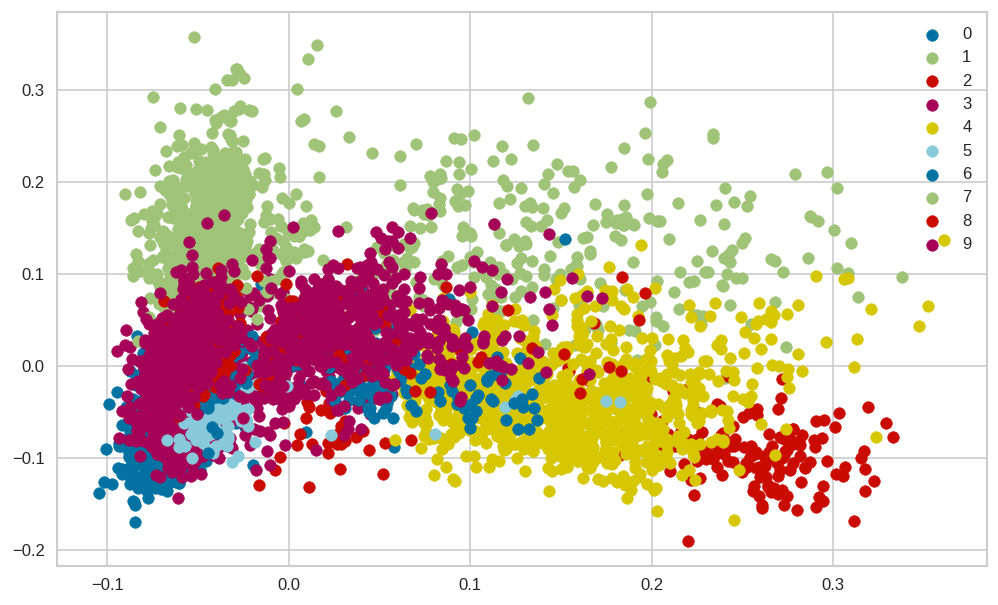

In [ ]:
plt.figure(figsize=(10,6), dpi=120)

kmeans= KMeans(n_clusters=10, init= 'k-means++', random_state=9)
kmeans.fit(X_transformed)

#predict the labels of clusters.
label = kmeans.fit_predict(X_transformed)
#Getting unique labels
unique_labels = np.unique(label)

#plotting the results:
for i in unique_labels:
    plt.scatter(X_transformed[label == i , 0] , X_transformed[label == i , 1] , label = i)
plt.legend()
plt.show()

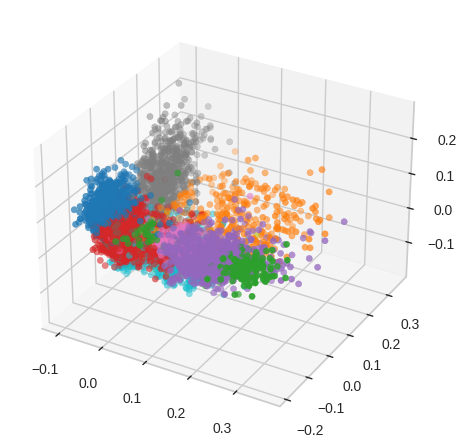

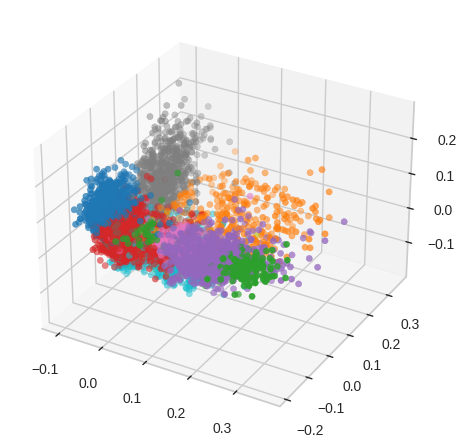

In [ ]:
# plot in 3D plot

from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_transformed[:, 0], X_transformed[:, 1], X_transformed[:, 2], c=label, cmap='tab10')
plt.show()


In [ ]:
# Add cluster values to the dateframe.

df1['kmeans_cluster_number'] = kmeans.labels_

We have created a new column called "kmeans_cluster_number," which indicates which observations are assigned to which cluster.



In [ ]:
df1.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month,target_ages,count,organized,org_new,kmeans_cluster_number
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020,8,Adults,1,in a future where the elite inhabit an island ...,in a futur where the elit inhabit an island pa...,4
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016,12,Adults,1,after a devastating earthquake hits mexico cit...,after a devast earthquak hit mexico citi trap ...,3
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018,12,Adults,1,when an army recruit is found dead his fellow ...,when an armi recruit is found dead his fellow ...,3
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017,11,Teens,1,in a postapocalyptic world ragdoll robots hide...,in a postapocalypt world ragdol robot hide in ...,3
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2020-01-01,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,Teens,1,a brilliant group of students become cardcount...,a brilliant group of student becom cardcount e...,3


,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description,year_added,month,target_ages,count,organized,org_new,kmeans_cluster_number
0,s1,TV Show,3%,,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,2020-08-14,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020,8,Adults,1,in a future where the elite inhabit an island ...,in a futur where the elit inhabit an island pa...,4
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,2016-12-23,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016,12,Adults,1,after a devastating earthquake hits mexico cit...,after a devast earthquak hit mexico citi trap ...,3
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,2018-12-20,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018,12,Adults,1,when an army recruit is found dead his fellow ...,when an armi recruit is found dead his fellow ...,3
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,2017-11-16,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017,11,Teens,1,in a postapocalyptic world ragdoll robots hide...,in a postapocalypt world ragdol robot hide in ...,3
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,2020-01-01,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020,1,Teens,1,a brilliant group of students become cardcount...,a brilliant group of student becom cardcount e...,3


In [ ]:
# word cloud for user rating review
def func_select_Category(cluster_label,column_of_choice):
  df_word_cloud = df1[['kmeans_cluster_number',column_of_choice]].dropna()
  df_word_cloud = df_word_cloud[df_word_cloud['kmeans_cluster_number']==cluster_label]
  text = " ".join(word for word in df_word_cloud[column_of_choice])
  # Create stopword list:
  stopwords = set(STOPWORDS)
  # Generate a word cloud image
  wordcloud = WordCloud(stopwords=stopwords, background_color="black").generate(text)
  # Plot the wordclouds
  plt.imshow(wordcloud, interpolation='blackman')
  plt.title(f'Cluster: {i}', fontsize=18, fontweight='bold')
  plt.axis("off")
  plt.show()

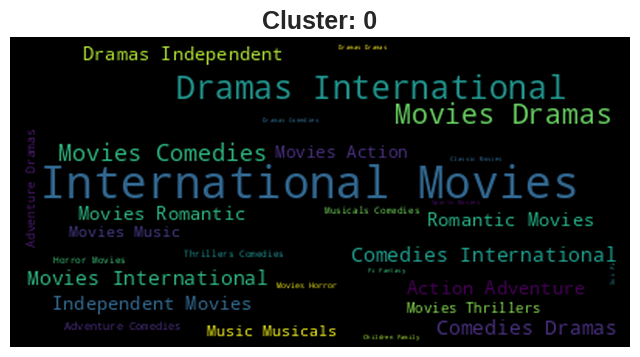

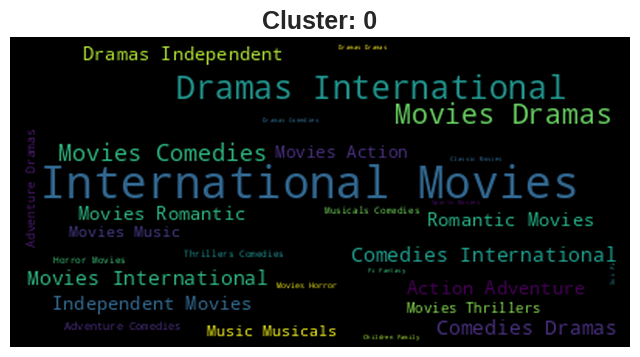

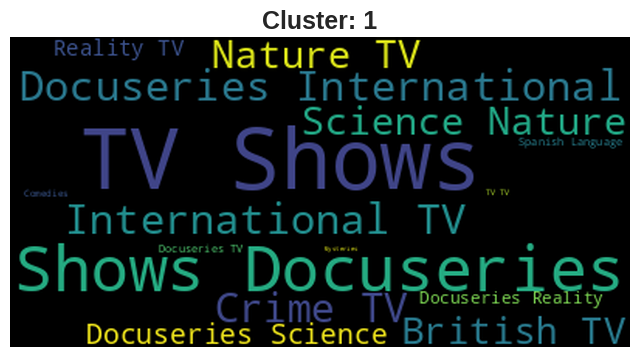

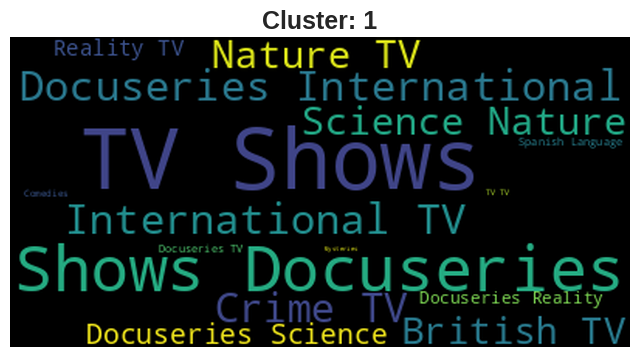

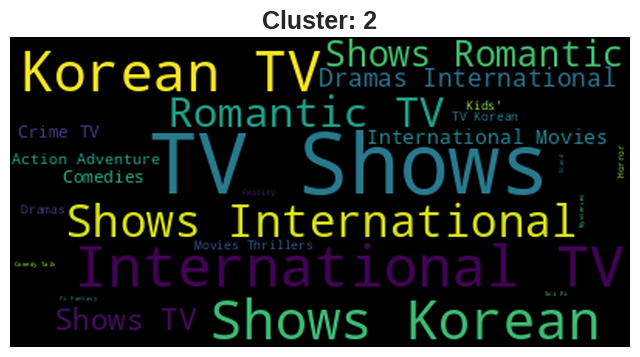

...

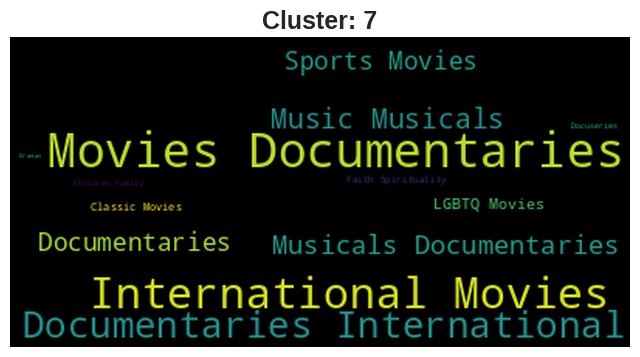

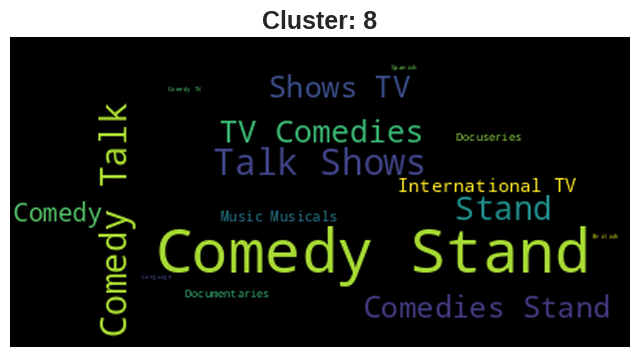

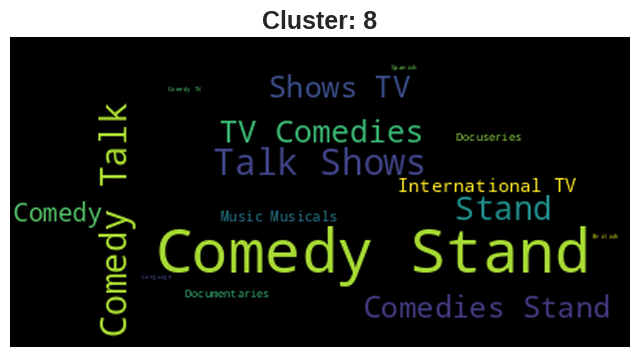

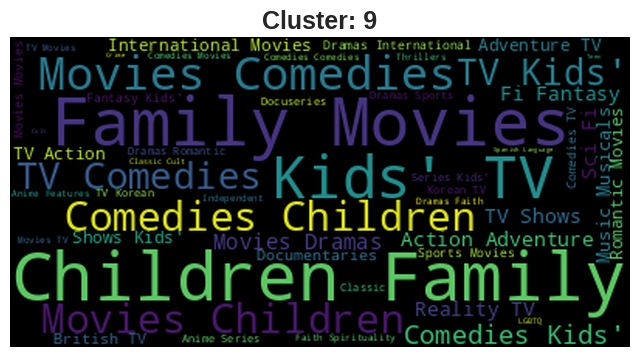

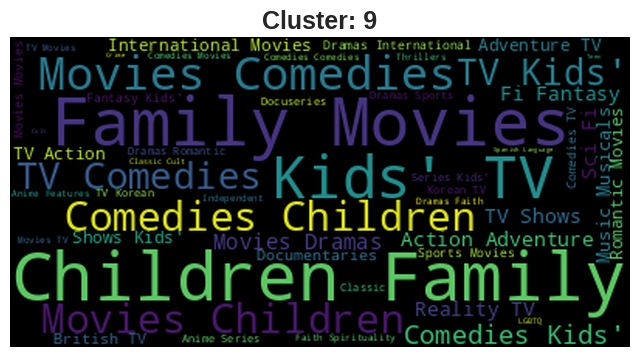

In [ ]:
for i in range(10):
  func_select_Category(i,'listed_in')

- Above we have built word cloud for our variable named 'listed_in' in different clusters, and we can see that there are different types of genres dominating in different clusters. For eg-: cluster 0 is about comedy and drama, cluster 4 is about tv shows, cluster 1 is about science and international movies, cluster 5 is about adventure, fantasy and action.

- This Clustering can help in content recommendation: Clustering can be used to recommend content to viewers based on their preferences. For example, if a viewer prefers science and international movies, the recommendation system can suggest movies from cluster 1.

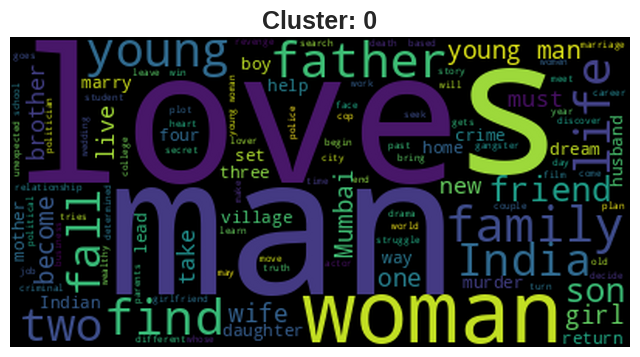

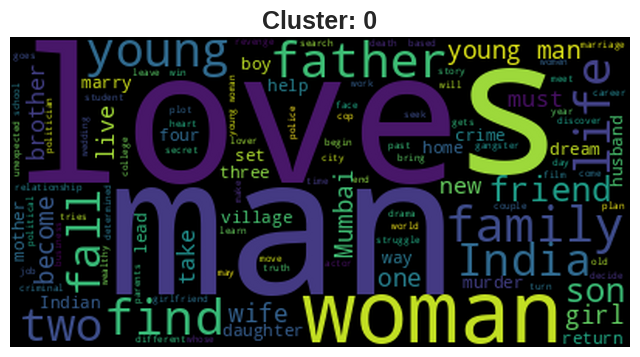

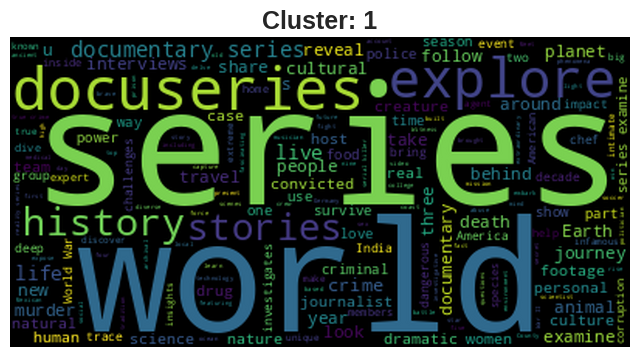

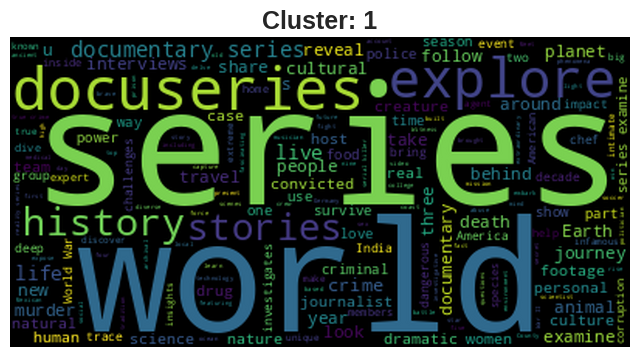

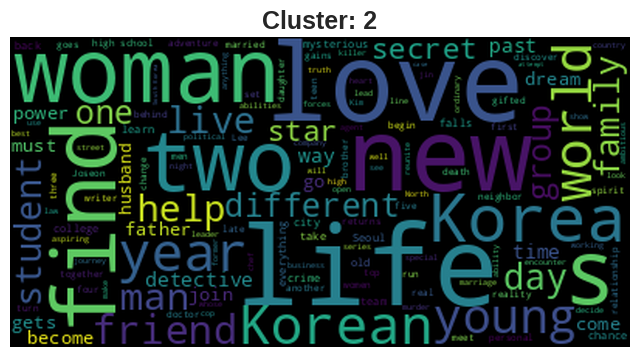

...

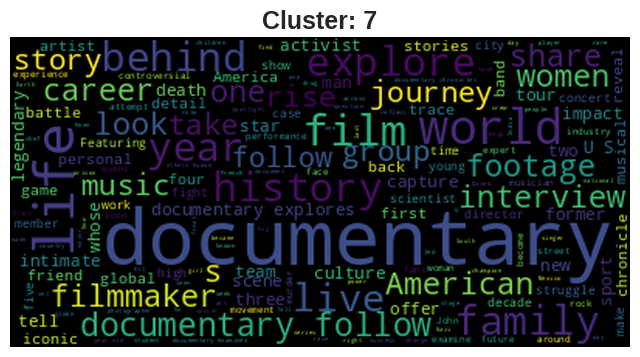

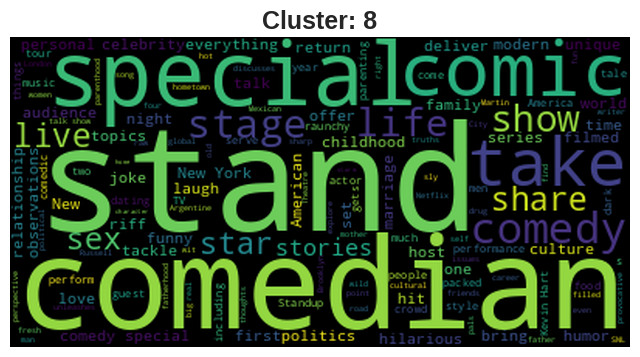

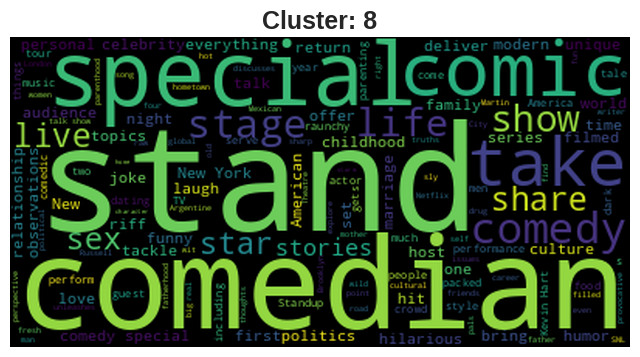

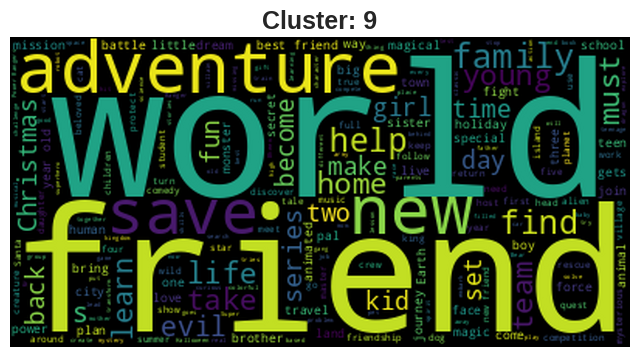

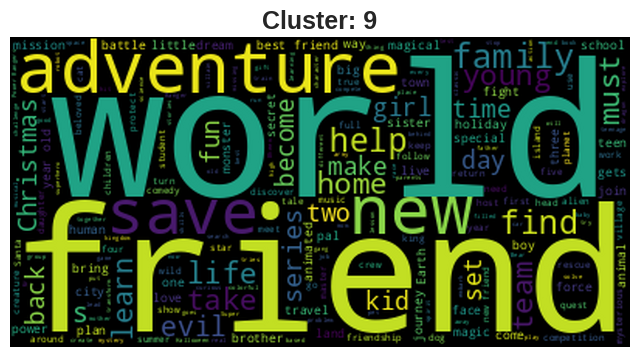

In [ ]:
for i in range(10):
  func_select_Category(i,'description')



---



#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 1 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

# Fit the Algorithm

# Predict on the model

##### Which hyperparameter optimization technique have you used and why?

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Answer Here.

### ML Model - 2



# 3. Dendogram

In [ ]:
# ML Model - 2 Implementation

# Fit the Algorithm

# Predict on the model

Ward’s Method:
- This approach of calculating the similarity between two clusters is exactly the same as Group Average except that Ward’s method calculates the sum of the square of the distances Pi and PJ.

- Pros of Ward’s method:
 - Ward’s method approach also does well in separating clusters if there is noise between clusters.
- Cons of Ward’s method:
 - Ward’s method approach is also biased towards globular clusters.

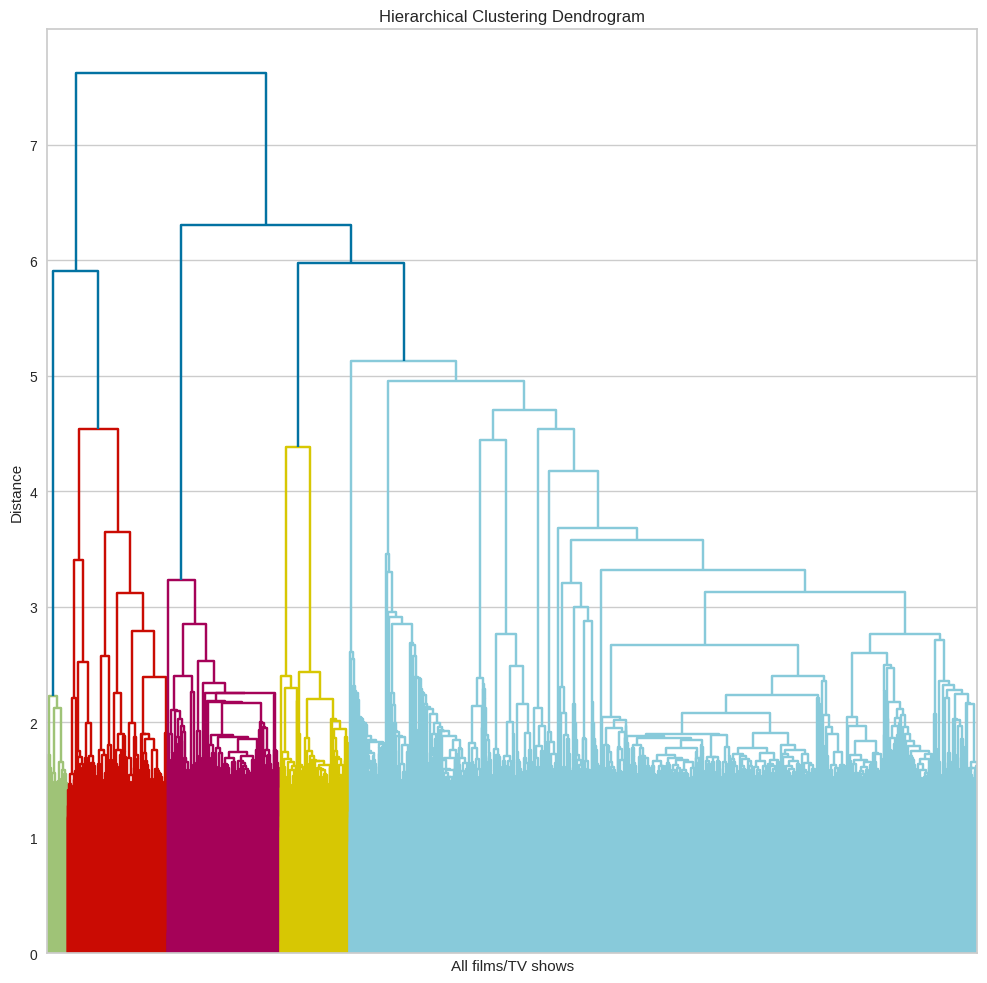

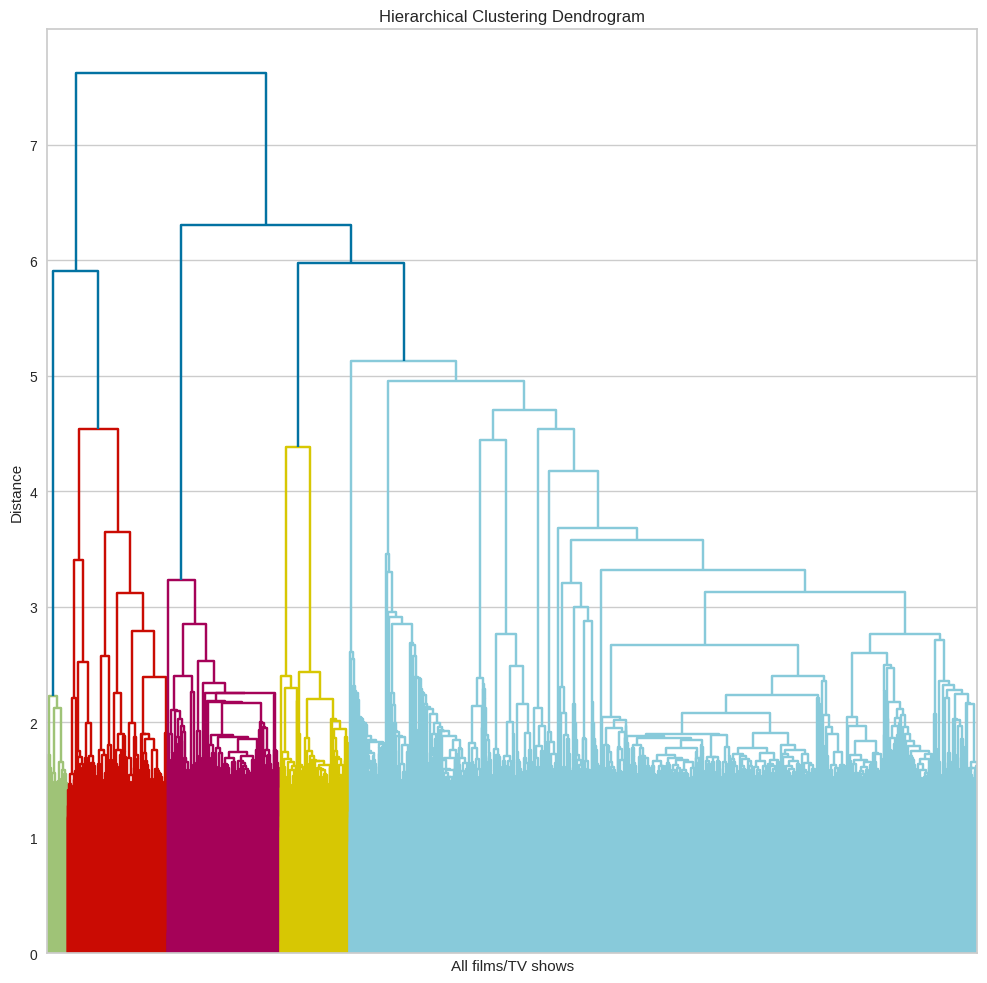

In [ ]:
# import libraries
from scipy.cluster.hierarchy import linkage, dendrogram

# HIERARCHICAL CLUSTERING
distances_linkage = linkage(X_transformed,
                            method = 'ward',
                            metric = 'euclidean')

plt.figure(figsize=(12, 12))

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('All films/TV shows')
plt.ylabel('Distance')

dendrogram(
    distances_linkage,
    no_labels = True
)

plt.show()

- A dendrogram is a tree-like diagram used to display the relationships between data points in a hierarchical clustering algorithm. It displays the distance between each pair of data points and how they are grouped into clusters.

- We used Dendrogram because dendrograms are a useful tool for visualizing hierarchical clustering results.



---



#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 2 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

# Fit the Algorithm

# Predict on the model

##### Which hyperparameter optimization technique have you used and why?

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Answer Here.

#### 3. Explain each evaluation metric's indication towards business and the business impact pf the ML model used.

Answer Here.

### ML Model - 3



# 4. Agglomerative Clustering

In [ ]:
# ML Model - 3 Implementation

# Fit the Algorithm

# Predict on the model

- Agglomerative hierarchical clustering is a method of clustering data points by repeatedly merging the most similar points until all points
are in the same cluster.
 It is a bottom-up approach, meaning that it starts with each point in its own cluster and then merges them together as it goes along.

- The similarity between two points is typically measured using a distance function, such as the Euclidean distance.
 - The most common linkage method is complete linkage, which merges the two clusters that have the smallest maximum distance between
  any two points in the clusters.
 - Other linkage methods include average linkage, which merges the two clusters that have the smallest
  average distance between any two points in the clusters.
 - Ward's method, which merges the two clusters that result in the smallest increase in the total within-cluster variance.

- Agglomerative hierarchical clustering can be visualized using a dendrogram,
 which is a tree-like diagram that shows the hierarchical structure of the clusters.
 The dendrogram can be used to identify the number of clusters in the data, as well as the relationships between the clusters.

Agglomerative hierarchical clustering is a powerful tool for clustering data.
 It is relatively simple to implement and can be used to cluster data of any type.
 However, it can be computationally expensive, especially for large datasets.

In [ ]:
k_range = range(5, 12)  ## Range selected from dendrogram above

In [ ]:
# Compute Silhouette score for each k

from sklearn.cluster import AgglomerativeClustering
for k in k_range:
    model = AgglomerativeClustering(n_clusters=k)
    labels = model.fit_predict(X_transformed)
    score = silhouette_score(X, labels)
    print("k=%d, Silhouette score=%f" % (k, score))

k=5, Silhouette score=0.000358
k=5, Silhouette score=0.000358
k=6, Silhouette score=0.000812
k=6, Silhouette score=0.000812
k=7, Silhouette score=0.001175
k=7, Silhouette score=0.001175
k=8, Silhouette score=0.001813
k=8, Silhouette score=0.001813
k=9, Silhouette score=0.001448
k=9, Silhouette score=0.001448
k=10, Silhouette score=0.001835
k=10, Silhouette score=0.001835
k=11, Silhouette score=0.002355
k=11, Silhouette score=0.002355


Here, we have the same number of clusters in k-means elbow method and agglomerative clustering i.e. 10, it means that both methods agreed on the optimal number of clusters for the given data. This might be a good sign that the chosen number of clusters is a good fit for the data.

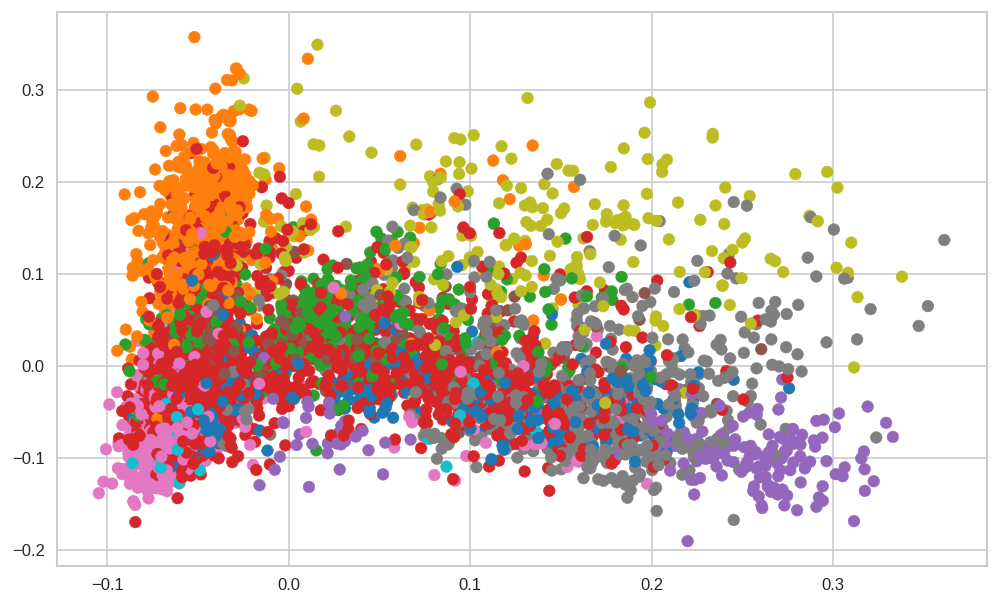

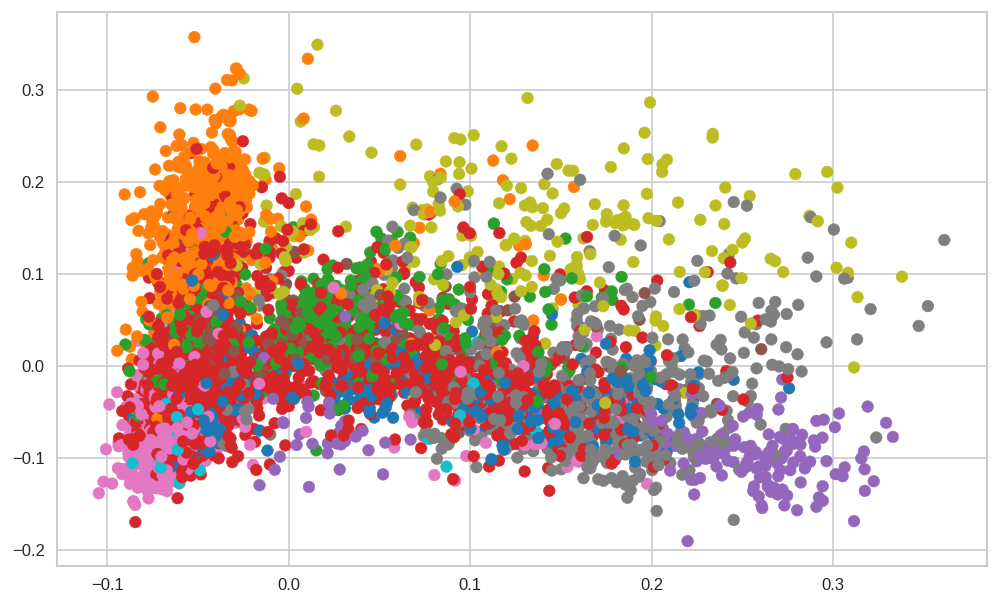

In [ ]:
from sklearn.cluster import AgglomerativeClustering
model = AgglomerativeClustering(n_clusters = 10, affinity = 'euclidean', linkage = 'ward')
labels = model.fit_predict(X_transformed)
# Create a scatter plot with different colors for different clusters
plt.figure(figsize=(10,6), dpi=120)
plt.scatter(X_transformed[:, 0], X_transformed[:, 1], c=labels, cmap='tab10')
plt.legend()
plt.show()

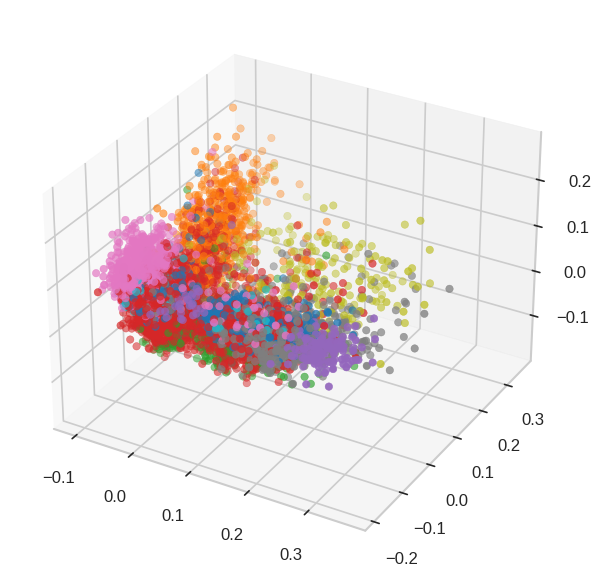

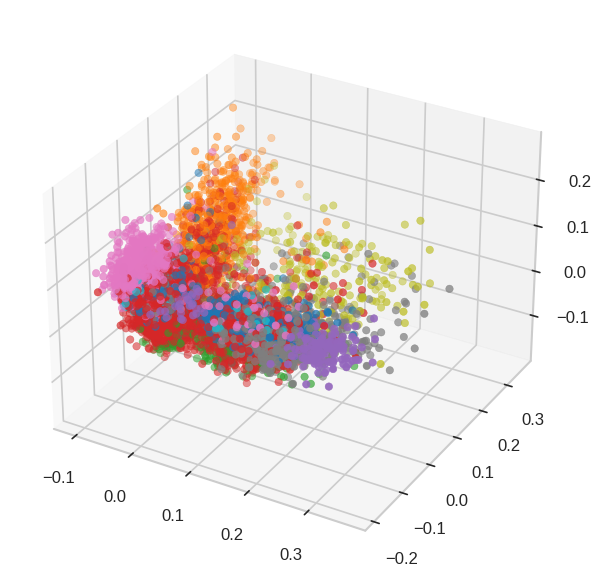

In [ ]:
#  plot in 3D

from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 6), dpi=120)
ax = fig.add_subplot(111, projection='3d')

ax.scatter(X_transformed[:, 0], X_transformed[:, 1], X_transformed[:, 2], c=labels, cmap='tab10')
ax.legend()
plt.show()

In [ ]:
df1['cluster_number_agg_clustering'] = model.labels_

We have created a new column called "cluster_number_agg_clustering," which indicates which observations are assigned to which cluster.

In [ ]:

#word cloud for user rating review
def func_select_Category_agg_clustering(cluster_label,column_of_choice):
  df_word_cloud = df1[['cluster_number_agg_clustering',column_of_choice]].dropna()
  df_word_cloud = df_word_cloud[df_word_cloud['cluster_number_agg_clustering']==cluster_label]
  text = " ".join(word for word in df_word_cloud[column_of_choice])
  # Create stopword list:
  stopwords = set(STOPWORDS)
  # Generate a word cloud image
  wordcloud = WordCloud(stopwords=stopwords, background_color="black").generate(text)
  # Plot the wordclouds
  plt.imshow(wordcloud, interpolation='blackman')
  plt.title(f'Cluster: {i}', fontsize=18, fontweight='bold')
  plt.axis("off")
  plt.show()

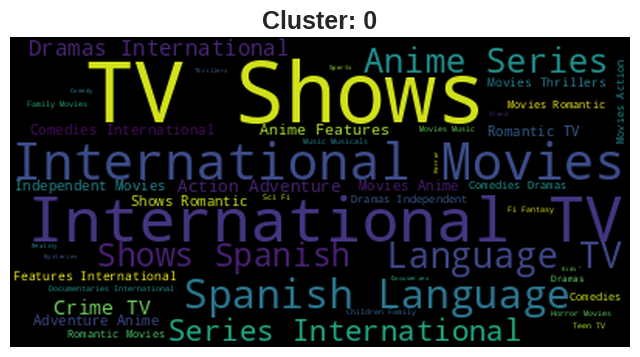

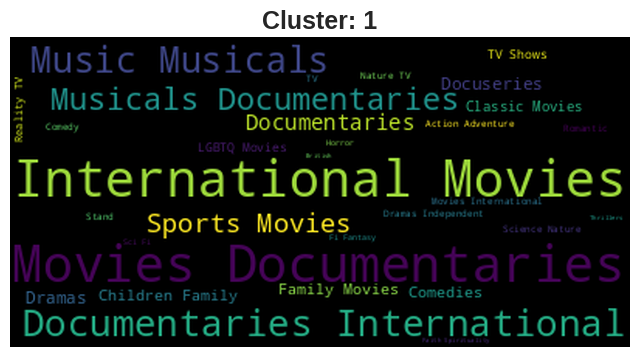

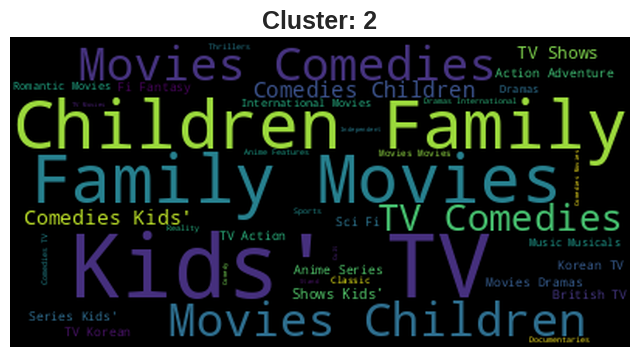

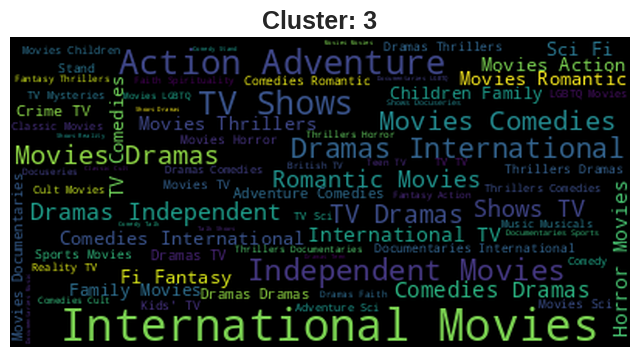

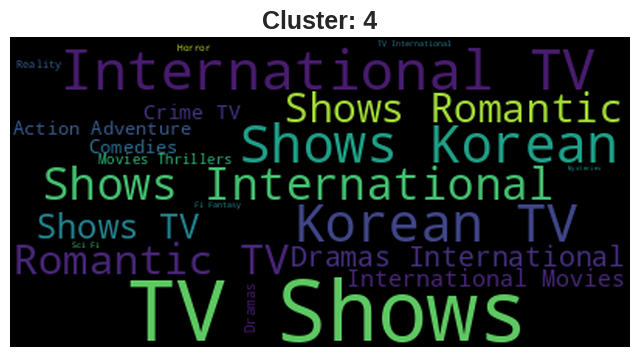

...

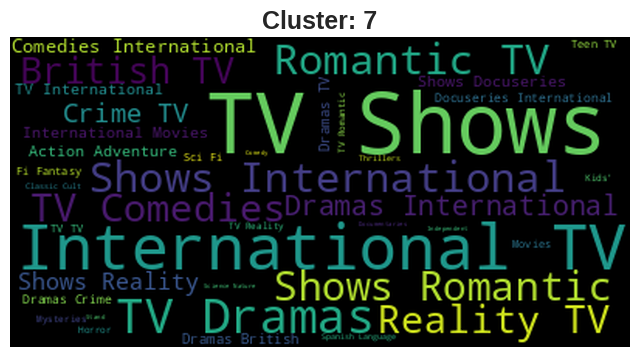

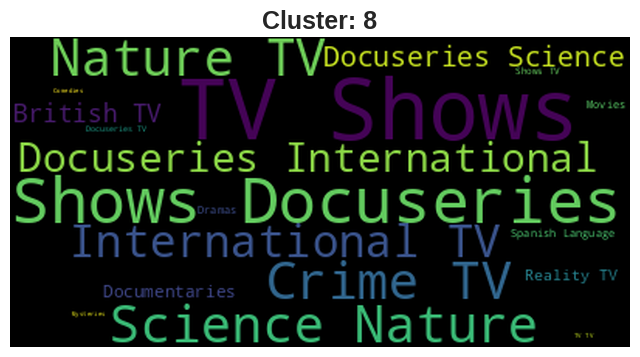

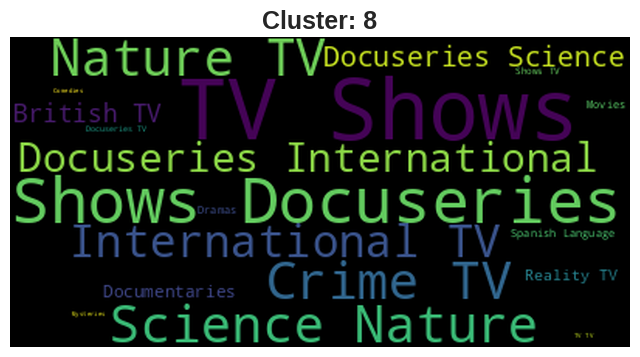

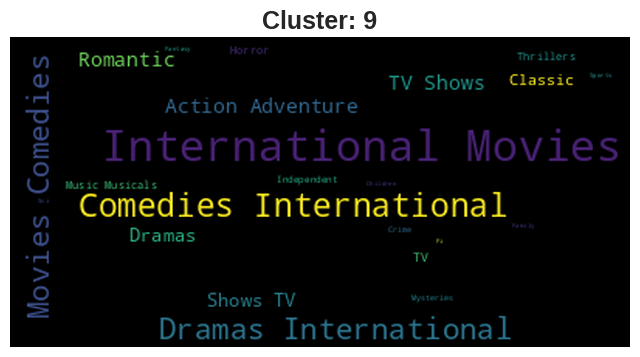

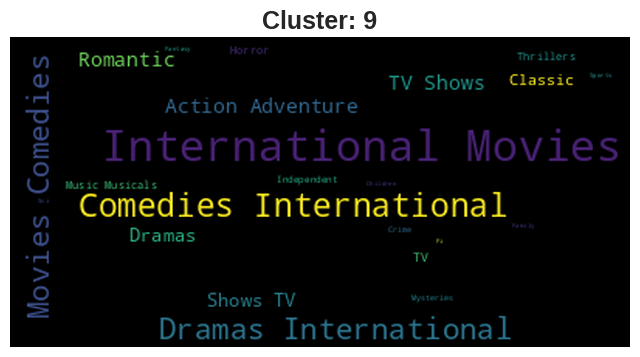

In [ ]:

for i in range(10):
  func_select_Category_agg_clustering(i,'listed_in')

Here again we have created thw word plot for our listed_in variable to check the distribution of words in different clusters. And we can see that

- Cluster 0 contains maximum no. of documentaries, musical, sports.
- Cluster 1 contains maximum no. of Independent, International, Horror movies.
- Cluster 2 contains max no of TV shows
- Cluster 3 conatins max no. of family, kids movies.
- Cluster 4 contains max no. of Korean, Crime thriller movies.
- Cluster 5 contains max no. of Standup comedy shows.
- Cluster 6 contains max no. of nature and science.]
- Cluster 7 contains max no. of Drama, Comedy and International movies.
- Cluster 8 contains max no. of Anime movies and anime series.
- Cluster 9 contains max no.of action, comedies, dramas and international movies.



---



#### 1. Explain the ML Model used and it's performance using Evaluation metric Score Chart.

In [ ]:
# Visualizing evaluation Metric Score chart

#### 2. Cross- Validation & Hyperparameter Tuning

In [ ]:
# ML Model - 3 Implementation with hyperparameter optimization techniques (i.e., GridSearch CV, RandomSearch CV, Bayesian Optimization etc.)

# Fit the Algorithm

# Predict on the model

##### Which hyperparameter optimization technique have you used and why?

Answer Here.

##### Have you seen any improvement? Note down the improvement with updates Evaluation metric Score Chart.

Answer Here.



---



# Movie Recommender System


The provided code implements a movie recommender system using KMeans clustering and the cosine similarity metric. Here's how it works:

1. **Data Preprocessing**:
   - The code assumes you have a dataset containing movie information and user ratings/genre.
   - It selects features relevant for clustering, such as `genres(listed_in)`, `keywords`, `description`, and `title`.
   - These features are combined into a single string representation for each movie.

2. **Vectorization**:
   - The `TfidfVectorizer` is used to convert the textual features into a numerical representation.
   - This representation captures the importance of different words in each movie's description.

3. **Dimensionality Reduction**:
   - The `PCA` is used to reduce the dimensionality of the data.
   - This helps to improve computational efficiency and reduce noise in the data.

4. **Clustering**:
   - The `KMeans` algorithm is used to cluster the movies based on their feature similarities.
   - The optimal number of clusters is determined using the elbow method.

5. **Recommendation**:
   - For a given movie, the recommender system finds the cluster it belongs to.
   - It then recommends other movies from the same cluster, as these movies are likely to be similar in terms of content and genre.

**Explanation**:

- This approach leverages the power of unsupervised learning (KMeans clustering) to group movies based on their similarities.
- By using cosine similarity, the recommender system can accurately capture the relationships between different movies based on their features.
- The system can recommend movies that are relevant to the user's preferences, as it takes into account the user's current movie selection.

**Additional Notes**:

- The code snippet provides a basic implementation of a movie recommender system.
- You can further customize and improve the system by incorporating additional features, using different clustering algorithms, or implementing more sophisticated recommendation strategies.

In [ ]:
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
#removing stopwords
tfidf = TfidfVectorizer(stop_words='english')

In [ ]:
#get the tf-idf scores
#create TF-IDF matrix by fitting and transforming the data
tfidf_matrix = tfidf.fit_transform(df1['org_new'])

#shape of tfidf_matrix
tfidf_matrix.shape

(7770, 41974)

(7770, 41974)

We'll use cosine similarity over tf-idf because-:

- Cosine similarity handles high dimensional sparse data better.

- Cosine similarity captures the meaning of the text better than tf-idf. For example, if two items contain similar words but in different orders, cosine similarity would still consider them similar, while tf-idf may not. This is because tf-idf only considers the frequency of words in a document and not their order or meaning.



# Using Cosine Similarity

- Cosine similarity is a measure of similarity between two non-zero vectors in a multidimensional space. It measures the cosine of the angle between the two vectors, which ranges from -1 (opposite direction) to 1 (same direction), with 0 indicating orthogonality (the vectors are perpendicular to each other).


- In this project we have used cosine similarity which is used to determine how similar two documents or pieces of text are. We represent the documents as vectors in a high-dimensional space, where each dimension represents a word or term in the corpus. We can then calculate the cosine similarity between the vectors to determine how similar the documents are based on their word usage.

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
cosine_sim = cosine_similarity(tfidf_matrix)

In [ ]:
programme_list=new_df['title'].to_list()

In [ ]:
def recommend(title, cosine_similarity=cosine_sim):
    index = programme_list.index(title)         #finds the index of the input title in the programme_list.
    sim_score = list(enumerate(cosine_sim[index])) #creates a list of tuples containing the similarity score and index between the input title and all other programmes in the dataset.

    #position 0 is the movie itself, thus exclude
    sim_score = sorted(sim_score, key= lambda x: x[1], reverse=True)[1:11]  #sorts the list of tuples by similarity score in descending order.
    recommend_index = [i[0] for i in sim_score]
    rec_movie = new_df['title'].iloc[recommend_index]
    rec_score = [round(i[1],4) for i in sim_score]
    rec_table = pd.DataFrame(list(zip(rec_movie,rec_score)), columns=['Recommended movie','Similarity(0-1)'])
    return rec_table

This function calculates the cosine similarity scores between the input title and all other titles in the dataset, sorts them in descending order, and returns the top 10 movies with the highest similarity scores as recommendations.

In [ ]:
recommend("Indiana Jones and the Last Crusade")

,Recommended movie,Similarity(0-1)
0,Indiana Jones and the Raiders of the Lost Ark,0.3144
1,Indiana Jones and the Kingdom of the Crystal S...,0.1996
2,Indiana Jones and the Temple of Doom,0.1939
3,Monty Python and the Holy Grail,0.1289
4,Lincoln,0.1272
5,A Bridge Too Far,0.1219
6,The Battle of Midway,0.1103
7,Pawn Stars,0.1082
8,The Adventures of Tintin,0.1081
9,Patriot Games,0.1021


,Recommended movie,Similarity(0-1)
0,Indiana Jones and the Raiders of the Lost Ark,0.3144
1,Indiana Jones and the Kingdom of the Crystal S...,0.1996
2,Indiana Jones and the Temple of Doom,0.1939
3,Monty Python and the Holy Grail,0.1289
4,Lincoln,0.1272
5,A Bridge Too Far,0.1219
6,The Battle of Midway,0.1103
7,Pawn Stars,0.1082
8,The Adventures of Tintin,0.1081
9,Patriot Games,0.1021


In [ ]:
recommend('Betaal')

,Recommended movie,Similarity(0-1)
0,Poshter Girl,0.1281
1,Agent Raghav,0.1198
2,Anjaan: Rural Myths,0.1071
3,Bard of Blood,0.1007
4,Gunjan Saxena: The Kargil Girl,0.0915
5,Fear Files... Har Mod Pe Darr,0.0893
6,Manusangada,0.0888
7,Back with the Ex,0.0871
8,Sacred Games,0.0857
9,Battlefield Recovery,0.0845


,Recommended movie,Similarity(0-1)
0,Poshter Girl,0.1281
1,Agent Raghav,0.1198
2,Anjaan: Rural Myths,0.1071
3,Bard of Blood,0.1007
4,Gunjan Saxena: The Kargil Girl,0.0915
5,Fear Files... Har Mod Pe Darr,0.0893
6,Manusangada,0.0888
7,Back with the Ex,0.0871
8,Sacred Games,0.0857
9,Battlefield Recovery,0.0845


In [ ]:

recommend('Zindagi Na Milegi Dobara')

,Recommended movie,Similarity(0-1)
0,Luck by Chance,0.2684
1,Dil Dhadakne Do,0.2191
2,Lakshya,0.1780
3,Zero,0.1578
4,Bombay Talkies,0.1572
5,Don 2,0.1532
6,Dev.D,0.1525
7,Ghost Stories,0.1465
8,Shanghai,0.1449
9,Waiting,0.1438


,Recommended movie,Similarity(0-1)
0,Luck by Chance,0.2684
1,Dil Dhadakne Do,0.2191
2,Lakshya,0.1780
3,Zero,0.1578
4,Bombay Talkies,0.1572
5,Don 2,0.1532
6,Dev.D,0.1525
7,Ghost Stories,0.1465
8,Shanghai,0.1449
9,Waiting,0.1438


In [ ]:

recommend('Iron Man: Armored Adventures')

,Recommended movie,Similarity(0-1)
0,LoliRock,0.1272
1,LEGO Jurassic World: Secret Exhibit,0.1257
2,NOVA: Secrets of the Shining Knight,0.1190
3,Strawberry Shortcake: Berry Bitty Adventures,0.1168
4,Little Baby Bum: Nursery Rhyme Friends,0.1092
5,Marvel's Iron Man & Hulk: Heroes United,0.1092
6,Kong: King of the Apes,0.1048
7,The Hollow,0.1009
8,The Umbrella Academy,0.1006
9,Learning Songs by Little Baby Bum: Nursery Rhy...,0.1003


,Recommended movie,Similarity(0-1)
0,LoliRock,0.1272
1,LEGO Jurassic World: Secret Exhibit,0.1257
2,NOVA: Secrets of the Shining Knight,0.1190
3,Strawberry Shortcake: Berry Bitty Adventures,0.1168
4,Little Baby Bum: Nursery Rhyme Friends,0.1092
5,Marvel's Iron Man & Hulk: Heroes United,0.1092
6,Kong: King of the Apes,0.1048
7,The Hollow,0.1009
8,The Umbrella Academy,0.1006
9,Learning Songs by Little Baby Bum: Nursery Rhy...,0.1003


In [ ]:
recommend('Shootout at Lokhandwala')

,Recommended movie,Similarity(0-1)
0,Mission Istaanbul: Darr Ke Aagey Jeet Hai,0.2818
1,Kyun! Ho Gaya Na,0.2312
2,Kabhi Alvida Naa Kehna,0.1627
3,Hello Brother,0.1618
4,Kisaan,0.1578
5,Lagaan,0.1534
6,Action Replayy,0.1504
7,Dum,0.1464
8,Mumbai Cha Raja,0.1459
9,Golmaal Returns,0.1409


,Recommended movie,Similarity(0-1)
0,Mission Istaanbul: Darr Ke Aagey Jeet Hai,0.2818
1,Kyun! Ho Gaya Na,0.2312
2,Kabhi Alvida Naa Kehna,0.1627
3,Hello Brother,0.1618
4,Kisaan,0.1578
5,Lagaan,0.1534
6,Action Replayy,0.1504
7,Dum,0.1464
8,Mumbai Cha Raja,0.1459
9,Golmaal Returns,0.1409



---

### 1. Which Evaluation metrics did you consider for a positive business impact and why?

Answer Here.

### 2. Which ML model did you choose from the above created models as your final prediction model and why?

Answer Here.

### 3. Explain the model which you have used and the feature importance using any model explainability tool?

Answer Here.

## ***8.*** ***Future Work (Optional)***

### 1. Save the best performing ml model in a pickle file or joblib file format for deployment process.


In [ ]:
# Save the File

In [ ]:
# save the function as a pickle file

import pickle
with open('recommend.pkl', 'wb') as f:
    pickle.dump(recommend, f)

In [ ]:
import pickle
with open('tfidf.pkl', 'wb') as f:
    pickle.dump(tfidf, f)

In [ ]:

with open('tfidf_matrix.pkl', 'wb') as f:
    pickle.dump(tfidf_matrix, f)

### 2. Again Load the saved model file and try to predict unseen data for a sanity check.


In [ ]:
# Load the File and predict unseen data.

### ***Congrats! Your model is successfully created and ready for deployment on a live server for a real user interaction !!!***

# **Conclusion**

Write the conclusion here.


1. The purpose of the project was to explore how different movie and TV shows on Netflix can be grouped together based on their features, such as genre, director, and rating.

2. For this we started with data wrangling, handling null values, exploratory data analysis. Some of the key insights from our exploratory data analysis are-:

- There are more obervations of Movies than TV shows in our dataset.
- But in the recent years Netflix has been focusing more on Tv-Shows.
- The majority of the rated content on Netflix falls into the TV-MA(indicating that mature content is more popular on Netflix.) and TV-14 categories.
- Number of TV shows and movies on Netflix has increased significantly since 2010.
- Documentaries, Stand-up Comedy, Drama, International movies and comedies are some of the highly popular content on the platform. the reason being people use ott platforms as the source of entertainment and they often love the content that is more relatable to their life and feel real.
- USA and India are topmost countries in producing content over the platform.
- Between 2017-2019, the maximum content is released or added to the platform.
- Maximum number of content is released in the month of December and january.
- Netflix has over 30% original content which shows that netflix invests heavily in creating and promoting their own original content.
- US and UK are closely aligned with their Netflix target ages, means that people in both USA and UK prefer to watch similar type of content.

3. Then we applied textual data preprocessing which involves several steps like-:
- Merging all important columns into one single column.
- Lower Casing
- Removing Punctuations
- Removing Stopwords
- Text Normalization (Stemming and Lematization)
- Text Vectorization (we used tfidf)
4. As there were many features after tfidf vectorisation, we applied dimensionality reduction technique, PCA where we were able to capture 95% of variance in 5000 components.

5. Then in clustering part, we used several clustering techniques, including silhouette score,elbow visualiser, k-means clustering, dendrogram, and agglomerative clustering.

After analyzing the results of our clustering analysis, we determined that 10 clusters was the optimal number of clusters

6. We also created different word plots to visualise the distribution of genres and words over different clusters.

7. Finally we created recommender system using cosine similarity on our tfidf matrix.

8. Then, we checked the working of our recommender system by passing different movie names to it, and it performed well on them.

# Future Scope

- Incorporating external datasets, such as IMDB ratings and Rotten Tomatoes, with this dataset can yield numerous intriguing discoveries.

- More time could be given on clustering analysis to try out different clustering algorithms like DBSCAN.

- More time could be given in improving the recommender system and building a working app on this recommender system.



---



### ***Hurrah! You have successfully completed your Machine Learning Capstone Project !!!***